<a href="https://colab.research.google.com/github/xszbencex/SZFM_2021_10_GitGud_Big/blob/main/covid_forecast.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

---
### **COVID19 prediction and forecasting using machine learning**
---

 > ### *Import all needed packages/libraries*

In [ ]:
import pandas as pd #adatok manipulalasa, ellemzese, modellezese, regressziok
import matplotlib.pyplot as plt #plotok abrazolasa
import seaborn as sns #statisztikai ellemzes, abbol ggrafikon letrehozasa
import numpy as np #array kezelése
import datetime as dt #dátum/idő kezelése

from datetime import timedelta #két dátum/idő közötti különbség
from sklearn.linear_model import LinearRegression #model illesztése, minimalizálja az adathalmaz által meghatározott érték, és előre jelzett érték közötti különbséget
from sklearn.svm import SVR #osztályozás, regresszió, kiugró értékek kezelése
from statsmodels.tsa.api import Holt #statisztikai modell, megkapjuk hogyan is változnak az adataink

> ### *Import dataset*

In [ ]:
url = 'https://raw.githubusercontent.com/xszbencex/SZFM_2021_10_GitGud_Big/main/Dataset/covid_19_data.csv' #github-on van eltárolva az adathalmazunk
covid = pd.read_csv(url)

In [ ]:
covid.tail(20) #utolso 20 sor kiirasa

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered
18307,18308,04/24/2020,Tasmania,Australia,2020-04-25 06:31:19,207,9,67
18308,18309,04/24/2020,Tennessee,US,2020-04-25 06:31:19,8728,169,0
18309,18310,04/24/2020,Texas,US,2020-04-25 06:31:19,23642,624,0
18310,18311,04/24/2020,Tianjin,Mainland China,2020-04-25 06:31:19,190,3,181
18311,18312,04/24/2020,Tibet,Mainland China,2020-04-25 06:31:19,1,0,1
18312,18313,04/24/2020,Turks and Caicos Islands,UK,2020-04-25 06:31:19,11,1,4
18313,18314,04/24/2020,Utah,US,2020-04-25 06:31:19,3782,39,0
18314,18315,04/24/2020,Vermont,US,2020-04-25 06:31:19,827,44,0
18315,18316,04/24/2020,Victoria,Australia,2020-04-25 06:31:19,1343,16,1172
18316,18317,04/24/2020,Virgin Islands,US,2020-04-25 06:31:19,54,3,0


In [ ]:
covid.head(20) #elso 20 sor kiirasa

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered
0,1,01/22/2020,Anhui,Mainland China,1/22/2020 17:00,1,0,0
1,2,01/22/2020,Beijing,Mainland China,1/22/2020 17:00,14,0,0
2,3,01/22/2020,Chongqing,Mainland China,1/22/2020 17:00,6,0,0
3,4,01/22/2020,Fujian,Mainland China,1/22/2020 17:00,1,0,0
4,5,01/22/2020,Gansu,Mainland China,1/22/2020 17:00,0,0,0
5,6,01/22/2020,Guangdong,Mainland China,1/22/2020 17:00,26,0,0
6,7,01/22/2020,Guangxi,Mainland China,1/22/2020 17:00,2,0,0
7,8,01/22/2020,Guizhou,Mainland China,1/22/2020 17:00,1,0,0
8,9,01/22/2020,Hainan,Mainland China,1/22/2020 17:00,4,0,0
9,10,01/22/2020,Hebei,Mainland China,1/22/2020 17:00,1,0,0


In [ ]:
print("Size/Shape of the dataset",covid.shape) #shape()- visszaadja hány sort/oszlopot tart. az adatbázisunk
print("Checking for null values",covid.isnull().sum()) #isnull().sum() - megadja oszloponkent hany 0 ertek talalhato az adatbazisban
print("Checking Data-type",covid.dtypes) #dtypes() - oszloponként adatok típusa

Size/Shape of the dataset (18327, 8)
Checking for null values SNo                   0
ObservationDate       0
Province/State     9277
Country/Region        0
Last Update           0
Confirmed             0
Deaths                0
Recovered             0
dtype: int64
Checking Data-type SNo                  int64
ObservationDate     object
Province/State      object
Country/Region      object
Last Update         object
Confirmed          float64
Deaths             float64
Recovered          float64
dtype: object


In [ ]:
covid.drop(["SNo"],1,inplace=True) #kitoroljuk sz SNo oszlopot

In [ ]:
covid.isnull().sum()

ObservationDate       0
Province/State     9277
Country/Region        0
Last Update           0
Confirmed             0
Deaths                0
Recovered             0
dtype: int64

In [ ]:
covid["ObservationDate"] = pd.to_datetime(covid["ObservationDate"]) #object tipust atalakitja datumma



> ### *Grouping different types of cases*

### *ObservationDate*



In [ ]:
datewise = covid.groupby(["ObservationDate"]).agg({"Confirmed":"sum","Recovered":"sum","Deaths":"sum"})

#groupby() – megadjuk melyik oszlop alapján csinálja csoportosítás

#agg() – megadott értékeket egy függvény segítségével összesíti. ebben az esetben
#	      pl. Halálok száma – sum


In [ ]:
print("Basic Information")
print("Total number of Confirmed cases around the world",datewise["Confirmed"].iloc[-1])
print("Total number of Recovered cases around the world",datewise["Recovered"].iloc[-1])
print("Total number of Death cases around the world",datewise["Deaths"].iloc[-1])
print("Total number of Active cases around the world",(datewise["Confirmed"].iloc[-1]-datewise["Recovered"].iloc[-1]-datewise["Deaths"].iloc[-1]))
print("Total number of Closed cases around the world",(datewise["Recovered"].iloc[-1]+datewise["Deaths"].iloc[-1]))

Basic Information
Total number of Confirmed cases around the world 2811193.0
Total number of Recovered cases around the world 793601.0
Total number of Death cases around the world 197159.0
Total number of Active cases around the world 1820433.0
Total number of Closed cases around the world 990760.0


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
        85, 86, 87, 88, 89, 90, 91, 92, 93]),
 <a list of 94 Text major ticklabel objects>)

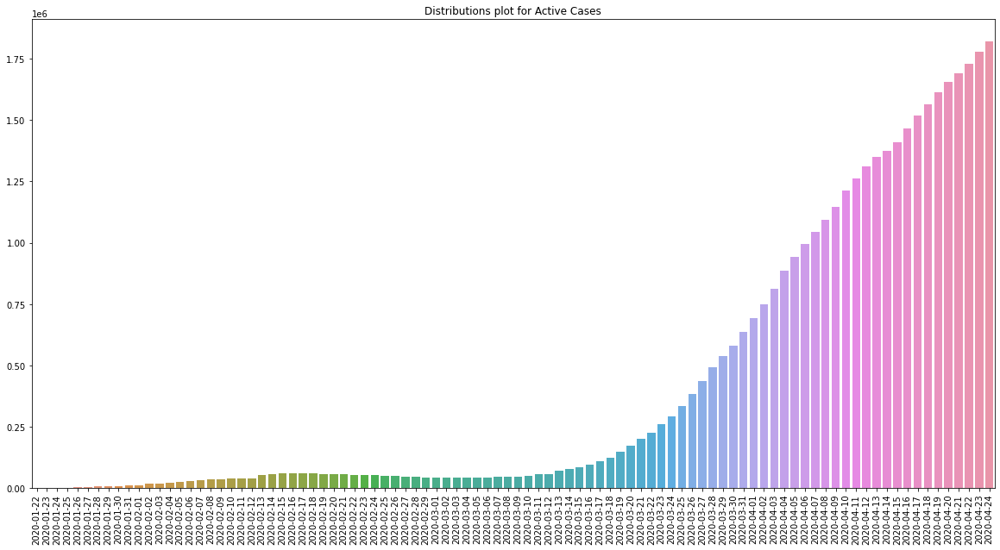

In [ ]:
plt.figure(figsize=(20,10))
sns.barplot(x=datewise.index.date,y=datewise["Confirmed"]-datewise["Recovered"]-datewise["Deaths"])
plt.title("Distributions plot for Active Cases")
plt.xticks(rotation=90)

#lt.figure(figsize=(20,10)) – létrehoz egy figura objektumot. zárójelben figsize() segítségével adjuk meg méreteit. 

#sns.barplot() – becsléseket ad meg egy sávdiagram segítségével. x tengelynek megadjunk a dátumainkat, y pedig betegek/nem betegek számát

#plt.title() – a diagramunk címét adhatjuk meg

#plt.xticks() – x tengely mentén lévő szöveg forgatása 90 fokkal


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
        85, 86, 87, 88, 89, 90, 91, 92, 93]),
 <a list of 94 Text major ticklabel objects>)

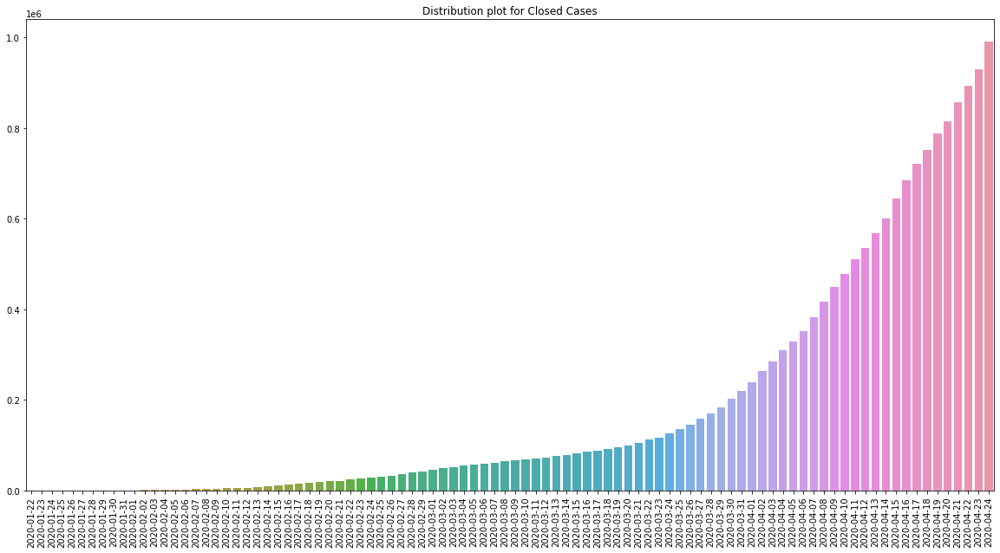

In [ ]:
plt.figure(figsize=(20,10))
sns.barplot(x=datewise.index.date,y=datewise["Recovered"]+datewise["Deaths"])
plt.title("Distribution plot for Closed Cases")
plt.xticks(rotation=90)

 > ### *Segregating weekly rises*




/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: weekofyear and week have been deprecated, please use DatetimeIndex.isocalendar().week instead, which returns a Series.  To exactly reproduce the behavior of week and weekofyear and return an Index, you may call pd.Int64Index(idx.isocalendar().week)
  """Entry point for launching an IPython kernel.


Text(0.5, 1.0, 'Weekly Progress of different types of cases')

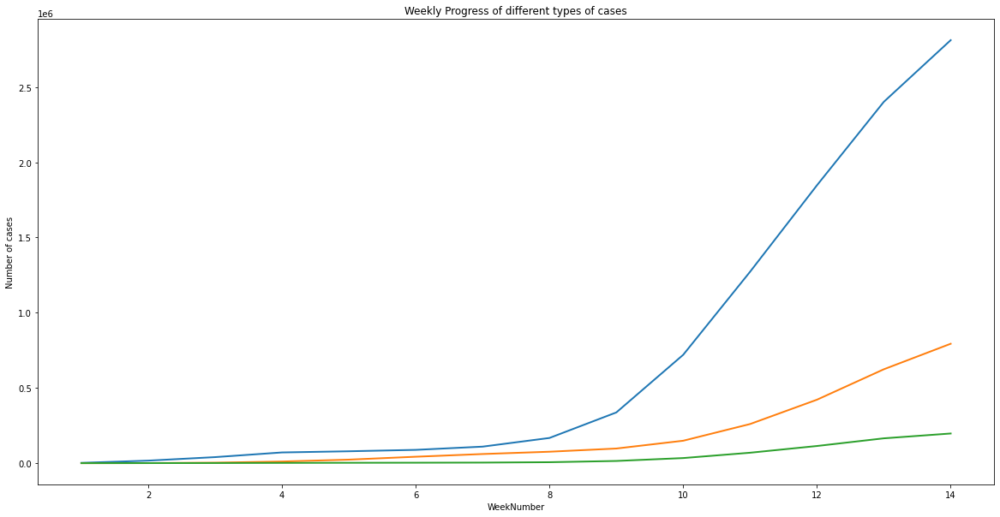

In [ ]:
datewise["WeekofYear"] = datewise.index.weekofyear
week_num = [] #weekly progress
weekwise_confirmed = [] #weekly progress for different types of cases 
weekwise_recovered = []
weekwise_deaths = []
w = 1
for i in list(datewise["WeekofYear"].unique()):
    weekwise_confirmed.append(datewise[datewise["WeekofYear"]==i]["Confirmed"].iloc[-1])
    weekwise_recovered.append(datewise[datewise["WeekofYear"]==i]["Recovered"].iloc[-1])
    weekwise_deaths.append(datewise[datewise["WeekofYear"]==i]["Deaths"].iloc[-1])
    week_num.append(w)
    w=w+1
plt.figure(figsize=(20,10))
plt.plot(week_num,weekwise_confirmed,linewidth=2)
plt.plot(week_num,weekwise_recovered,linewidth =2)
plt.plot(week_num,weekwise_deaths,linewidth = 2)
plt.xlabel("WeekNumber")
plt.ylabel("Number of cases")
plt.title("Weekly Progress of different types of cases")

> ### *Segregating most number of Confirmed and Death Cases increases in a week*



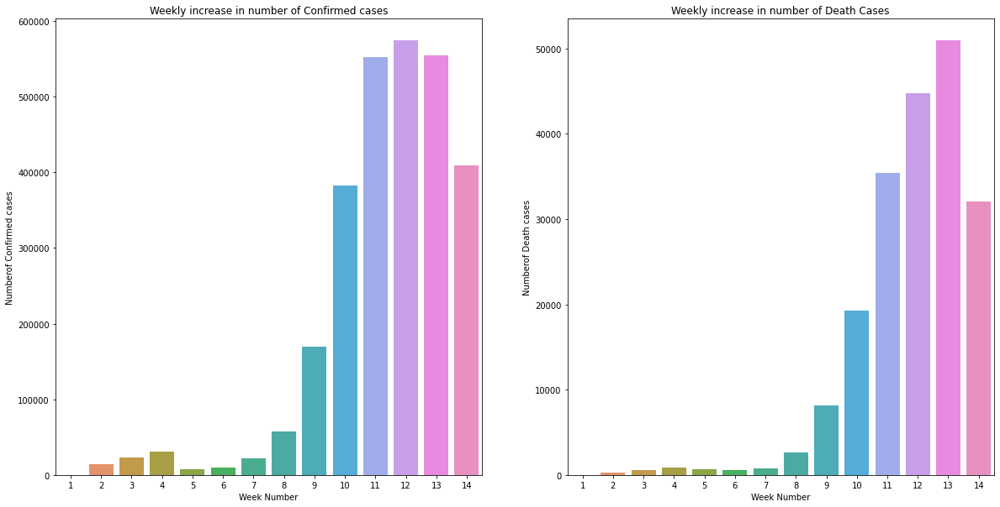

In [ ]:
fig,(ax1,ax2) = plt.subplots(1,2,figsize=(20,10))
sns.barplot(x= week_num,y=pd.Series(weekwise_confirmed).diff().fillna(0),ax=ax1)
sns.barplot(x= week_num,y=pd.Series(weekwise_deaths).diff().fillna(0),ax=ax2)
ax1.set_xlabel("Week Number")
ax2.set_xlabel("Week Number")
ax1.set_ylabel("Numberof Confirmed cases")
ax2.set_ylabel("Numberof Death cases")
ax1.set_title("Weekly increase in number of Confirmed cases")
ax2.set_title("Weekly increase in number of Death Cases")
plt.show()



> ### *Segregating Average increasing number of cases*



Average increase in number of Confirmed cases everyday: 29900.0
Average increase in number of Recovered cases everyday: 8442.0
Average increase in number of Death cases everyday: 2097.0


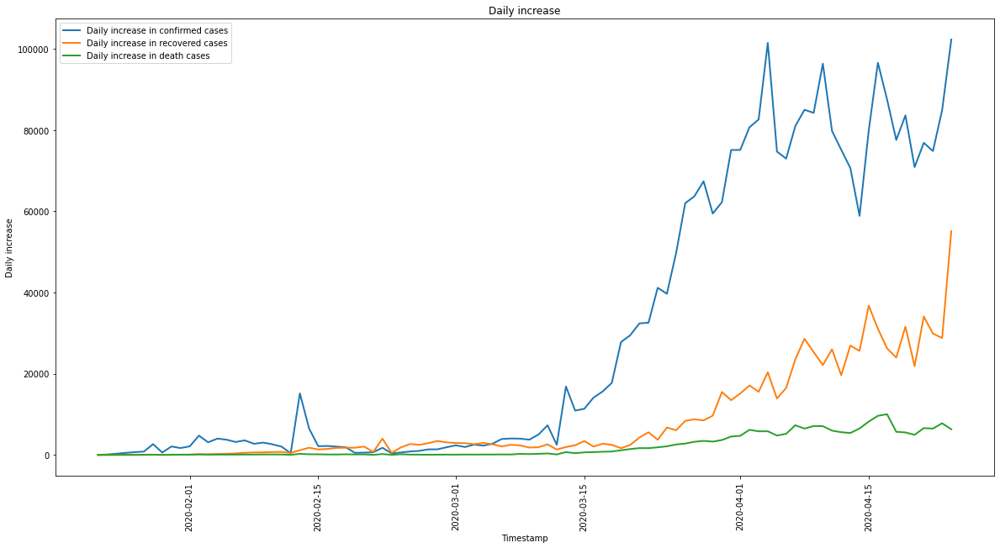

In [ ]:
print("Average increase in number of Confirmed cases everyday:",np.round(datewise["Confirmed"].diff().fillna(0).mean()))
print("Average increase in number of Recovered cases everyday:",np.round(datewise["Recovered"].diff().fillna(0).mean()))
print("Average increase in number of Death cases everyday:",np.round(datewise["Deaths"].diff().fillna(0).mean()))

plt.figure(figsize=(20,10))
plt.plot(datewise["Confirmed"].diff().fillna(0),label="Daily increase in confirmed cases",linewidth=2)
plt.plot(datewise["Recovered"].diff().fillna(0),label="Daily increase in recovered cases",linewidth=2)
plt.plot(datewise["Deaths"].diff().fillna(0),label="Daily increase in death cases",linewidth=2)
plt.xlabel("Timestamp")
plt.ylabel("Daily increase")
plt.title("Daily increase")
plt.legend()
plt.xticks(rotation=90)
plt.show()

#np.round()-kerekítés
#np.diff() – kulonbseget számít egy adott tengely mentén
#np.fillna() – értékeink legyen különbözőek
#np.mean() – aritmetikai átlag egy adott tengely mentén




> ### *Calculating country wise mortality rate*



In [ ]:
countrywise= covid[covid["ObservationDate"]==covid["ObservationDate"].max()].groupby(["Country/Region"]).agg({"Confirmed":"sum","Recovered":"sum","Deaths":"sum"}).sort_values(["Confirmed"],ascending=False)
countrywise["Mortality"]=(countrywise["Deaths"]/countrywise["Recovered"])*100
countrywise["Recovered"]=(countrywise["Recovered"]/countrywise["Confirmed"])*100

Text(0.5, 1.0, 'Top 15 countries as per number of death cases')

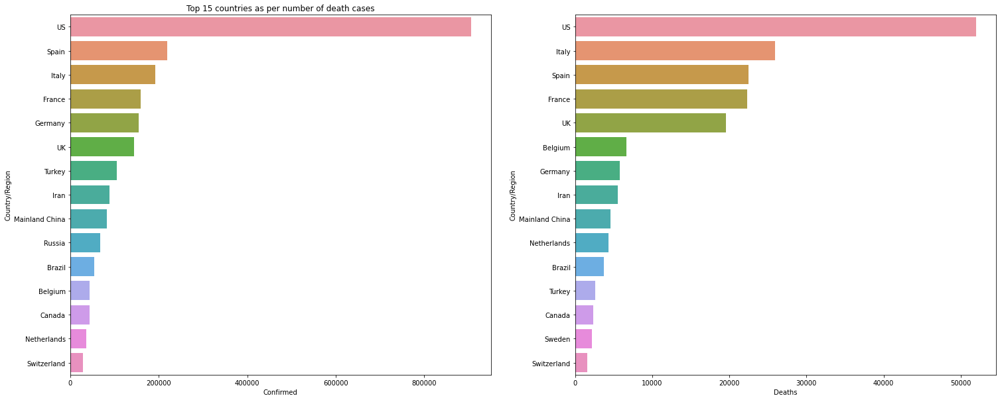

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(25,10))
top_15confirmed = countrywise.sort_values(["Confirmed"],ascending=False).head(15)
top_15deaths = countrywise.sort_values(["Deaths"],ascending=False).head(15)
sns.barplot(x=top_15confirmed["Confirmed"],y=top_15confirmed.index,ax=ax1)
ax1.set_title("Top 15 countries as per number of confirmed cases")
sns.barplot(x=top_15deaths["Deaths"],y=top_15deaths.index,ax=ax2)
ax1.set_title("Top 15 countries as per number of death cases")



> ### *Data analysis for India*



In [ ]:
india_data = covid[covid["Country/Region"]=="India"]
datewise_india = india_data.groupby(["ObservationDate"]).agg({"Confirmed":"sum","Recovered":"sum","Deaths":"sum"})
print(datewise_india.iloc[-1])
print("Total Active Cases",datewise_india["Confirmed"].iloc[-1]-datewise_india["Recovered"].iloc[-1]-datewise_india["Deaths"].iloc[-1])
print("Total Closed Cases",datewise_india["Recovered"].iloc[-1]+datewise_india["Deaths"].iloc[-1])

Confirmed   24530
Recovered    5498
Deaths        780
Name: 2020-04-24 00:00:00, dtype: float64
Total Active Cases 18252.0
Total Closed Cases 6278.0


> ### *Data analysis for US*



In [ ]:

us_data = covid[covid["Country/Region"]=="US"]
datewise_us = us_data.groupby(["ObservationDate"]).agg({"Confirmed":"sum","Recovered":"sum","Deaths":"sum"})
print(datewise_us.iloc[-1])
print("Total Active Cases",datewise_us["Confirmed"].iloc[-1]-datewise_us["Recovered"].iloc[-1]-datewise_us["Deaths"].iloc[-1])
print("Total Closed Cases",datewise_us["Recovered"].iloc[-1]+datewise_us["Deaths"].iloc[-1])

Confirmed   905333
Recovered    99079
Deaths       51949
Name: 2020-04-24 00:00:00, dtype: float64
Total Active Cases 754305.0
Total Closed Cases 151028.0


> ### *Segregating weekly rises for India*



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: weekofyear and week have been deprecated, please use DatetimeIndex.isocalendar().week instead, which returns a Series.  To exactly reproduce the behavior of week and weekofyear and return an Index, you may call pd.Int64Index(idx.isocalendar().week)
  """Entry point for launching an IPython kernel.


Text(0.5, 1.0, 'Weekly Progress of different types of cases')

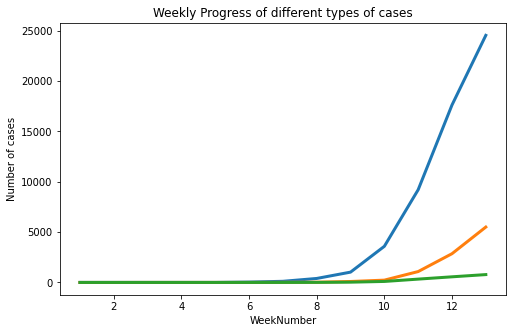

In [ ]:
datewise_india["WeekofYear"] = datewise_india.index.weekofyear
week_num_india = []
india_weekwise_confirmed = []
india_weekwise_recovered = []
india_weekwise_deaths = []
w = 1
for i in list(datewise_india["WeekofYear"].unique()):
    india_weekwise_confirmed.append(datewise_india[datewise_india["WeekofYear"]==i]["Confirmed"].iloc[-1])
    india_weekwise_recovered.append(datewise_india[datewise_india["WeekofYear"]==i]["Recovered"].iloc[-1])
    india_weekwise_deaths.append(datewise_india[datewise_india["WeekofYear"]==i]["Deaths"].iloc[-1])
    week_num_india.append(w)
    w=w+1
plt.figure(figsize=(8,5))
plt.plot(week_num_india,india_weekwise_confirmed,linewidth=3)
plt.plot(week_num_india,india_weekwise_recovered,linewidth =3)
plt.plot(week_num_india,india_weekwise_deaths,linewidth = 3)
plt.xlabel("WeekNumber")
plt.ylabel("Number of cases")
plt.title("Weekly Progress of different types of cases")



> ### *Segregating country wise analysis*



In [ ]:
china_data = covid[covid["Country/Region"]=="Mainland China"]
Italy_data = covid[covid["Country/Region"]=="Italy"]
US_data = covid[covid["Country/Region"]=="US"]
spain_data = covid[covid["Country/Region"]=="Spain"]

datewise_china = china_data.groupby(["ObservationDate"]).agg({"Confirmed":"sum","Recovered":"sum","Deaths":"sum"})
datewise_Italy = Italy_data.groupby(["ObservationDate"]).agg({"Confirmed":"sum","Recovered":"sum","Deaths":"sum"})
datewise_US=US_data.groupby(["ObservationDate"]).agg({"Confirmed":"sum","Recovered":"sum","Deaths":"sum"})
datewise_Spain=spain_data.groupby(["ObservationDate"]).agg({"Confirmed":"sum","Recovered":"sum","Deaths":"sum"})

max_ind = datewise_india["Confirmed"].max()
max_it = datewise_Italy["Confirmed"].max()
max_us = datewise_US["Confirmed"].max()
max_spain = datewise_Spain["Confirmed"].max()
max_china = datewise_china["Confirmed"].max()

print("It took",datewise_india[datewise_india["Confirmed"]>0].shape[0],"days in India to reach",max_ind,"Confirmed Cases")
print("It took",datewise_Italy[datewise_Italy["Confirmed"]>0].shape[0],"days in Italy to reach",max_it,"Confirmed Cases")
print("It took",datewise_US[datewise_US["Confirmed"]>0].shape[0],"days in US to reach",max_us,"Confirmed Cases")
print("It took",datewise_Spain[datewise_Spain["Confirmed"]>0].shape[0],"days in Spain to reach",max_spain,"Confirmed Cases")
print("It took",datewise_china[datewise_china["Confirmed"]>0].shape[0],"days in China to reach",max_china,"Confirmed Cases")


It took 86 days in India to reach 24530.0 Confirmed Cases
It took 85 days in Italy to reach 192994.0 Confirmed Cases
It took 94 days in US to reach 905333.0 Confirmed Cases
It took 84 days in Spain to reach 219764.0 Confirmed Cases
It took 94 days in China to reach 82819.0 Confirmed Cases




> ### *Creating a Model Training using the current Dataset*



In [ ]:
datewise["Days Since"]=datewise.index-datewise.index[0]
datewise["Days Since"] = datewise["Days Since"].dt.days
train_ml = datewise.iloc[:int(datewise.shape[0]*0.95)]
valid_ml = datewise.iloc[:int(datewise.shape[0]*0.95):]
model_scores=[]

In [ ]:
lin_reg = LinearRegression(normalize=True)
svm = SVR(C=1,degree=5,kernel='poly',epsilon=0.001)
lin_reg.fit(np.array(train_ml["Days Since"]).reshape(-1,1),np.array(train_ml["Confirmed"]).reshape(-1,1))
svm.fit(np.array(train_ml["Days Since"]).reshape(-1,1),np.array(train_ml["Confirmed"]).reshape(-1,1))

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


SVR(C=1, cache_size=200, coef0=0.0, degree=5, epsilon=0.001, gamma='scale',
    kernel='poly', max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [ ]:
prediction_valid_lin_reg = lin_reg.predict(np.array(valid_ml["Days Since"]).reshape(-1,1))
prediction_valid_svm = svm.predict(np.array(valid_ml["Days Since"]).reshape(-1,1))

In [ ]:
new_date = []
new_prediction_lr=[]
new_prediction_svm=[]
for i in range(1,18):
  new_date.append(datewise.index[-1]+timedelta(days=i))
  new_prediction_lr.append(lin_reg.predict(np.array(datewise["Days Since"].max()+i).reshape(-1,1))[0][0])
  new_prediction_svm.append(svm.predict(np.array(datewise["Days Since"].max()+i).reshape(-1,1))[0])
pd.set_option("display.float_format",lambda x: '%.f' % x)
model_predictions=pd.DataFrame(zip(new_date,new_prediction_lr,new_prediction_svm),columns = ["Dates","LR","SVR"])
model_predictions.head(5)

,Dates,LR,SVR
0,2020-04-25,1560529,3322586
1,2020-04-26,1582219,3500761
2,2020-04-27,1603909,3686599
3,2020-04-28,1625599,3880344
4,2020-04-29,1647289,4082245




> ### *Time series analysis to getting the exact data*



In [ ]:
model_train=datewise.iloc[:int(datewise.shape[0]*0.85)]
valid=datewise.iloc[int(datewise.shape[0]*0.85):]



> ### *Initializing the model which includes forecasting and prediction*



In [ ]:
holt=Holt(np.asarray(model_train["Confirmed"])).fit(smoothing_level=1.4,smoothing_slope=0.2)
y_pred = valid.copy()
y_pred["Holt"]=holt.forecast(len(valid))

In [ ]:
holt_new_date=[]
holt_new_prediction=[]
for i in range(1,18):
   holt_new_date.append(datewise.index[-1]+timedelta(days=i))
   holt_new_prediction.append(holt.forecast((len(valid)+i))[-1])

model_predictions["Holts Linear Model Prediction"]=holt_new_prediction
model_predictions.head()

,Dates,LR,SVR,Holts Linear Model Prediction
0,2020-04-25,1560529,3322586,2855246
1,2020-04-26,1582219,3500761,2933902
2,2020-04-27,1603909,3686599,3012558
3,2020-04-28,1625599,3880344,3091214
4,2020-04-29,1647289,4082245,3169870


> ###  ***Egy konkrét ország vizsgálata (Pakistan)***



In [ ]:
pip install pmdarima

In [ ]:
import numpy as np
import pandas as pd
import datetime
import plotly.express as px
import plotly.express as ex
import folium
import matplotlib.pyplot as plt

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima_model import ARIMA
from pmdarima import auto_arima    
from fbprophet import Prophet
from fbprophet.plot import plot_plotly, add_changepoints_to_plot

import plotly.graph_objects as go
import pandas as pd
import warnings
warnings.filterwarnings("ignore")

%matplotlib inline

In [ ]:
url = 'https://raw.githubusercontent.com/csengetoth/covid_forecast/main/pak_data-v2.csv'

In [ ]:
#covid_data = pd.read_excel('pak_data-v2.xlsx')
covid_data = pd.read_csv(url)

In [ ]:
covid_data.head()

,Date,Province,City,New Cases,Cured Cases,Death Cases
0,2020-02-26 00:00:00,Sindh,Karachi,1,0,0
1,2020-02-28 00:00:00,Islamabad,Islamabad,1,0,0
2,2020-03-01 00:00:00,Sindh,Karachi,1,0,0
3,2020-03-01 00:00:00,Islamabad,Islamabad,1,0,0
4,2020-03-03 00:00:00,Gilgit-Baltistan,Gilgit,1,0,0


In [ ]:
covid_data.isnull().sum()

Date           0
Province       0
City           0
New Cases      0
Cured Cases    0
Death Cases    0
dtype: int64

In [ ]:
covid_data.dtypes

Date           object
Province       object
City           object
New Cases       int64
Cured Cases     int64
Death Cases     int64
dtype: object

In [ ]:
#start date 
covid_data.Date.min()

'2020-02-26 00:00:00'

In [ ]:
#max date 
covid_data.Date.max()

'2020-04-29 00:00:00'

**PAKISTAN**

In [ ]:
pak_data = covid_data.copy()

In [ ]:

pak_data['Total Confirmed Cases'] = 0
pak_data['Total Recovered'] = 0
pak_data['Total Deaths'] = 0
pak_data['Active Cases'] = 0
for i in range(0, len(pak_data)):
    if (i == 0):
        pak_data['Total Confirmed Cases'].iloc[i] = pak_data['New Cases'].iloc[i]
        pak_data['Total Recovered'].iloc[i] = pak_data['Cured Cases'].iloc[i]
        pak_data['Total Deaths'].iloc[i] = pak_data['Death Cases'].iloc[i]
        pak_data['Active Cases'].iloc[i] = pak_data['Active Cases'].iloc[i-1] + pak_data['New Cases'].iloc[i] - pak_data['Death Cases'].iloc[i] - pak_data['Cured Cases'].iloc[i]

    else:
        pak_data['Total Confirmed Cases'].iloc[i] = pak_data['Total Confirmed Cases'].iloc[i-1] + pak_data['New Cases'].iloc[i]
        pak_data['Total Recovered'].iloc[i] =  pak_data['Total Recovered'].iloc[i-1] + pak_data['Cured Cases'].iloc[i]
        pak_data['Total Deaths'].iloc[i] =  pak_data['Total Deaths'].iloc[i-1] + pak_data['Death Cases'].iloc[i]
        pak_data['Active Cases'].iloc[i] = pak_data['Active Cases'].iloc[i-1] + pak_data['New Cases'].iloc[i] - pak_data['Death Cases'].iloc[i] - pak_data['Cured Cases'].iloc[i]

In [ ]:
pak_data.head()

,Date,Province,City,New Cases,Cured Cases,Death Cases,Total Confirmed Cases,Total Recovered,Total Deaths,Active Cases
0,2020-02-26 00:00:00,Sindh,Karachi,1,0,0,1,0,0,1
1,2020-02-28 00:00:00,Islamabad,Islamabad,1,0,0,2,0,0,2
2,2020-03-01 00:00:00,Sindh,Karachi,1,0,0,3,0,0,3
3,2020-03-01 00:00:00,Islamabad,Islamabad,1,0,0,4,0,0,4
4,2020-03-03 00:00:00,Gilgit-Baltistan,Gilgit,1,0,0,5,0,0,5


14278 2971 311 11618


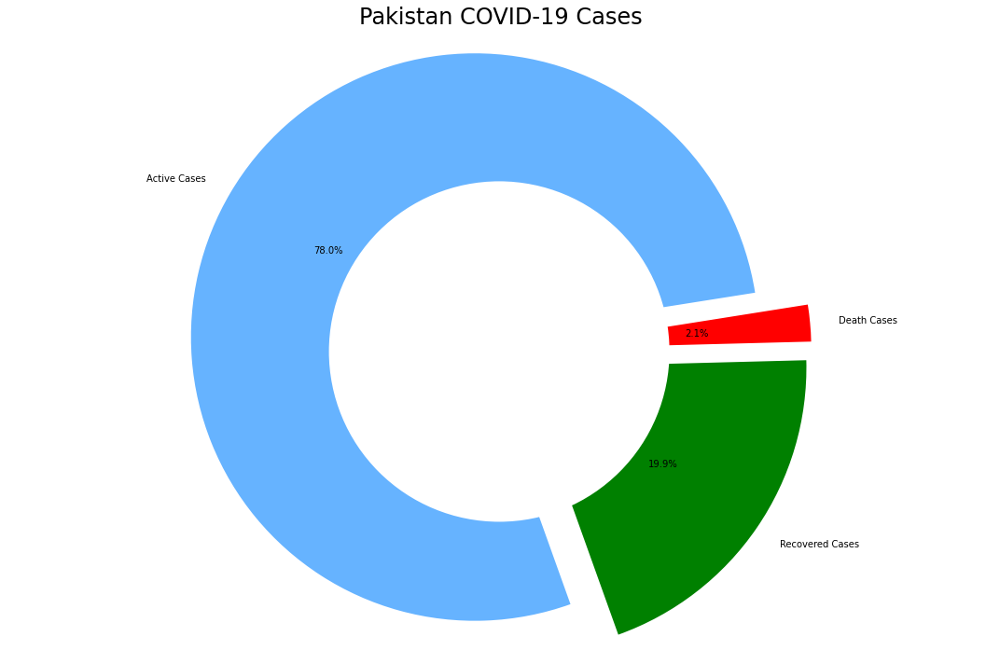

In [ ]:
confirmed = pak_data['New Cases'].sum()
recovered = pak_data['Cured Cases'].sum()
deaths = pak_data['Death Cases'].sum()
active = confirmed - (recovered - deaths)

print(confirmed, recovered, deaths, active)

labels = ['Active Cases','Recovered Cases','Death Cases']
sizes = [active,recovered,deaths]
color= ['#66b3ff','green','red']
explode = []

for i in labels:
    explode.append(0.1)
    
plt.figure(figsize= (15,10))
plt.pie(sizes, labels=labels, autopct='%3.1f%%', startangle=9, explode =explode,colors = color)
centre_circle = plt.Circle((0,0),0.60,fc='white')

fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.title('e',fontsize = 24)
plt.axis('equal')  
plt.tight_layout()

In [ ]:
temp = pak_data.groupby(['Date'])['New Cases','Cured Cases','Death Cases'].sum().reset_index()
fig = px.scatter(temp, x="Date", y="New Cases", color="New Cases",
                 size='New Cases', hover_data=['New Cases'],
                 color_discrete_sequence = ex.colors.cyclical.IceFire)
fig.update_layout(title_text='Trend of Daily Cases in Pakistan',
                  plot_bgcolor='rgb(275, 270, 273)',width=600, height=600)
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=pak_data['Date'], y=pak_data['Total Confirmed Cases'],
                    mode='lines+markers',marker_color='blue',name='Confimned Cases'))
#fig.add_trace(go.Scatter(x=train_df['Date'],y=train_df['Active'], 
#                mode='lines+markers',marker_color='purple',name='Active Cases'))
fig.add_trace(go.Scatter(x=pak_data['Date'], y=pak_data['Total Recovered'],
                mode='lines+markers',marker_color='green',name='Recovered'))
fig.add_trace(go.Scatter(x=pak_data['Date'], y=pak_data['Total Deaths'], 
                mode='lines+markers',marker_color='red',name='Deaths'))
fig.update_layout(title_text='Coronavirus Cases in Pakistan',plot_bgcolor='rgb(275, 270, 273)',width=600, height=600)
fig.show()

**Prophet Model**

In [ ]:
confirmed = pak_data['Total Confirmed Cases'].values.tolist()
data = pd.DataFrame(columns = ['ds','y'])
data['ds'] = list(pak_data['Date'])
data['y'] = confirmed

prop=Prophet()
prop.fit(data)
future=prop.make_future_dataframe(periods=15)
prop_forecast=prop.predict(future)
forecast = prop_forecast[['ds','yhat']].tail(15)
#print(forecast)


fig = go.Figure()
fig.add_trace(go.Scatter(x=pak_data['Date'], y=pak_data['Total Confirmed Cases'],
                    mode='lines+markers',marker_color='green',name='Actual'))
fig.add_trace(go.Scatter(x=prop_forecast['ds'], y=prop_forecast['yhat_upper'],
                    mode='lines+markers',marker_color='Orange',name='Predicted'))
fig.update_layout(title_text = 'Confirmed Cases (Predicted vs Actual) using Prophet')
fig.update_layout(plot_bgcolor='rgb(275, 270, 273)',width=600, height=600)
fig.show()

INFO:numexpr.utils:NumExpr defaulting to 2 threads.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [ ]:
recv = pak_data['Total Recovered'].values.tolist()
data = pd.DataFrame(columns = ['ds','y'])
data['ds'] = list(pak_data['Date'])
data['y'] = recv

prop=Prophet()
prop.fit(data)
future=prop.make_future_dataframe(periods=15)
prop_forecast=prop.predict(future)
forecast = prop_forecast[['ds','yhat']].tail(15)
print(forecast)
#fig = plot_plotly(prop, prop_forecast)
#fig = prop.plot(prop_forecast,xlabel='Date',ylabel='Confirmed Cases')


fig = go.Figure()
fig.add_trace(go.Scatter(x=pak_data['Date'], y=pak_data['Total Recovered'],
                    mode='lines+markers',marker_color='green',name='Actual'))
fig.add_trace(go.Scatter(x=prop_forecast['ds'], y=prop_forecast['yhat_upper'],
                    mode='lines+markers',marker_color='yellow',name='Predicted'))
fig.update_layout(title_text = 'Recovered Cases (Predicted vs Actual) using Prophet')
fig.update_layout(plot_bgcolor='rgb(275, 270, 273)',width=600, height=600)
fig.show()

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


           ds         yhat
57 2020-04-30  3139.418809
58 2020-05-01  3288.670390
59 2020-05-02  3440.588307
60 2020-05-03  3585.645577
61 2020-05-04  3769.859114
62 2020-05-05  3858.562268
63 2020-05-06  3983.535583
64 2020-05-07  4109.123528
65 2020-05-08  4258.375109
66 2020-05-09  4410.293026
67 2020-05-10  4555.350296
68 2020-05-11  4739.563833
69 2020-05-12  4828.266987
70 2020-05-13  4953.240302
71 2020-05-14  5078.828246


**Province Predictions**

In [ ]:
province_cases = pak_data.groupby(['Date','Province'])['New Cases','Cured Cases','Death Cases'].sum().reset_index()

In [ ]:
province_cases['Total Confirmed Cases'] = 0
province_cases['Total Recovered'] = 0
province_cases['Total Deaths'] = 0
province_cases['Active Cases'] = 0

province_list = province_cases['Province'].unique()
test = province_cases.copy()
for province in province_list:
    
    
    province_data = province_cases[province_cases['Province'] == province]
    
    for i in range(0, len(province_data)):

        if (i == 0):
            province_data['Total Confirmed Cases'].iloc[i] = province_data['New Cases'].iloc[i]
            province_data['Total Recovered'].iloc[i] = province_data['Cured Cases'].iloc[i]
            province_data['Total Deaths'].iloc[i] = province_data['Death Cases'].iloc[i]
            province_data['Active Cases'].iloc[i] = province_data['Active Cases'].iloc[i-1] + province_data['New Cases'].iloc[i] - province_data['Death Cases'].iloc[i] - province_data['Cured Cases'].iloc[i]
        else:
            province_data['Total Confirmed Cases'].iloc[i] = province_data['Total Confirmed Cases'].iloc[i-1] + province_data['New Cases'].iloc[i]
            province_data['Total Recovered'].iloc[i] =  province_data['Total Recovered'].iloc[i-1] + province_data['Cured Cases'].iloc[i]
            province_data['Total Deaths'].iloc[i] =  province_data['Total Deaths'].iloc[i-1] + province_data['Death Cases'].iloc[i]
            province_data['Active Cases'].iloc[i] = province_data['Active Cases'].iloc[i-1] + province_data['New Cases'].iloc[i] - province_data['Death Cases'].iloc[i] - province_data['Cured Cases'].iloc[i]

    
    province_cases.update(province_data)

province_cases = province_cases.astype({"New Cases":int,"Cured Cases":int,"Death Cases":int, "Total Confirmed Cases": int,"Total Recovered":int,"Total Deaths":int,"Active Cases": int})

In [ ]:
province_cases.dtypes

Date                     object
Province                 object
New Cases                 int64
Cured Cases               int64
Death Cases               int64
Total Confirmed Cases     int64
Total Recovered           int64
Total Deaths              int64
Active Cases              int64
dtype: object

In [ ]:
province_cases.head()

,Date,Province,New Cases,Cured Cases,Death Cases,Total Confirmed Cases,Total Recovered,Total Deaths,Active Cases
0,2020-02-26 00:00:00,Sindh,1,0,0,1,0,0,1
1,2020-02-28 00:00:00,Islamabad,1,0,0,1,0,0,1
2,2020-03-01 00:00:00,Islamabad,1,0,0,2,0,0,2
3,2020-03-01 00:00:00,Sindh,1,0,0,2,0,0,2
4,2020-03-03 00:00:00,Gilgit-Baltistan,1,0,0,1,0,0,1


In [ ]:
s_cases = pak_data.groupby('Province')['New Cases','Cured Cases','Death Cases'].sum().reset_index()
s_cases['Active Cases'] = s_cases['New Cases'] - s_cases['Death Cases']- s_cases['Cured Cases']
s_cases["Death Rate (per 100)"] = np.round(100*s_cases["Death Cases"]/s_cases["New Cases"],2)
s_cases["Cure Rate (per 100)"] = np.round(100*s_cases["Cured Cases"]/s_cases["New Cases"],2)
s_cases.sort_values('New Cases', ascending= False).fillna(0).style.background_gradient(cmap='Blues',subset=["New Cases"])\
                        .background_gradient(cmap='Blues',subset=["Death Cases"])\
                        .background_gradient(cmap='Blues',subset=["Cured Cases"])\
                        .background_gradient(cmap='Blues',subset=["Active Cases"])\
                        .background_gradient(cmap='Blues',subset=["Death Rate (per 100)"])\
                        .background_gradient(cmap='Blues',subset=["Cure Rate (per 100)"])

,Province,New Cases,Cured Cases,Death Cases,Active Cases,Death Rate (per 100),Cure Rate (per 100)
5,Punjab,5730,1162,95,4473,1.660000,20.280000
6,Sindh,4956,818,85,4053,1.720000,16.510000
4,KPK,2160,549,114,1497,5.280000,25.420000
1,Balochistan,781,173,10,598,1.280000,22.150000
2,Gilgit-Baltistan,330,221,3,106,0.910000,66.970000
3,Islamabad,261,32,4,225,1.530000,12.260000
0,Azad Kashmir,60,16,0,44,0.000000,26.670000


In [ ]:
# For Sindh
s = province_cases.loc[province_cases['Province'] == 'Sindh']

confirmed = s['Total Confirmed Cases'].values.tolist()
data = pd.DataFrame(columns = ['ds','y'])
data['ds'] = list(s['Date'])
data['y'] = confirmed

prop=Prophet()
prop.fit(data)
future=prop.make_future_dataframe(periods=30)
prop_forecast=prop.predict(future)
forecast = prop_forecast[['ds','yhat']].tail(30)

fig = go.Figure()
fig.add_trace(go.Scatter(x=s['Date'], y=s['Total Confirmed Cases'],
                    mode='lines+markers',marker_color='green',name='Actual'))
fig.add_trace(go.Scatter(x=prop_forecast['ds'], y=prop_forecast['yhat_upper'],
                    mode='lines+markers',marker_color='Orange',name='Predicted'))
fig.update_layout(title_text = 'Sindh Confirmed Cases (Predicted vs Actual) using Prophet')
fig.update_layout(plot_bgcolor='rgb(275, 270, 273)',width=600, height=600)
fig.show()

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [ ]:
# For Sindh

confirmed = s['Total Deaths'].values.tolist()
data = pd.DataFrame(columns = ['ds','y'])
data['ds'] = list(s['Date'])
data['y'] = confirmed

prop=Prophet()
prop.fit(data)
future=prop.make_future_dataframe(periods=30)
prop_forecast=prop.predict(future)
forecast = prop_forecast[['ds','yhat']].tail(30)

fig = go.Figure()
fig.add_trace(go.Scatter(x=s['Date'], y=s['Total Deaths'],
                    mode='lines+markers',marker_color='green',name='Actual'))
fig.add_trace(go.Scatter(x=prop_forecast['ds'], y=prop_forecast['yhat_upper'],
                    mode='lines+markers',marker_color='red',name='Predicted'))
fig.update_layout(title_text = 'Sindh Death Cases (Predicted vs Actual) using Prophet')
fig.update_layout(plot_bgcolor='rgb(275, 270, 273)',width=600, height=600)
fig.show()

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [ ]:
# For Sindh
s = province_cases.loc[province_cases['Province'] == 'Sindh']

confirmed = s['Total Recovered'].values.tolist()
data = pd.DataFrame(columns = ['ds','y'])
data['ds'] = list(s['Date'])
data['y'] = confirmed

prop=Prophet()
prop.fit(data)
future=prop.make_future_dataframe(periods=30)
prop_forecast=prop.predict(future)
forecast = prop_forecast[['ds','yhat']].tail(30)

fig = go.Figure()
fig.add_trace(go.Scatter(x=s['Date'], y=s['Total Recovered'],
                    mode='lines+markers',marker_color='green',name='Actual'))
fig.add_trace(go.Scatter(x=prop_forecast['ds'], y=prop_forecast['yhat_upper'],
                    mode='lines+markers',marker_color='yellow',name='Predicted'))
fig.update_layout(title_text = 'Sindh Recovered Cases (Predicted vs Actual) using Prophet')
fig.update_layout(plot_bgcolor='rgb(275, 270, 273)',width=600, height=600)
fig.show()

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


**Cities Prediction**

In [ ]:
cities = pak_data.groupby(['Date', 'City'])['New Cases','Cured Cases','Death Cases'].sum().reset_index()

In [ ]:
cities['Total Confirmed Cases'] = 0
cities['Total Recovered'] = 0
cities['Total Deaths'] = 0
cities['Active Cases'] = 0

city_list = cities['City'].unique()
for city in city_list:
    
    
    city_data = cities[cities['City'] == city]
    
    for i in range(0, len(city_data)):

        if (i == 0):
            city_data['Total Confirmed Cases'].iloc[i] = city_data['New Cases'].iloc[i]
            city_data['Total Recovered'].iloc[i] = city_data['Cured Cases'].iloc[i]
            city_data['Total Deaths'].iloc[i] = city_data['Death Cases'].iloc[i]
            city_data['Active Cases'].iloc[i] = city_data['Active Cases'].iloc[i-1] + city_data['New Cases'].iloc[i] - city_data['Death Cases'].iloc[i] - city_data['Cured Cases'].iloc[i]
        else:
            city_data['Total Confirmed Cases'].iloc[i] = city_data['Total Confirmed Cases'].iloc[i-1] + city_data['New Cases'].iloc[i]
            city_data['Total Recovered'].iloc[i] =  city_data['Total Recovered'].iloc[i-1] + city_data['Cured Cases'].iloc[i]
            city_data['Total Deaths'].iloc[i] =  city_data['Total Deaths'].iloc[i-1] + city_data['Death Cases'].iloc[i]
            city_data['Active Cases'].iloc[i] = city_data['Active Cases'].iloc[i-1] + city_data['New Cases'].iloc[i] - city_data['Death Cases'].iloc[i] - city_data['Cured Cases'].iloc[i]

    
    cities.update(city_data)

cities = cities.astype({"New Cases":int,"Cured Cases":int,"Death Cases":int, "Total Confirmed Cases": int,"Total Recovered":int,"Total Deaths":int,"Active Cases": int})

In [ ]:
c_cases = cities.groupby('City')['New Cases','Cured Cases','Death Cases'].sum().reset_index()
c_cases = c_cases.sort_values(['New Cases'], ascending=False)

c_cases['Active Cases'] = c_cases['New Cases'] - c_cases['Death Cases']- c_cases['Cured Cases']
c_cases["Death Rate (per 100)"] = np.round(100*c_cases["Death Cases"]/c_cases["New Cases"],2)
c_cases["Cure Rate (per 100)"] = np.round(100*c_cases["Cured Cases"]/c_cases["New Cases"],2)
c_cases.sort_values('New Cases', ascending= False).fillna(0).style.background_gradient(cmap='Blues',subset=["New Cases"])\
                        .background_gradient(cmap='Blues',subset=["Death Cases"])\
                        .background_gradient(cmap='Blues',subset=["Cured Cases"])\
                        .background_gradient(cmap='Blues',subset=["Active Cases"])\
                        .background_gradient(cmap='Blues',subset=["Death Rate (per 100)"])\
                        .background_gradient(cmap='Blues',subset=["Cure Rate (per 100)"])

,City,New Cases,Cured Cases,Death Cases,Active Cases,Death Rate (per 100),Cure Rate (per 100)
41,Karachi,3524,354,79,3091,2.240000,10.050000
92,Raiwind,1925,308,0,1617,0.000000,16.000000
56,Lahore,1494,343,45,1106,3.010000,22.960000
86,Peshawar,800,44,63,693,7.880000,5.500000
19,Dera Ghazi Khan,794,394,0,400,0.000000,49.620000
90,Quetta,621,173,10,438,1.610000,27.860000
111,Sukkur,413,213,2,198,0.480000,51.570000
94,Rawalpindi,296,22,18,256,6.080000,7.430000
34,Hyderabad City,275,169,3,103,1.090000,61.450000
35,Islamabad,261,32,4,225,1.530000,12.260000


In [ ]:
khi = cities.loc[cities['City'] == 'Karachi']

confirmed = khi['Total Confirmed Cases'].values.tolist()
data = pd.DataFrame(columns = ['ds','y'])
data['ds'] = list(khi['Date'])
data['y'] = confirmed

prop=Prophet()
prop.fit(data)
future=prop.make_future_dataframe(periods=30)
prop_forecast=prop.predict(future)
forecast = prop_forecast[['ds','yhat']].tail(30)

fig = go.Figure()
fig.add_trace(go.Scatter(x=khi['Date'], y=khi['Total Confirmed Cases'],
                    mode='lines+markers',marker_color='green',name='Actual'))
fig.add_trace(go.Scatter(x=prop_forecast['ds'], y=prop_forecast['yhat_upper'],
                    mode='lines+markers',marker_color='Orange',name='Predicted'))
fig.update_layout(title_text = 'Karachi Confirmed Cases (Predicted vs Actual) using Prophet')
fig.update_layout(plot_bgcolor='rgb(275, 270, 273)',width=600, height=600)
fig.show()

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [ ]:
confirmed = khi['Total Deaths'].values.tolist()
data = pd.DataFrame(columns = ['ds','y'])
data['ds'] = list(khi['Date'])
data['y'] = confirmed

prop=Prophet()
prop.fit(data)
future=prop.make_future_dataframe(periods=30)
prop_forecast=prop.predict(future)
forecast = prop_forecast[['ds','yhat']].tail(30)

fig = go.Figure()
fig.add_trace(go.Scatter(x=khi['Date'], y=khi['Total Deaths'],
                    mode='lines+markers',marker_color='green',name='Actual'))
fig.add_trace(go.Scatter(x=prop_forecast['ds'], y=prop_forecast['yhat_upper'],
                    mode='lines+markers',marker_color='red',name='Predicted'))
fig.update_layout(title_text = 'Karachi Death Cases (Predicted vs Actual) using Prophet')
fig.update_layout(plot_bgcolor='rgb(275, 270, 273)',width=600, height=600)
fig.show()

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [ ]:
confirmed = khi['Total Recovered'].values.tolist()
data = pd.DataFrame(columns = ['ds','y'])
data['ds'] = list(khi['Date'])
data['y'] = confirmed

prop=Prophet()
prop.fit(data)
future=prop.make_future_dataframe(periods=30)
prop_forecast=prop.predict(future)
forecast = prop_forecast[['ds','yhat']].tail(30)

fig = go.Figure()
fig.add_trace(go.Scatter(x=khi['Date'], y=khi['Total Recovered'],
                    mode='lines+markers',marker_color='green',name='Actual'))
fig.add_trace(go.Scatter(x=prop_forecast['ds'], y=prop_forecast['yhat_upper'],
                    mode='lines+markers',marker_color='yellow',name='Predicted'))
fig.update_layout(title_text = 'Karachi Recovered Cases (Predicted vs Actual) using Prophet')
fig.update_layout(plot_bgcolor='rgb(275, 270, 273)',width=600, height=600)
fig.show()

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


> ### ***Visualization and prediction több ország esetén***



**Import the data**

In [ ]:
import numpy as np 
#array kezelése

import matplotlib.pyplot as plt 
#plotok abrazolasa

import matplotlib.colors as mcolors 
#szinek megadása akár névvel, akár rgb formatumban

import pandas as pd 
#adatok manipulalasa, ellemzese, modellezese, regressziok

import random 
import math

import time 
#idohoz kapcsolodo fuggvenyek hasznalata

from sklearn.linear_model import LinearRegression, BayesianRidge 
#model illesztése, minimalizálja az adathalmaz által meghatározott érték, és előre jelzett érték közötti különbséget

from sklearn.model_selection import RandomizedSearchCV, train_test_split
#random hiperparaméter számítás,
#tombok vagy matrixok felosztasa veletlenszeru sorozatokra es teszt reszhalmazokra 

from sklearn.preprocessing import PolynomialFeatures
#polinomiális és interakciós jellemzők generálása.

from sklearn.svm import SVR 
#osztályozás, regresszió, kiugró értékek kezelése

from sklearn.metrics import mean_squared_error, mean_absolute_error
#átlag négyzetes hiba
#átlag abszolut hiba

import datetime 
#dátum/idő kezelése

import operator 
#a Python belső operátorainak megfelelő hatékony függvénykészletet exportál.

plt.style.use('seaborn-poster')
%matplotlib inline
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')
import warnings
warnings.filterwarnings("ignore")

In [ ]:
confirmed_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv')
deaths_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv')
# recoveries_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_recovered_global.csv')
latest_data = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_daily_reports/10-22-2021.csv')
us_medical_data = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_daily_reports_us/10-22-2021.csv')
apple_mobility = pd.read_csv("https://covid19-static.cdn-apple.com/covid19-mobility-data/2119HotfixDev15/v3/en-us/applemobilitytrends-2021-10-22.csv")

In [ ]:
latest_data.head() #elso sorok kiirasa

,FIPS,Admin2,Province_State,Country_Region,Last_Update,Lat,Long_,Confirmed,Deaths,Recovered,Active,Combined_Key,Incident_Rate,Case_Fatality_Ratio
0,nan,NaN,NaN,Afghanistan,2021-10-23 04:21:32,34,68,155931,7252,nan,nan,Afghanistan,401,5
1,nan,NaN,NaN,Albania,2021-10-23 04:21:32,41,20,180623,2863,nan,nan,Albania,6276,2
2,nan,NaN,NaN,Algeria,2021-10-23 04:21:32,28,2,205683,5883,nan,nan,Algeria,469,3
3,nan,NaN,NaN,Andorra,2021-10-23 04:21:32,43,2,15404,130,nan,nan,Andorra,19937,1
4,nan,NaN,NaN,Angola,2021-10-23 04:21:32,-11,18,63691,1693,nan,nan,Angola,194,3


In [ ]:
confirmed_df.head() #elso sorok kiirasa

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,9/22/21,9/23/21,9/24/21,9/25/21,9/26/21,9/27/21,9/28/21,9/29/21,9/30/21,10/1/21,10/2/21,10/3/21,10/4/21,10/5/21,10/6/21,10/7/21,10/8/21,10/9/21,10/10/21,10/11/21,10/12/21,10/13/21,10/14/21,10/15/21,10/16/21,10/17/21,10/18/21,10/19/21,10/20/21,10/21/21,10/22/21,10/23/21,10/24/21,10/25/21,10/26/21,10/27/21,10/28/21,10/29/21,10/30/21,10/31/21
0,NaN,Afghanistan,34,68,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5,5,5,...,154757,154800,154960,154960,154960,155072,155093,155128,155174,155191,155191,155191,155287,155309,155380,155429,155448,155466,155508,155540,155599,155627,155682,155688,155739,155764,155776,155801,155859,155891,155931,155940,155944,156040,156071,156124,156166,156196,156210,156250
1,NaN,Albania,41,20,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,165096,165864,166690,167354,167893,168188,168782,169462,170131,170778,171327,171794,171794,172618,173190,173723,174168,174643,174968,175163,175664,176172,176667,177108,177536,177971,178188,178804,179463,180029,180623,181252,181696,181960,182610,183282,183873,184340,184887,185300
2,NaN,Algeria,28,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,...,202122,202283,202449,202574,202722,202877,203045,203198,203359,203517,203657,203789,203915,204046,204171,204276,204388,204490,204597,204695,204790,204900,205005,205106,205199,205286,205364,205453,205529,205599,205683,205750,205822,205903,205990,206069,206160,206270,206358,206452
3,NaN,Andorra,43,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,15153,15156,15167,15167,15167,15189,15192,15209,15222,15222,15222,15222,15267,15271,15284,15288,15291,15291,15291,15307,15307,15314,15326,15338,15338,15338,15367,15369,15382,15382,15404,15404,15404,15425,15425,15462,15505,15516,15516,15516
4,NaN,Angola,-11,18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,53387,53840,54280,54795,55121,55583,56040,56583,56583,58076,58603,58943,58943,59895,60448,60803,61023,61245,61378,61580,61794,62143,62385,62606,62789,62842,63012,63197,63340,63567,63691,63775,63861,63930,64033,64126,64226,64301,64374,64433


In [ ]:
us_medical_data.head() #elso sorok kiirasa

,Province_State,Country_Region,Last_Update,Lat,Long_,Confirmed,Deaths,Recovered,Active,FIPS,Incident_Rate,Total_Test_Results,People_Hospitalized,Case_Fatality_Ratio,UID,ISO3,Testing_Rate,Hospitalization_Rate
0,Alabama,US,2021-10-23 04:31:32,32,-87,818652,15378,nan,nan,1,16696,5961814,nan,2,84000001,USA,121591,nan
1,Alaska,US,2021-10-23 04:31:32,61,-152,133272,698,nan,nan,2,18218,3249545,nan,1,84000002,USA,444203,nan
2,American Samoa,US,2021-10-23 04:31:32,-14,-170,3,0,nan,nan,60,5,2140,nan,0,16,ASM,3846,nan
3,Arizona,US,2021-10-23 04:31:32,34,-111,1145196,20821,nan,nan,4,15733,13298231,nan,2,84000004,USA,182700,nan
4,Arkansas,US,2021-10-23 04:31:32,35,-92,509559,8255,nan,nan,5,16885,4041275,nan,2,84000005,USA,133914,nan


In [ ]:
cols = confirmed_df.keys()

Get all the dates for the ongoing coronavirus pandemic

In [ ]:
confirmed = confirmed_df.loc[:, cols[4]:cols[-1]]
deaths = deaths_df.loc[:, cols[4]:cols[-1]]

In [ ]:
dates = confirmed.keys()
world_cases = []
total_deaths = [] 
mortality_rate = []

for i in dates:
    confirmed_sum = confirmed[i].sum()
    death_sum = deaths[i].sum()
    
    world_cases.append(confirmed_sum)
    total_deaths.append(death_sum)
    
    # calculate rates
    mortality_rate.append(death_sum/confirmed_sum)

In [ ]:
print(mortality_rate)

[0.03052064631956912, 0.02748091603053435, 0.02763018065887354, 0.029288702928870293, 0.02644003777148253, 0.02801503245644004, 0.023485120114736465, 0.021566401816118047, 0.020765027322404372, 0.021456633423995165, 0.021515201860774213, 0.021564305712753917, 0.021421028812792276, 0.020587496861662065, 0.02040299533335745, 0.02058107450089271, 0.020901770400302333, 0.02170751413950983, 0.022559199223126915, 0.02368537959737193, 0.024837651469505256, 0.024718653960954254, 0.022705818055348537, 0.022762259187852157, 0.02412674506169264, 0.024847336281322383, 0.0254947454619899, 0.026719182456887376, 0.028062708190133772, 0.029496667191518396, 0.029307270858005493, 0.031284191241953134, 0.031272948266693676, 0.03306096794468887, 0.03370479080642754, 0.034049716764355316, 0.03401015228426396, 0.034150342335488776, 0.03421217827997489, 0.033902714932126696, 0.034145100078558074, 0.03398580339858034, 0.03416175143258958, 0.034128440366972476, 0.03392605081555834, 0.03359626059012562, 0.03457

Getting daily increases and moving averages

In [ ]:
def daily_increase(data):
    d = [] 
    for i in range(len(data)):
        if i == 0:
            d.append(data[0])
        else:
            d.append(data[i]-data[i-1])
    return d 

def moving_average(data, window_size):
    moving_average = []
    for i in range(len(data)):
        if i + window_size < len(data):
            moving_average.append(np.mean(data[i:i+window_size]))
        else:
            moving_average.append(np.mean(data[i:len(data)]))
    return moving_average

window = 7

# confirmed cases
world_daily_increase = daily_increase(world_cases)
world_confirmed_avg= moving_average(world_cases, window)
world_daily_increase_avg = moving_average(world_daily_increase, window)

# deaths
world_daily_death = daily_increase(total_deaths)
world_death_avg = moving_average(total_deaths, window)
world_daily_death_avg = moving_average(world_daily_death, window)

In [ ]:
days_since_1_22 = np.array([i for i in range(len(dates))]).reshape(-1, 1)
world_cases = np.array(world_cases).reshape(-1, 1)
total_deaths = np.array(total_deaths).reshape(-1, 1)

In [ ]:
print(world_confirmed_avg)

[2030.0, 2831.4285714285716, 3914.285714285714, 5198.0, 6712.857142857143, 8808.42857142857, 11231.285714285714, 13848.42857142857, 16916.428571428572, 20140.714285714286, 23636.714285714286, 27221.285714285714, 30560.428571428572, 33829.28571428572, 36816.857142857145, 39329.142857142855, 43554.28571428572, 48198.57142857143, 52758.857142857145, 57198.0, 61555.28571428572, 65889.71428571429, 70235.85714285714, 72497.42857142857, 73916.28571428571, 75280.57142857143, 76387.28571428571, 77284.42857142857, 78034.71428571429, 78853.14285714286, 79785.71428571429, 80826.71428571429, 81886.71428571429, 83232.14285714286, 84779.14285714286, 86575.71428571429, 88561.57142857143, 90755.85714285714, 93311.28571428571, 96181.42857142857, 99274.42857142857, 102681.71428571429, 106406.71428571429, 110897.42857142857, 115814.42857142857, 122222.85714285714, 129631.57142857143, 138088.7142857143, 148061.0, 159630.14285714287, 172898.42857142858, 189210.42857142858, 207882.42857142858, 229560.5714285

In [ ]:
print(world_daily_increase_avg)

[796.8571428571429, 801.4285714285714, 1082.857142857143, 1283.7142857142858, 1514.857142857143, 2095.5714285714284, 2422.8571428571427, 2617.1428571428573, 3068.0, 3224.285714285714, 3496.0, 3584.5714285714284, 3339.1428571428573, 3268.8571428571427, 2987.5714285714284, 2512.285714285714, 4225.142857142857, 4644.285714285715, 4560.285714285715, 4439.142857142857, 4357.285714285715, 4334.428571428572, 4346.142857142857, 2261.5714285714284, 1418.857142857143, 1364.2857142857142, 1106.7142857142858, 897.1428571428571, 750.2857142857143, 818.4285714285714, 932.5714285714286, 1041.0, 1060.0, 1345.4285714285713, 1547.0, 1796.5714285714287, 1985.857142857143, 2194.285714285714, 2555.4285714285716, 2870.1428571428573, 3093.0, 3407.285714285714, 3725.0, 4490.714285714285, 4917.0, 6408.428571428572, 7408.714285714285, 8457.142857142857, 9972.285714285714, 11569.142857142857, 13268.285714285714, 16312.0, 18672.0, 21678.14285714286, 25082.428571428572, 29064.714285714286, 32647.85714285714, 37152

In [ ]:
print(world_death_avg)

[53.142857142857146, 69.71428571428571, 91.57142857142857, 118.28571428571429, 149.28571428571428, 193.0, 242.14285714285714, 293.7142857142857, 355.2857142857143, 421.42857142857144, 493.7142857142857, 571.8571428571429, 649.5714285714286, 733.4285714285714, 822.1428571428571, 901.2857142857143, 1006.5714285714286, 1121.4285714285713, 1244.2857142857142, 1367.7142857142858, 1489.857142857143, 1617.7142857142858, 1761.2857142857142, 1886.5714285714287, 1990.7142857142858, 2104.0, 2204.0, 2312.8571428571427, 2413.1428571428573, 2505.714285714286, 2586.5714285714284, 2675.285714285714, 2744.4285714285716, 2819.714285714286, 2884.8571428571427, 2949.1428571428573, 3018.285714285714, 3094.5714285714284, 3178.5714285714284, 3267.4285714285716, 3382.8571428571427, 3512.714285714286, 3671.4285714285716, 3865.8571428571427, 4091.1428571428573, 4370.571428571428, 4695.285714285715, 5078.571428571428, 5532.857142857143, 6064.285714285715, 6677.571428571428, 7406.142857142857, 8278.0, 9335.857142

In [ ]:
print(world_daily_death_avg)

[18.714285714285715, 16.571428571428573, 21.857142857142858, 26.714285714285715, 31.0, 43.714285714285715, 49.142857142857146, 51.57142857142857, 61.57142857142857, 66.14285714285714, 72.28571428571429, 78.14285714285714, 77.71428571428571, 83.85714285714286, 88.71428571428571, 79.14285714285714, 105.28571428571429, 114.85714285714286, 122.85714285714286, 123.42857142857143, 122.14285714285714, 127.85714285714286, 143.57142857142858, 125.28571428571429, 104.14285714285714, 113.28571428571429, 100.0, 108.85714285714286, 100.28571428571429, 92.57142857142857, 80.85714285714286, 88.71428571428571, 69.14285714285714, 75.28571428571429, 65.14285714285714, 64.28571428571429, 69.14285714285714, 76.28571428571429, 84.0, 88.85714285714286, 115.42857142857143, 129.85714285714286, 158.71428571428572, 194.42857142857142, 225.28571428571428, 279.42857142857144, 324.7142857142857, 383.2857142857143, 454.2857142857143, 531.4285714285714, 613.2857142857143, 728.5714285714286, 871.8571428571429, 1057.8

Future forcasting

In [ ]:
days_in_future = 10
future_forcast = np.array([i for i in range(len(dates)+days_in_future)]).reshape(-1, 1)
adjusted_dates = future_forcast[:-10]

Convert integer into datetime for better visualization

In [ ]:
start = '1/22/2020'
start_date = datetime.datetime.strptime(start, '%m/%d/%Y')
future_forcast_dates = []
for i in range(len(future_forcast)):
    future_forcast_dates.append((start_date + datetime.timedelta(days=i)).strftime('%m/%d/%Y'))

In [ ]:
# adatok modositasa, hogy jobban illeszkedjen a modellhez (a regressziós modellek nem tudják kiválasztani a mintát)
days_to_skip = 376
X_train_confirmed, X_test_confirmed, y_train_confirmed, y_test_confirmed = train_test_split(days_since_1_22[days_to_skip:], world_cases[days_to_skip:], test_size=0.08, shuffle=False) 

Model for predicting of confirmed cases.

    vector machine,
    bayesian ridge,
    linear regression



In [ ]:
svm_confirmed = SVR(shrinking=True, kernel='poly',gamma=0.01, epsilon=1,degree=3, C=0.1)
svm_confirmed.fit(X_train_confirmed, y_train_confirmed)
svm_pred = svm_confirmed.predict(future_forcast)

MAE: 18001374.39743012
MSE: 332643567401069.44


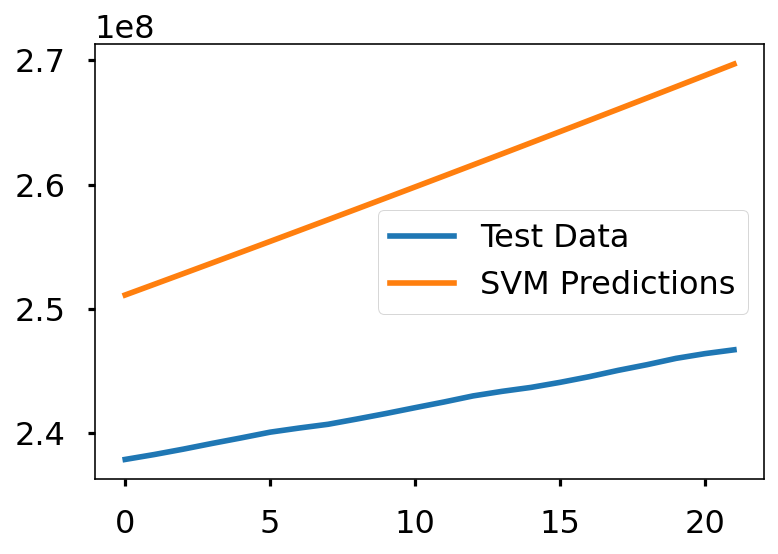

In [ ]:
# test adathalmaz ellenorzese
svm_test_pred = svm_confirmed.predict(X_test_confirmed)
plt.plot(y_test_confirmed)
plt.plot(svm_test_pred)
plt.legend(['Test Data', 'SVM Predictions'])
print('MAE:', mean_absolute_error(svm_test_pred, y_test_confirmed))
print('MSE:',mean_squared_error(svm_test_pred, y_test_confirmed))

In [ ]:
#adatok átalakítása polynomial regressziohoz
poly = PolynomialFeatures(degree=2)
poly_X_train_confirmed = poly.fit_transform(X_train_confirmed)
poly_X_test_confirmed = poly.fit_transform(X_test_confirmed)
poly_future_forcast = poly.fit_transform(future_forcast)

bayesian_poly = PolynomialFeatures(degree=2)
bayesian_poly_X_train_confirmed = bayesian_poly.fit_transform(X_train_confirmed)
bayesian_poly_X_test_confirmed = bayesian_poly.fit_transform(X_test_confirmed)
bayesian_poly_future_forcast = bayesian_poly.fit_transform(future_forcast)

In [ ]:
# polynomial regresszio
linear_model = LinearRegression(normalize=True, fit_intercept=False)
linear_model.fit(poly_X_train_confirmed, y_train_confirmed)
test_linear_pred = linear_model.predict(poly_X_test_confirmed)
linear_pred = linear_model.predict(poly_future_forcast)
print('MAE:', mean_absolute_error(test_linear_pred, y_test_confirmed))
print('MSE:',mean_squared_error(test_linear_pred, y_test_confirmed))

MAE: 2010688.0438659177
MSE: 4535678407092.692


In [ ]:
print(linear_model.coef_)

[[-1.27737390e+08  6.35100871e+05 -8.07512986e+01]]


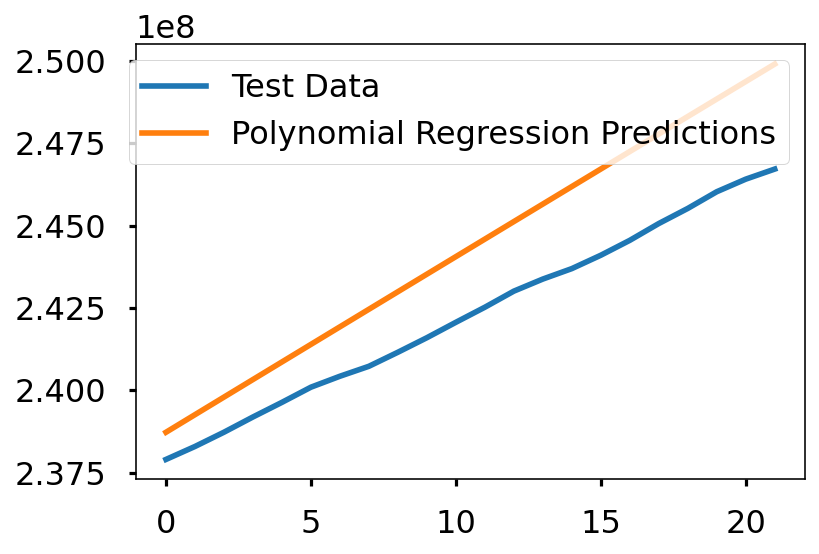

In [ ]:
plt.plot(y_test_confirmed)
plt.plot(test_linear_pred)
plt.legend(['Test Data', 'Polynomial Regression Predictions'])

In [ ]:
# bayesian ridge polynomial regression
tol = [1e-6, 1e-5, 1e-4, 1e-3, 1e-2]
alpha_1 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
alpha_2 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
lambda_1 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
lambda_2 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
normalize = [True, False]

bayesian_grid = {'tol': tol, 'alpha_1': alpha_1, 'alpha_2' : alpha_2, 'lambda_1': lambda_1, 'lambda_2' : lambda_2, 
                 'normalize' : normalize}

bayesian = BayesianRidge(fit_intercept=False)
bayesian_search = RandomizedSearchCV(bayesian, bayesian_grid, scoring='neg_mean_squared_error', cv=3, return_train_score=True, n_jobs=-1, n_iter=40, verbose=1)
bayesian_search.fit(bayesian_poly_X_train_confirmed, y_train_confirmed)

Fitting 3 folds for each of 40 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    1.6s finished


RandomizedSearchCV(cv=3, error_score=nan,
                   estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06,
                                           alpha_init=None, compute_score=False,
                                           copy_X=True, fit_intercept=False,
                                           lambda_1=1e-06, lambda_2=1e-06,
                                           lambda_init=None, n_iter=300,
                                           normalize=False, tol=0.001,
                                           verbose=False),
                   iid='deprecated', n_iter=40, n_jobs=-1,
                   param_distributions={'alpha_1': [1e-07, 1e-06, 1e-05, 0.0001,
                                                    0.001],
                                        'alpha_2': [1e-07, 1e-06, 1e-05, 0.0001,
                                                    0.001],
                                        'lambda_1': [1e-07, 1e-06, 1e-05,
                                  

In [ ]:
bayesian_search.best_params_

{'alpha_1': 0.001,
 'alpha_2': 1e-05,
 'lambda_1': 1e-07,
 'lambda_2': 1e-06,
 'normalize': True,
 'tol': 1e-06}

In [ ]:
bayesian_confirmed = bayesian_search.best_estimator_
test_bayesian_pred = bayesian_confirmed.predict(bayesian_poly_X_test_confirmed)
bayesian_pred = bayesian_confirmed.predict(bayesian_poly_future_forcast)
print('MAE:', mean_absolute_error(test_bayesian_pred, y_test_confirmed))
print('MSE:',mean_squared_error(test_bayesian_pred, y_test_confirmed))

MAE: 8336742.450739472
MSE: 71928890323759.19


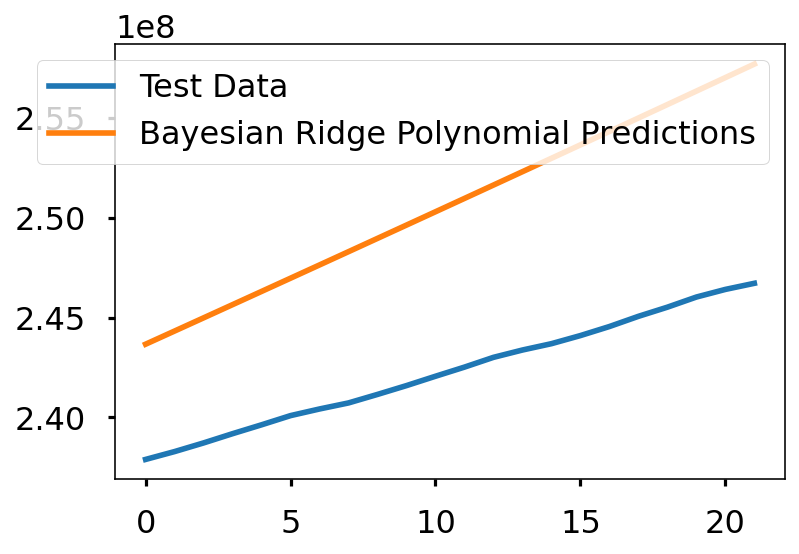

In [ ]:
plt.plot(y_test_confirmed)
plt.plot(test_bayesian_pred)
plt.legend(['Test Data', 'Bayesian Ridge Polynomial Predictions'])

Worldwide Overview

A megerősített esetek számának, a halálozásoknak és a halálozási aránynak (CFR) ábrázolása. Ez átfogó képet ad a folyamatban lévő járványról.

In [ ]:
# segítő módszer az adatok lapítására, így oszlopdiagramon is megjeleníthető
def flatten(arr):
    a = [] 
    arr = arr.tolist()
    for i in arr:
        a.append(i[0])
    return a

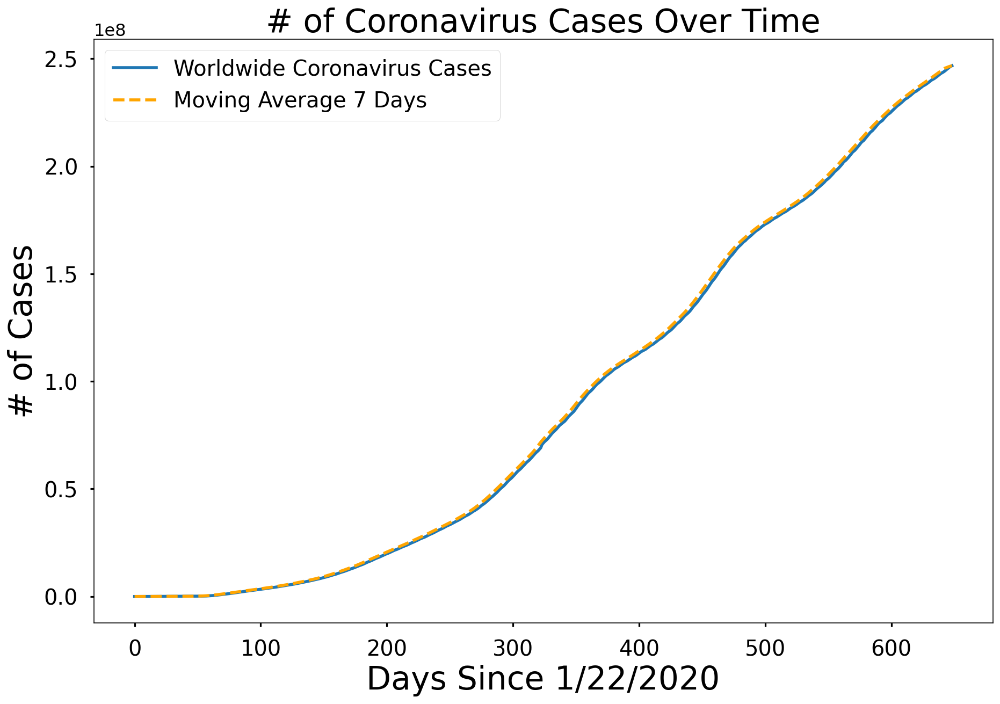

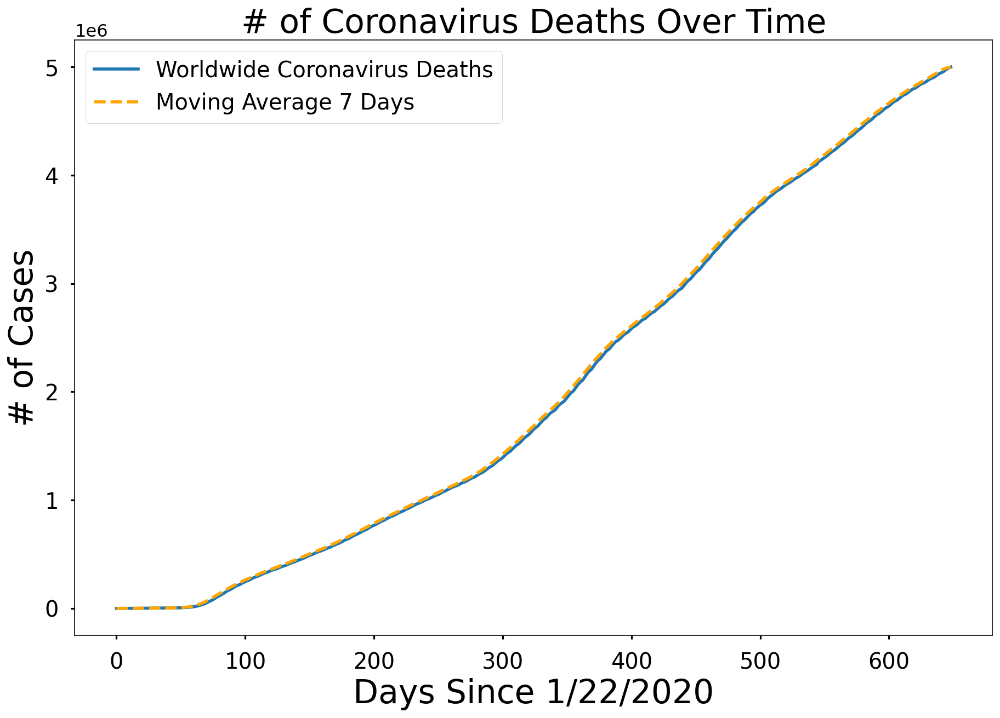

In [ ]:
adjusted_dates = adjusted_dates.reshape(1, -1)[0]
plt.figure(figsize=(15, 10))
plt.plot(adjusted_dates, world_cases)
plt.plot(adjusted_dates, world_confirmed_avg, linestyle='dashed', color='orange')
plt.title('# of Coronavirus Cases Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('# of Cases', size=30)
plt.legend(['Worldwide Coronavirus Cases', 'Moving Average {} Days'.format(window)], prop={'size': 20})
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

plt.figure(figsize=(15,10))
plt.plot(adjusted_dates, total_deaths)
plt.plot(adjusted_dates, world_death_avg, linestyle='dashed', color='orange')
plt.title('# of Coronavirus Deaths Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('# of Cases', size=30)
plt.legend(['Worldwide Coronavirus Deaths', 'Moving Average {} Days'.format(window)], prop={'size': 20})
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

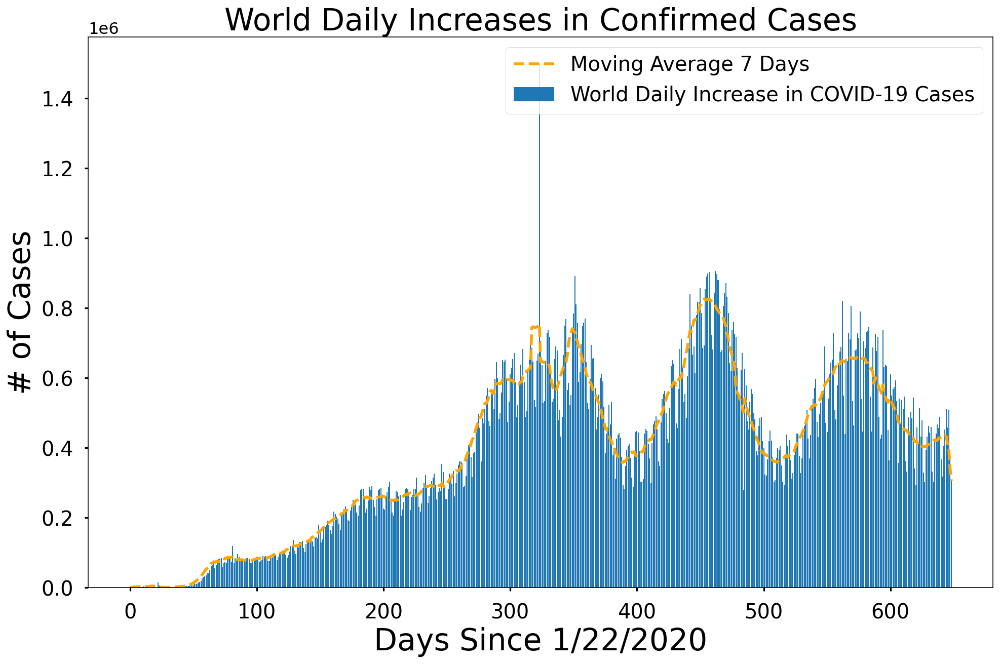

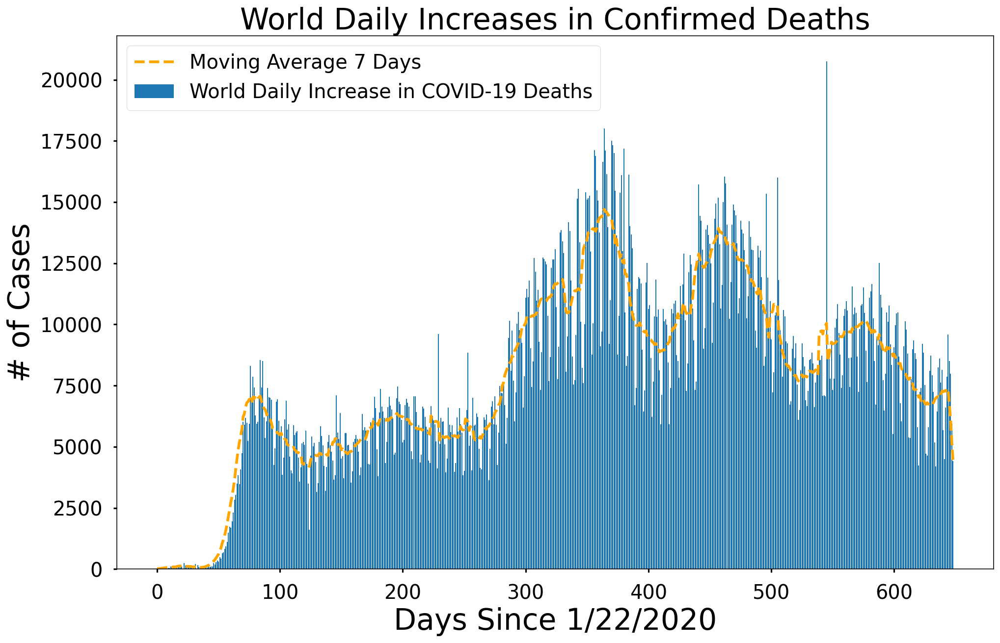

In [ ]:
plt.figure(figsize=(16, 10))
plt.bar(adjusted_dates, world_daily_increase)
plt.plot(adjusted_dates, world_daily_increase_avg, color='orange', linestyle='dashed')
plt.title('World Daily Increases in Confirmed Cases', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('# of Cases', size=30)
plt.legend(['Moving Average {} Days'.format(window), 'World Daily Increase in COVID-19 Cases'], prop={'size': 20})
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

plt.figure(figsize=(16, 10))
plt.bar(adjusted_dates, world_daily_death)
plt.plot(adjusted_dates, world_daily_death_avg, color='orange', linestyle='dashed')
plt.title('World Daily Increases in Confirmed Deaths', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('# of Cases', size=30)
plt.legend(['Moving Average {} Days'.format(window), 'World Daily Increase in COVID-19 Deaths'], prop={'size': 20})
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

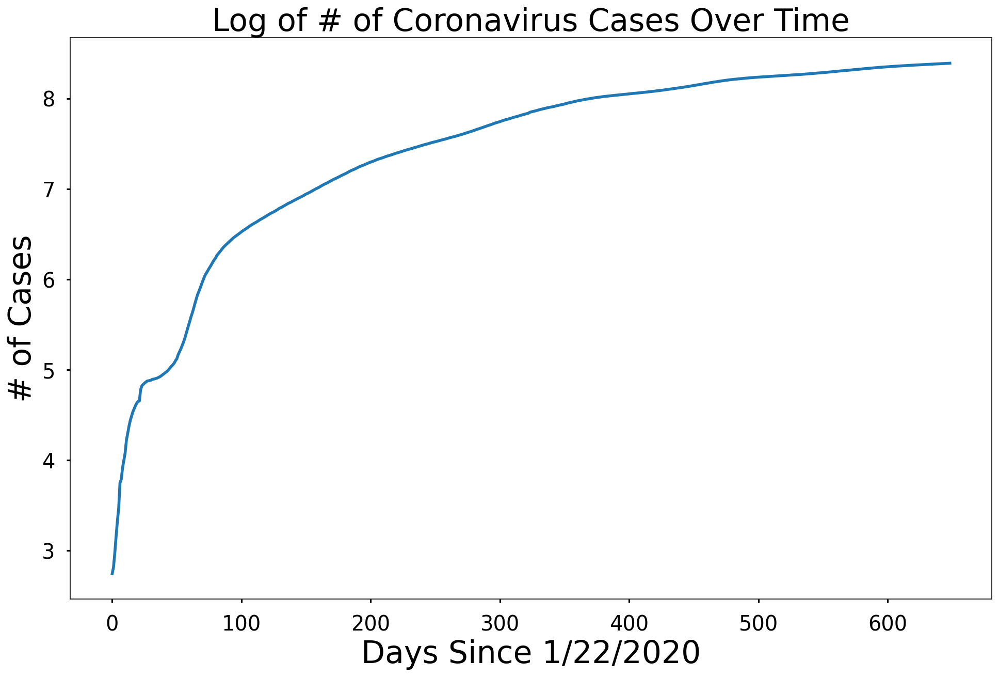

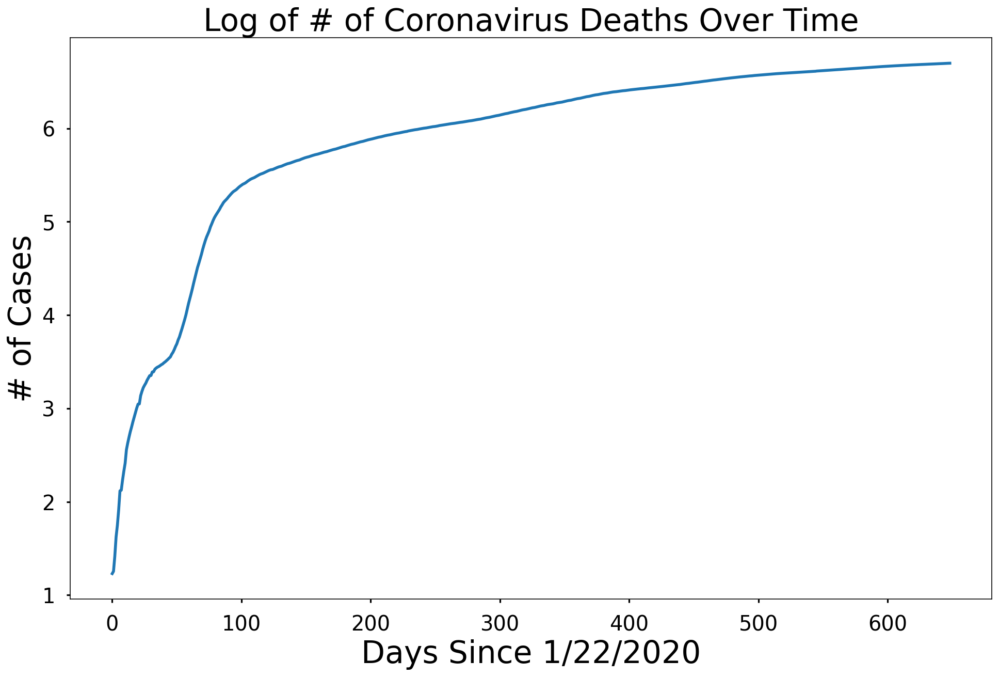

In [ ]:
plt.figure(figsize=(16, 10))
plt.plot(adjusted_dates, np.log10(world_cases))
plt.title('Log of # of Coronavirus Cases Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('# of Cases', size=30)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

plt.figure(figsize=(16, 10))
plt.plot(adjusted_dates, np.log10(total_deaths))
plt.title('Log of # of Coronavirus Deaths Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('# of Cases', size=30)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

In [ ]:
def country_plot(x, y1, y2, y3, country):
    confirmed_avg = moving_average(y1, window)
    confirmed_increase_avg = moving_average(y2, window)
    death_increase_avg = moving_average(y3, window)
    
    plt.figure(figsize=(16, 10))
    plt.plot(x, y1)
    plt.plot(x, confirmed_avg, color='red', linestyle='dashed')
    plt.legend(['{} Confirmed Cases'.format(country), 'Moving Average {} Days'.format(window)], prop={'size': 20})
    plt.title('{} Confirmed Cases'.format(country), size=30)
    plt.xlabel('Days Since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()

    plt.figure(figsize=(16, 10))
    plt.bar(x, y2)
    plt.plot(x, confirmed_increase_avg, color='red', linestyle='dashed')
    plt.legend(['Moving Average {} Days'.format(window), '{} Daily Increase in Confirmed Cases'.format(country)], prop={'size': 20})
    plt.title('{} Daily Increases in Confirmed Cases'.format(country), size=30)
    plt.xlabel('Days Since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()

    plt.figure(figsize=(16, 10))
    plt.bar(x, y3)
    plt.plot(x, death_increase_avg, color='red', linestyle='dashed')
    plt.legend(['Moving Average {} Days'.format(window), '{} Daily Increase in Confirmed Deaths'.format(country)], prop={'size': 20})
    plt.title('{} Daily Increases in Deaths'.format(country), size=30)
    plt.xlabel('Days Since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()
      
# segítő funkció az ország eseteinek, haláleseteinek és felépülésének megszerzéséhez      
def get_country_info(country_name):
    country_cases = []
    country_deaths = []
    
    for i in dates:
        country_cases.append(confirmed_df[confirmed_df['Country/Region']==country_name][i].sum())
        country_deaths.append(deaths_df[deaths_df['Country/Region']==country_name][i].sum())
    return (country_cases, country_deaths)
    
    
def country_visualizations(country_name):
    country_info = get_country_info(country_name)
    country_cases = country_info[0]
    country_deaths = country_info[1]
    
    country_daily_increase = daily_increase(country_cases)
    country_daily_death = daily_increase(country_deaths)
    
    country_plot(adjusted_dates, country_cases, country_daily_increase, country_daily_death, country_name)

Country Specific Graphs

konkrét országokat veszünk szemügyre. Ez lehetővé teszi a járvány helyi szintű vizsgálatát.

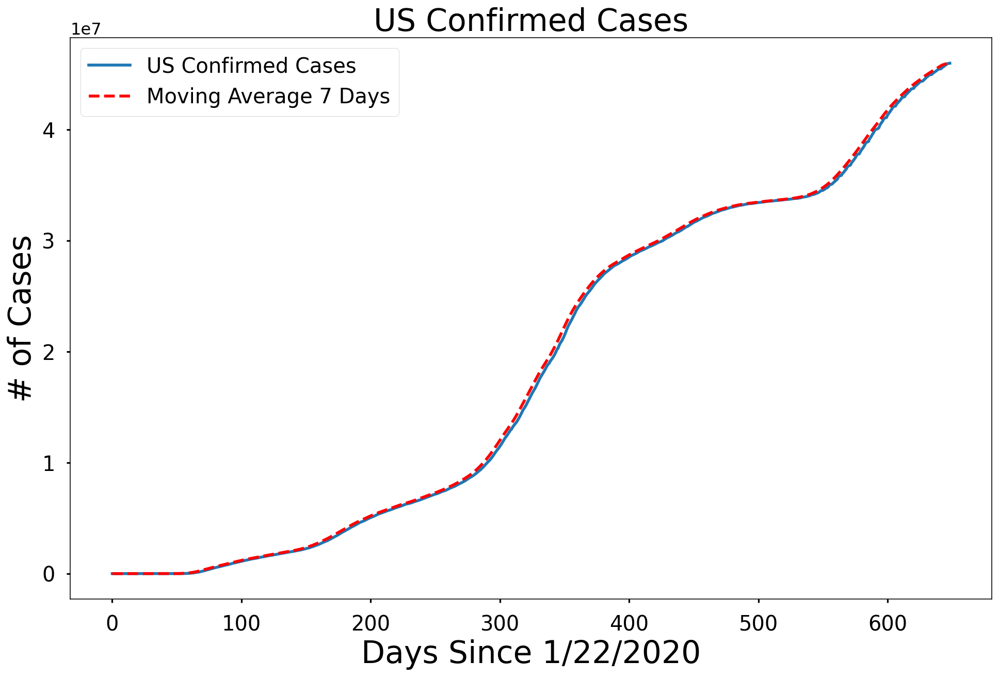

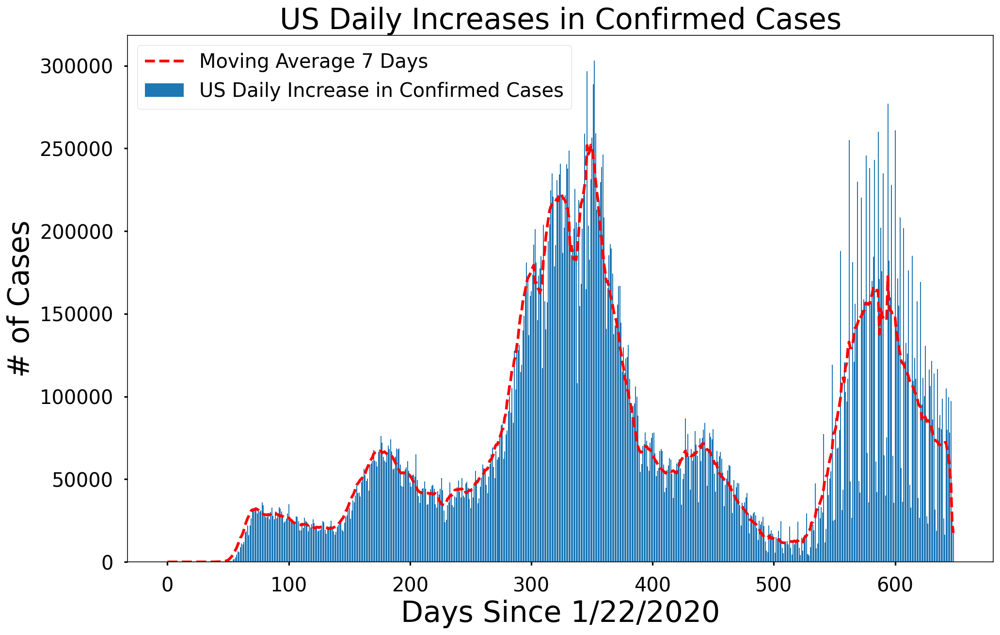

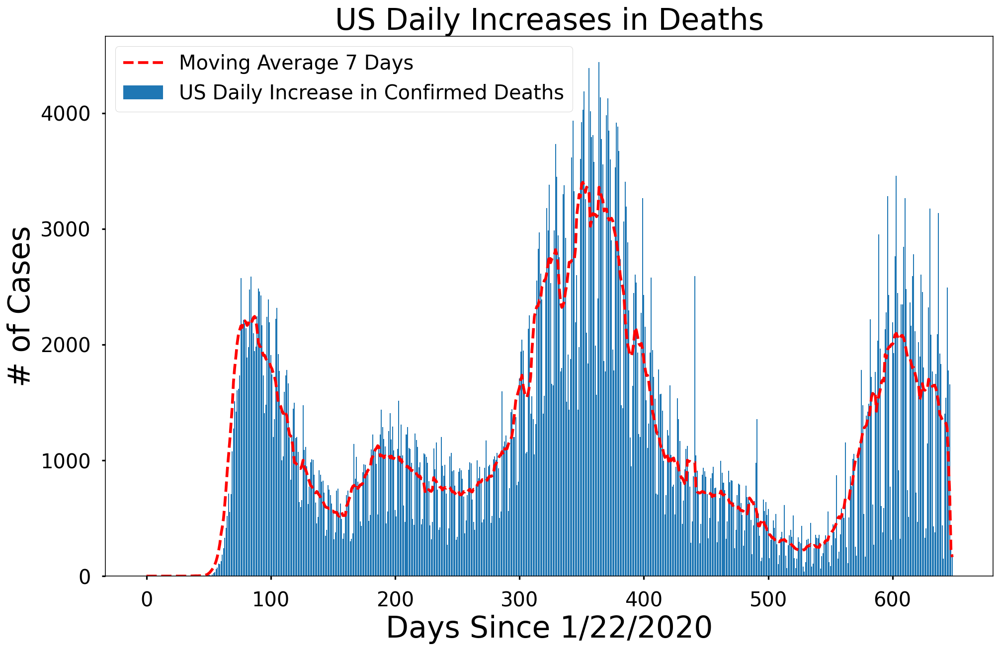

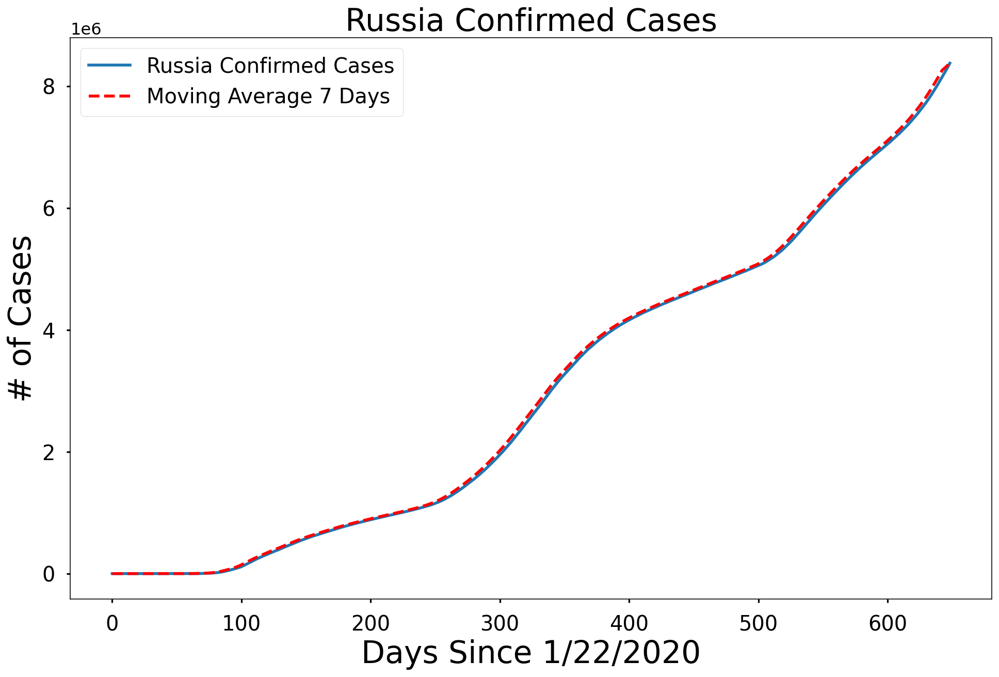

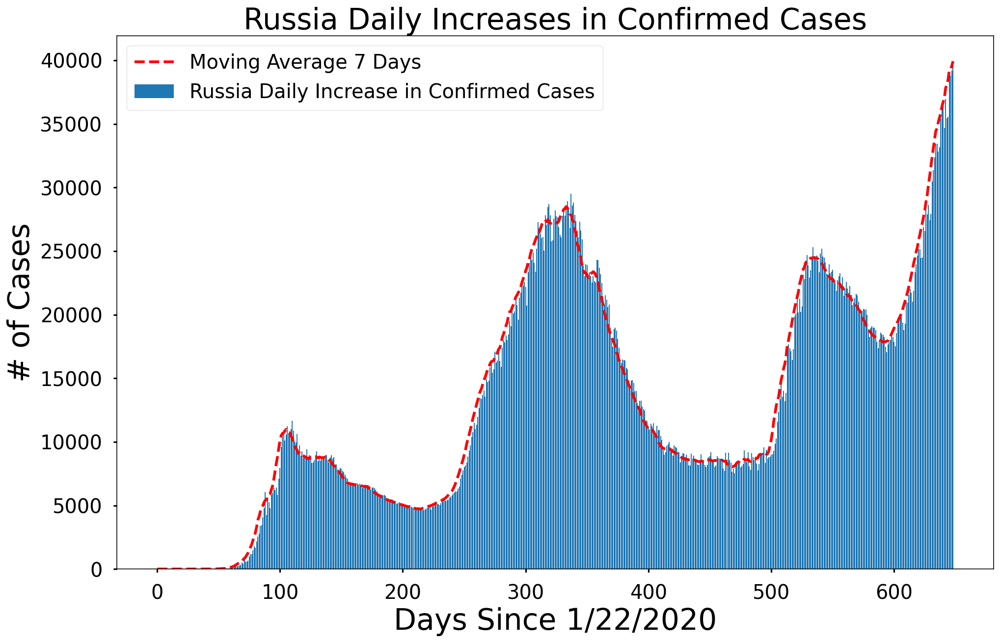

...

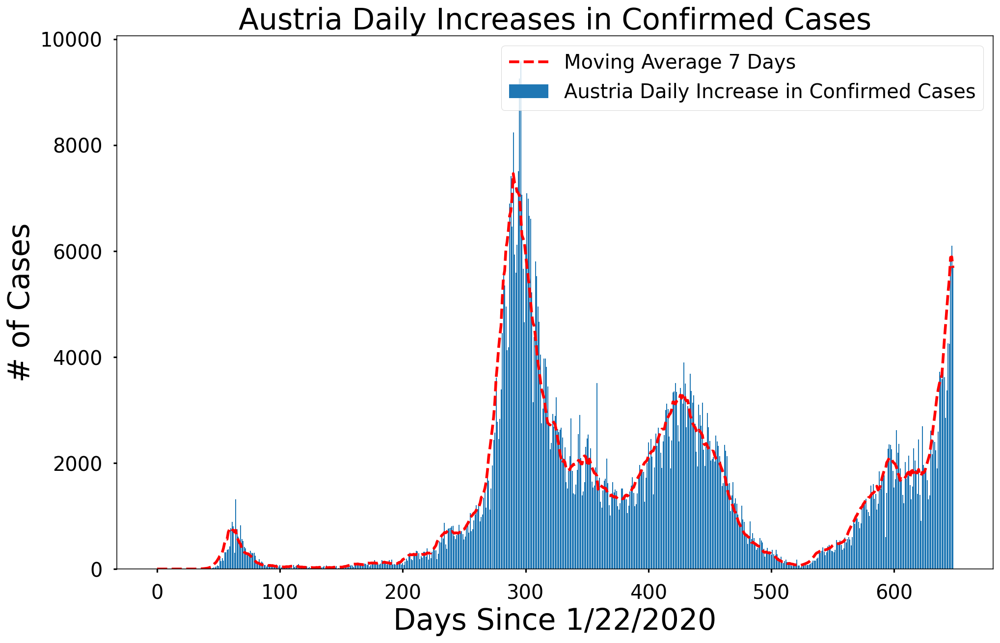

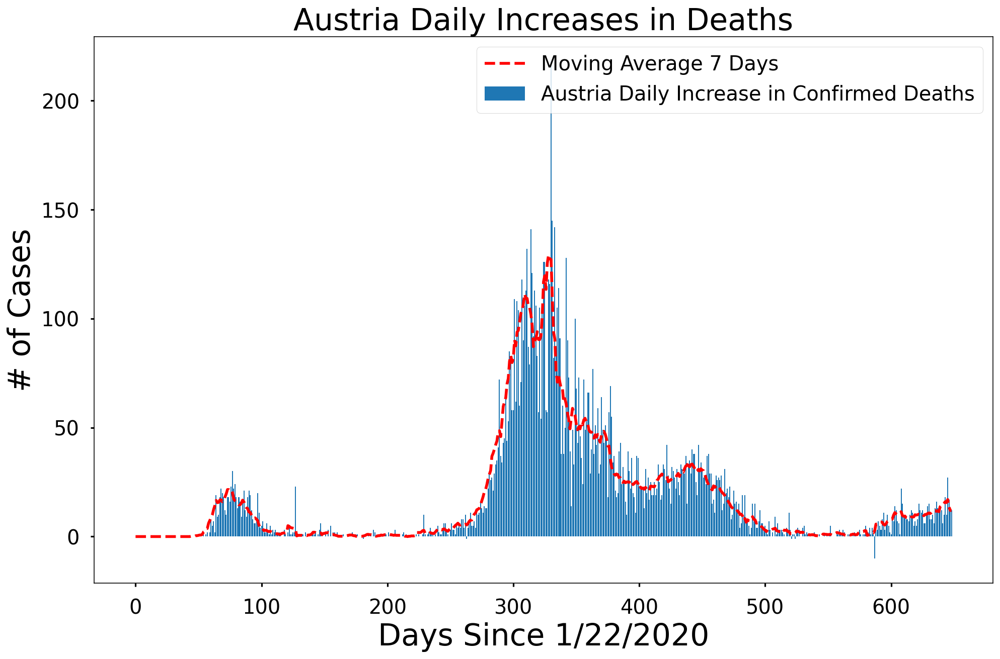

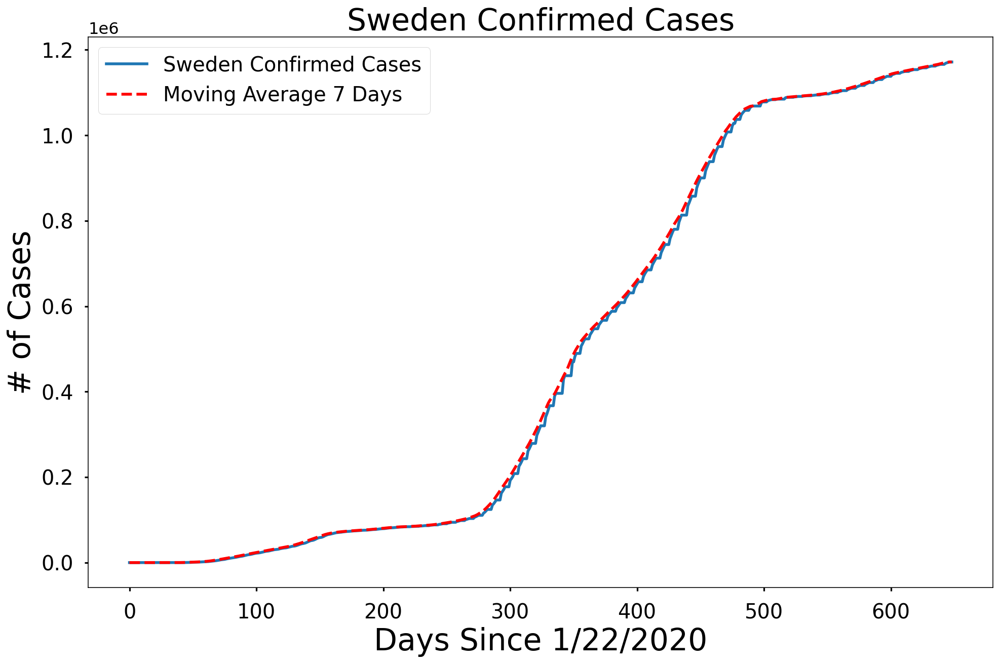

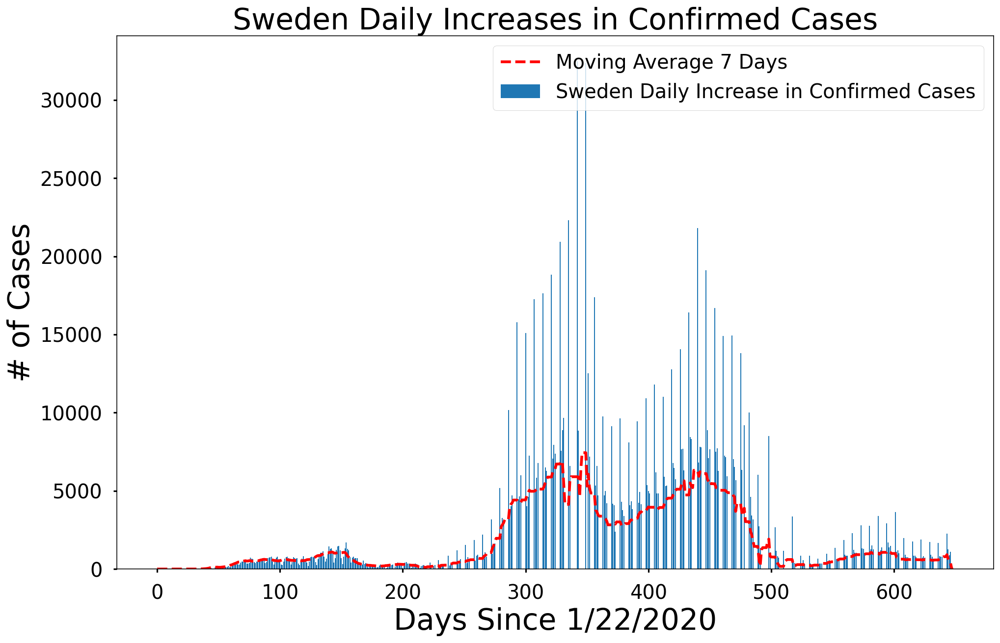

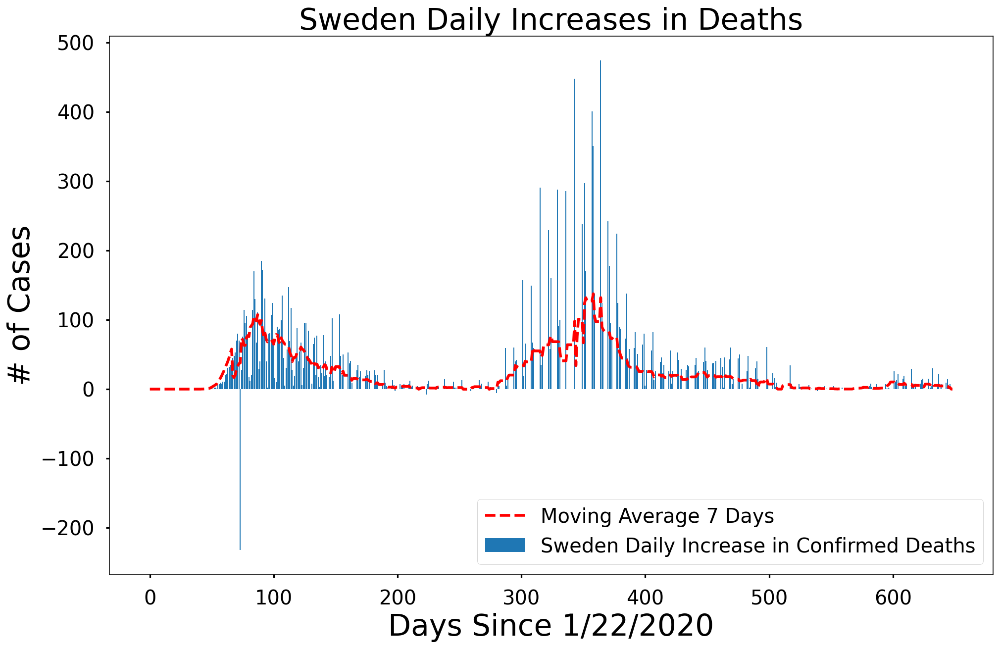

In [ ]:
countries = ['US', 'Russia', 'India', 'Brazil', 'South Africa', 'China', 'Italy',
             'Germany', 'Spain', 'France', 'United Kingdom', 'Peru', 'Mexico', 'Colombia', 'Argentina', 'Saudi Arabia', 'Iran', 'Bangladesh',
            'Pakistan', 'Turkey', 'Philippines', 'Iraq', 'Indonesia', 'Israel', 'Ukraine', 'Ecuador', 'Bolivia', 'Netherlands', 'Belgium', 'Poland', 'Czechia', 'Switzerland',
            'Romania', 'Morocco','Portugal', 'Austria', 'Sweden'] 

for country in countries:
    country_visualizations(country)

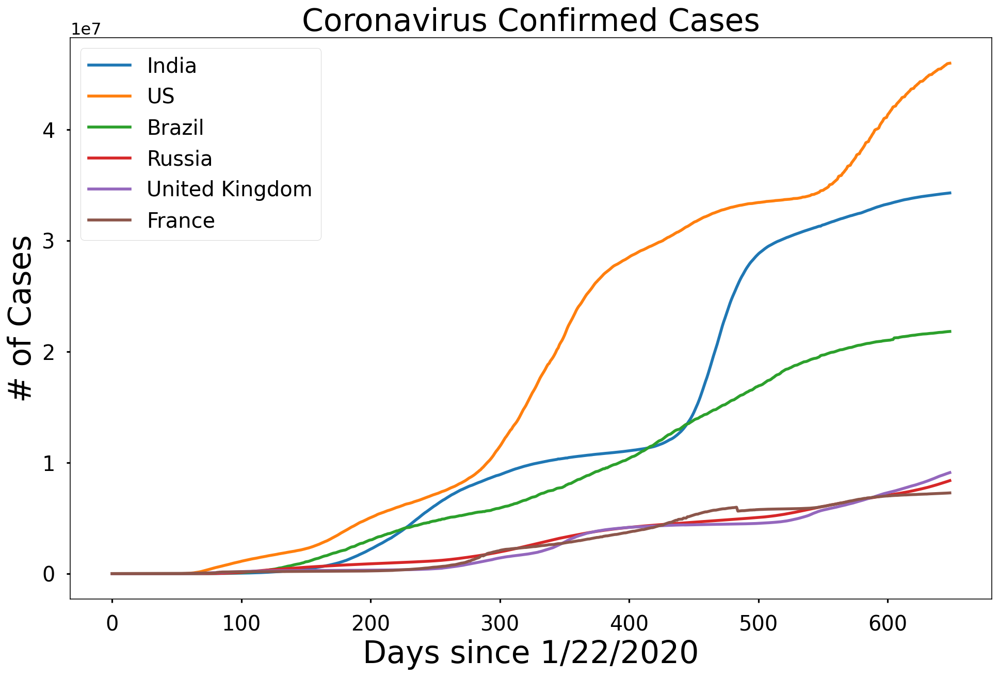

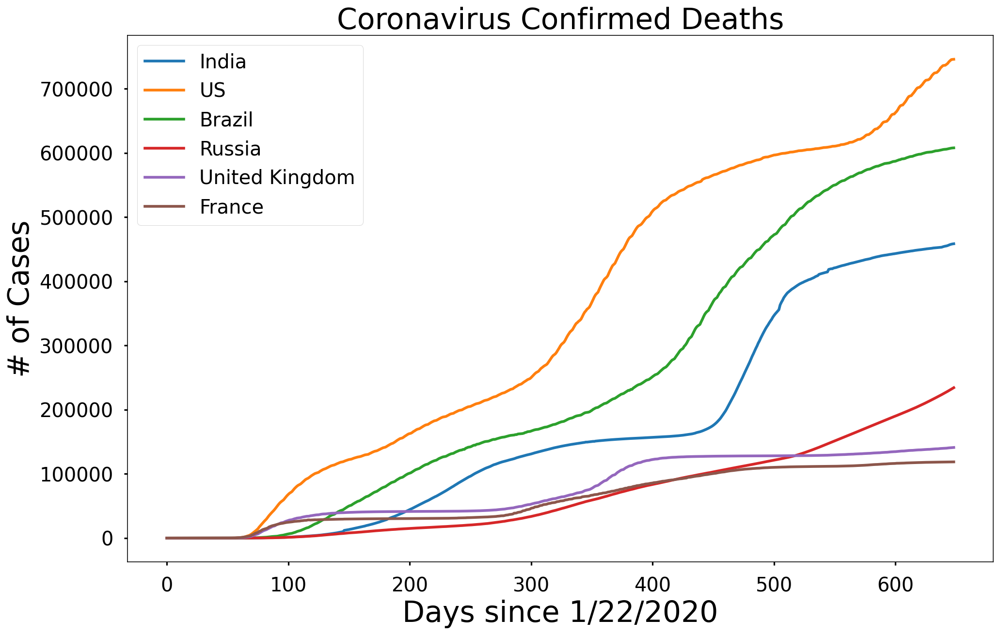

In [ ]:
#Ország-összehasonlítás

compare_countries = ['India', 'US', 'Brazil', 'Russia', 'United Kingdom', 'France'] 
graph_name = ['Coronavirus Confirmed Cases', 'Coronavirus Confirmed Deaths']

for num in range(2):
    plt.figure(figsize=(16, 10))
    for country in compare_countries:
        plt.plot(get_country_info(country)[num])
    plt.legend(compare_countries, prop={'size': 20})
    plt.xlabel('Days since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.title(graph_name[num], size=30)
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()

In [ ]:
def plot_predictions(x, y, pred, algo_name, color):
    plt.figure(figsize=(16, 10))
    plt.plot(x, y)
    plt.plot(future_forcast, pred, linestyle='dashed', color=color)
    plt.title('Worldwide Coronavirus Cases Over Time', size=30)
    plt.xlabel('Days Since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.legend(['Confirmed Cases', algo_name], prop={'size': 20})
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()

Előrejelzések a megerősített koronavírusos esetekről világszerte

Modellek:

    Support Vector Machine
    Polynomial Regression
    Bayesian Ridge Regression



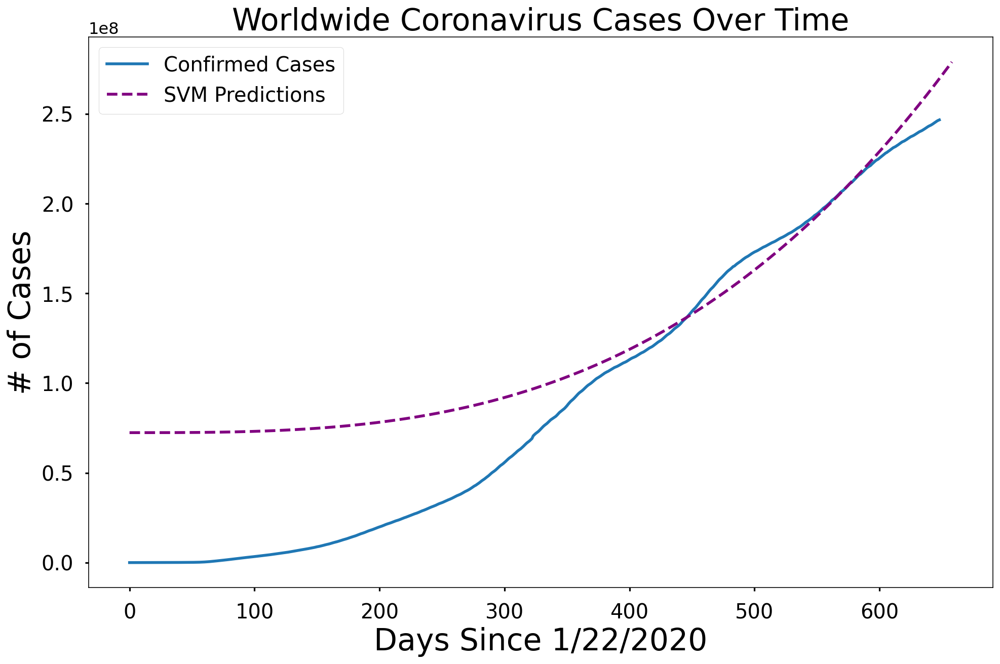

In [ ]:
plot_predictions(adjusted_dates, world_cases, svm_pred, 'SVM Predictions', 'purple')

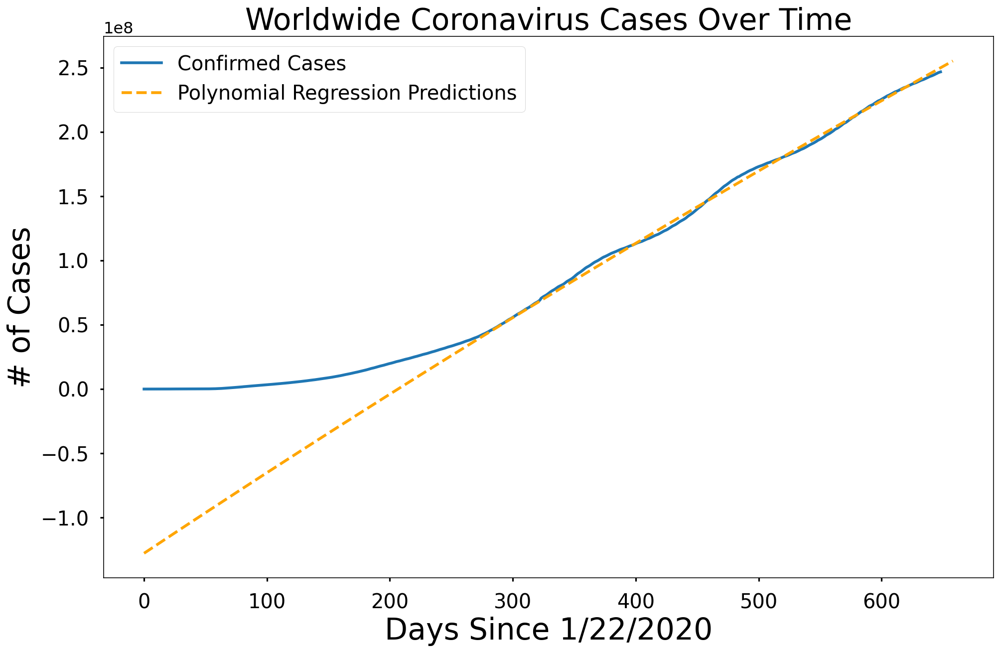

In [ ]:
plot_predictions(adjusted_dates, world_cases, linear_pred, 'Polynomial Regression Predictions', 'orange')

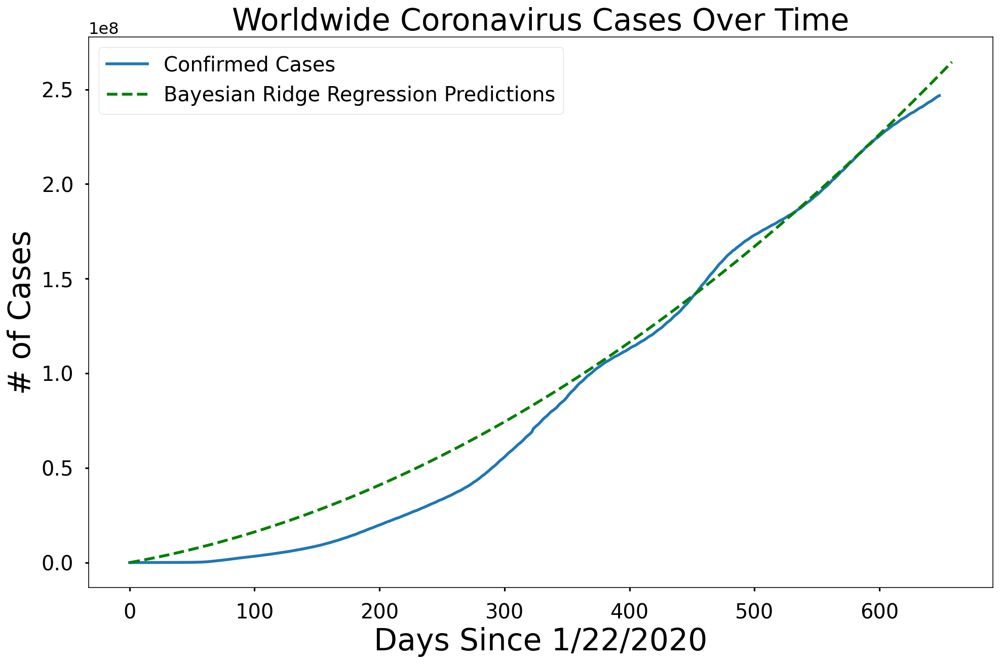

In [ ]:
plot_predictions(adjusted_dates, world_cases, bayesian_pred, 'Bayesian Ridge Regression Predictions', 'green')

In [ ]:
# Jövőbeli előrejelzések SVM használatával
svm_df = pd.DataFrame({'Date': future_forcast_dates[-10:], 'SVM Predicted # of Confirmed Cases Worldwide': np.round(svm_pred[-10:])})
svm_df.style.background_gradient(cmap='Reds')

,Date,SVM Predicted # of Confirmed Cases Worldwide
0,11/01/2021,270603229.000000
1,11/02/2021,271520781.000000
2,11/03/2021,272441161.000000
3,11/04/2021,273364372.000000
4,11/05/2021,274290420.000000
5,11/06/2021,275219308.000000
6,11/07/2021,276151041.000000
7,11/08/2021,277085624.000000
8,11/09/2021,278023060.000000
9,11/10/2021,278963355.000000


In [ ]:
# Jövőbeli előrejelzések polinomiális regresszióval
linear_pred = linear_pred.reshape(1,-1)[0]
linear_df = pd.DataFrame({'Date': future_forcast_dates[-10:], 'Polynomial Predicted # of Confirmed Cases Worldwide': np.round(linear_pred[-10:])})
linear_df.style.background_gradient(cmap='Reds')

,Date,Polynomial Predicted # of Confirmed Cases Worldwide
0,11/01/2021,250430548.000000
1,11/02/2021,250960752.000000
2,11/03/2021,251490796.000000
3,11/04/2021,252020678.000000
4,11/05/2021,252550398.000000
5,11/06/2021,253079957.000000
6,11/07/2021,253609355.000000
7,11/08/2021,254138591.000000
8,11/09/2021,254667665.000000
9,11/10/2021,255196578.000000


In [ ]:
# Jövőbeli előrejelzések a Bayesian Ridge használatával
bayesian_df = pd.DataFrame({'Date': future_forcast_dates[-10:], 'Bayesian Ridge Predicted # of Confirmed Cases Worldwide': np.round(bayesian_pred[-10:])})
bayesian_df.style.background_gradient(cmap='Reds')

,Date,Bayesian Ridge Predicted # of Confirmed Cases Worldwide
0,11/01/2021,258359407.000000
1,11/02/2021,259037162.000000
2,11/03/2021,259715778.000000
3,11/04/2021,260395254.000000
4,11/05/2021,261075591.000000
5,11/06/2021,261756788.000000
6,11/07/2021,262438845.000000
7,11/08/2021,263121763.000000
8,11/09/2021,263805542.000000
9,11/10/2021,264490181.000000


A halálozási ráta (világszerte) hajlamos a változásra

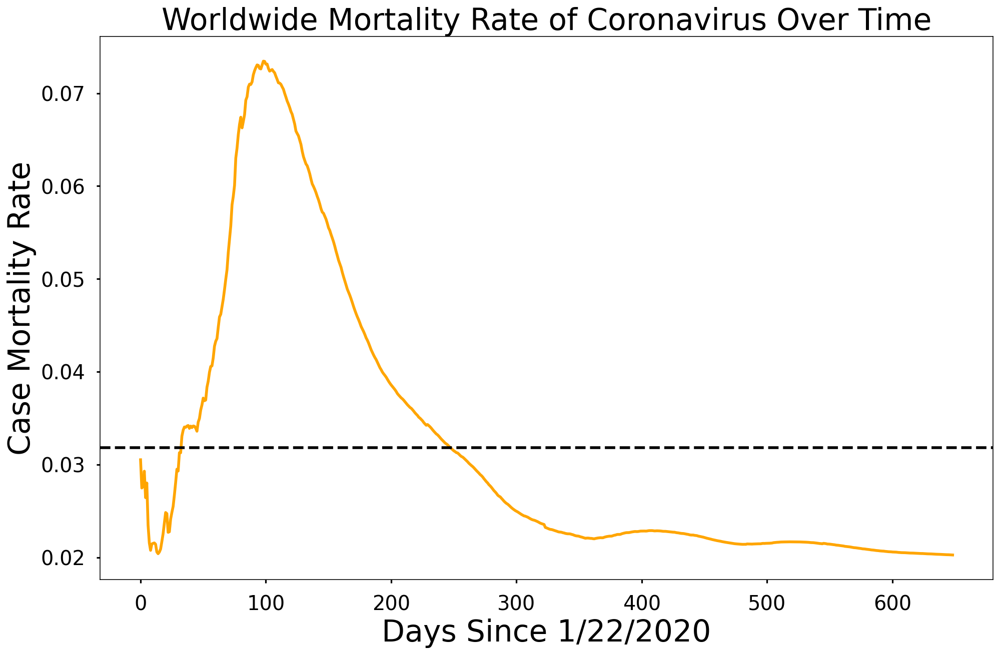

In [ ]:
mean_mortality_rate = np.mean(mortality_rate)
plt.figure(figsize=(16, 10))
plt.plot(adjusted_dates, mortality_rate, color='orange')
plt.axhline(y = mean_mortality_rate,linestyle='--', color='black')
plt.title('Worldwide Mortality Rate of Coronavirus Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('Case Mortality Rate', size=30)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

A helyreállítási ráta (világszerte) változhat

In [ ]:
mean_recovery_rate = np.mean(recovery_rate)
plt.figure(figsize=(16, 10))
plt.plot(adjusted_dates, recovery_rate, color='blue')
plt.title('Worldwide Recovery Rate of Coronavirus Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('Case Recovery Rate', size=30)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

NameError: ignored

A halálozások és a felépülések ábrázolása

In [ ]:
plt.figure(figsize=(16, 10))
plt.plot(adjusted_dates, total_deaths, color='r')
plt.plot(adjusted_dates, total_recovered, color='green')
plt.legend(['death', 'recoveries'], loc='best', fontsize=25)
plt.title('Worldwide Coronavirus Cases', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('# of Cases', size=30)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

Az elhunytak számának összevetése a felépülések számával.

In [ ]:
plt.figure(figsize=(16, 10))
plt.plot(total_recovered, total_deaths)
plt.title('# of Coronavirus Deaths vs. # of Coronavirus Recoveries', size=30)
plt.xlabel('# of Coronavirus Recoveries', size=30)
plt.ylabel('# of Coronavirus Deaths', size=30)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

Információszerzés azokról az országokról/régiókról, amelyekben megerősítették a koronavírus-fertőzést

In [ ]:
latest_data

,FIPS,Admin2,Province_State,Country_Region,Last_Update,Lat,Long_,Confirmed,Deaths,Recovered,Active,Combined_Key,Incident_Rate,Case_Fatality_Ratio
0,nan,NaN,NaN,Afghanistan,2021-10-23 04:21:32,34,68,155931,7252,nan,nan,Afghanistan,401,5
1,nan,NaN,NaN,Albania,2021-10-23 04:21:32,41,20,180623,2863,nan,nan,Albania,6276,2
2,nan,NaN,NaN,Algeria,2021-10-23 04:21:32,28,2,205683,5883,nan,nan,Algeria,469,3
3,nan,NaN,NaN,Andorra,2021-10-23 04:21:32,43,2,15404,130,nan,nan,Andorra,19937,1
4,nan,NaN,NaN,Angola,2021-10-23 04:21:32,-11,18,63691,1693,nan,nan,Angola,194,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4001,nan,NaN,NaN,West Bank and Gaza,2021-10-23 04:21:32,32,35,450310,4611,nan,nan,West Bank and Gaza,8827,1
4002,nan,NaN,NaN,Yemen,2021-10-23 04:21:32,16,49,9650,1835,nan,nan,Yemen,32,19
4003,nan,NaN,NaN,Zambia,2021-10-23 04:21:32,-13,28,209610,3658,nan,nan,Zambia,1140,2
4004,nan,NaN,NaN,Zimbabwe,2021-10-23 04:21:32,-19,29,132588,4663,nan,nan,Zimbabwe,892,4


In [ ]:
unique_countries =  list(latest_data['Country_Region'].unique())

In [ ]:
country_confirmed_cases = []
country_death_cases = [] 
country_active_cases = []
# country_recovery_cases = []
country_incidence_rate = [] 
country_mortality_rate = [] 

no_cases = []
for i in unique_countries:
    cases = latest_data[latest_data['Country_Region']==i]['Confirmed'].sum()
    if cases > 0:
        country_confirmed_cases.append(cases)
    else:
        no_cases.append(i)
        
for i in no_cases:
    unique_countries.remove(i)
    
# sort countries by the number of confirmed cases
unique_countries = [k for k, v in sorted(zip(unique_countries, country_confirmed_cases), key=operator.itemgetter(1), reverse=True)]
for i in range(len(unique_countries)):
    country_confirmed_cases[i] = latest_data[latest_data['Country_Region']==unique_countries[i]]['Confirmed'].sum()
    country_death_cases.append(latest_data[latest_data['Country_Region']==unique_countries[i]]['Deaths'].sum())
#     country_recovery_cases.append(latest_data[latest_data['Country_Region']==unique_countries[i]]['Recovered'].sum())
#     country_active_cases.append(latest_data[latest_data['Country_Region']==unique_countries[i]]['Active'].sum())
    country_incidence_rate.append(latest_data[latest_data['Country_Region']==unique_countries[i]]['Incident_Rate'].sum())
    country_mortality_rate.append(country_death_cases[i]/country_confirmed_cases[i])

Data table

Ez több ország covid adatait mutatja. A táblázat tartalmazza a megerősített esetek számát, a halálozást, az előfordulási arányt és a halálozási arányt.


In [ ]:
country_df = pd.DataFrame({'Country Name': unique_countries, 'Number of Confirmed Cases': [format(int(i), ',d') for i in country_confirmed_cases],
                          'Number of Deaths': [format(int(i), ',d') for i in country_death_cases], 
                          'Incidence Rate' : country_incidence_rate,
                          'Mortality Rate': country_mortality_rate})
# number of cases per country/region

country_df.style.background_gradient(cmap='Oranges')

,Country Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,US,"45,421,275","735,921",46281420.294170,0.016202
1,India,"34,159,562","453,708",148518.466781,0.013282
2,Brazil,"21,711,843","605,139",318010.195729,0.027871
3,United Kingdom,"8,730,787","139,743",122814.839683,0.016006
4,Russia,"8,041,581","224,369",455262.710811,0.027901
5,Turkey,"7,800,766","68,700",9249.291316,0.008807
6,France,"7,215,584","118,373",114062.299958,0.016405
7,Iran,"5,844,589","124,928",6958.427810,0.021375
8,Argentina,"5,278,910","115,819",11680.095687,0.021940
9,Spain,"4,997,732","87,132",195653.278981,0.017434


In [ ]:
unique_provinces =  list(latest_data['Province_State'].unique())

A legfrissebb információk megszerzése azokról a tartományokról/államokról, amelyekben megerősítették a koronavírus-fertőzést

In [ ]:
province_confirmed_cases = []
province_country = [] 
province_death_cases = [] 
# province_recovery_cases = []
# province_active = [] 
province_incidence_rate = []
province_mortality_rate = [] 

no_cases = [] 
for i in unique_provinces:
    cases = latest_data[latest_data['Province_State']==i]['Confirmed'].sum()
    if cases > 0:
        province_confirmed_cases.append(cases)
    else:
        no_cases.append(i)
 
# remove areas with no confirmed cases
for i in no_cases:
    unique_provinces.remove(i)
    
unique_provinces = [k for k, v in sorted(zip(unique_provinces, province_confirmed_cases), key=operator.itemgetter(1), reverse=True)]
for i in range(len(unique_provinces)):
    province_confirmed_cases[i] = latest_data[latest_data['Province_State']==unique_provinces[i]]['Confirmed'].sum()
    province_country.append(latest_data[latest_data['Province_State']==unique_provinces[i]]['Country_Region'].unique()[0])
    province_death_cases.append(latest_data[latest_data['Province_State']==unique_provinces[i]]['Deaths'].sum())
#     province_recovery_cases.append(latest_data[latest_data['Province_State']==unique_provinces[i]]['Recovered'].sum())
#     province_active.append(latest_data[latest_data['Province_State']==unique_provinces[i]]['Active'].sum())
    province_incidence_rate.append(latest_data[latest_data['Province_State']==unique_provinces[i]]['Incident_Rate'].sum())
    province_mortality_rate.append(province_death_cases[i]/province_confirmed_cases[i])

In [ ]:
# number of cases per province/state/city top 100 
province_limit = 100 
province_df = pd.DataFrame({'Province/State Name': unique_provinces[:province_limit], 'Country': province_country[:province_limit], 'Number of Confirmed Cases': [format(int(i), ',d') for i in province_confirmed_cases[:province_limit]],
                          'Number of Deaths': [format(int(i), ',d') for i in province_death_cases[:province_limit]], 
                        'Incidence Rate' : province_incidence_rate[:province_limit], 'Mortality Rate': province_mortality_rate[:province_limit]})
# number of cases per country/region

province_df.style.background_gradient(cmap='Oranges')

,Province/State Name,Country,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,England,United Kingdom,"7,388,884","121,575",13199.809923,0.016454
1,Maharashtra,India,"6,599,850","139,965",5359.447515,0.021207
2,Kerala,India,"4,897,884","27,765",13719.777084,0.005669
3,California,US,"4,869,755","71,328",674892.539325,0.014647
4,Sao Paulo,Brazil,"4,396,904","151,471",9575.337677,0.034449
5,Texas,US,"4,206,675","70,025",3826427.569217,0.016646
6,Florida,US,"3,678,661","58,803",1150495.059937,0.015985
7,Karnataka,India,"2,985,227","37,995",4418.455181,0.012728
8,Tamil Nadu,India,"2,692,949","35,987",3459.539013,0.013363
9,New York,US,"2,527,230","56,169",669160.609260,0.022226


In [ ]:
# return the data table with province/state info for a given country
def country_table(country_name):
    states = list(latest_data[latest_data['Country_Region']==country_name]['Province_State'].unique())
    state_confirmed_cases = []
    state_death_cases = [] 
    # state_recovery_cases = []
#     state_active = [] 
    state_incidence_rate = [] 
    state_mortality_rate = [] 

    no_cases = [] 
    for i in states:
        cases = latest_data[latest_data['Province_State']==i]['Confirmed'].sum()
        if cases > 0:
            state_confirmed_cases.append(cases)
        else:
            no_cases.append(i)

    # remove areas with no confirmed cases
    for i in no_cases:
        states.remove(i)

    states = [k for k, v in sorted(zip(states, state_confirmed_cases), key=operator.itemgetter(1), reverse=True)]
    for i in range(len(states)):
        state_confirmed_cases[i] = latest_data[latest_data['Province_State']==states[i]]['Confirmed'].sum()
        state_death_cases.append(latest_data[latest_data['Province_State']==states[i]]['Deaths'].sum())
    #     state_recovery_cases.append(latest_data[latest_data['Province_State']==states[i]]['Recovered'].sum())
#         state_active.append(latest_data[latest_data['Province_State']==states[i]]['Active'].sum())
        state_incidence_rate.append(latest_data[latest_data['Province_State']==states[i]]['Incident_Rate'].sum())
        state_mortality_rate.append(state_death_cases[i]/state_confirmed_cases[i])
        
      
    state_df = pd.DataFrame({'State Name': states, 'Number of Confirmed Cases': [format(int(i), ',d') for i in state_confirmed_cases],
                              'Number of Deaths': [format(int(i), ',d') for i in state_death_cases], 
                             'Incidence Rate' : state_incidence_rate, 'Mortality Rate': state_mortality_rate})
    # number of cases per country/region
    return state_df

Data table for India


In [ ]:
india_table = country_table('India')
india_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Maharashtra,"6,599,850","139,965",5359.447515,0.021207
1,Kerala,"4,897,884","27,765",13719.777084,0.005669
2,Karnataka,"2,985,227","37,995",4418.455181,0.012728
3,Tamil Nadu,"2,692,949","35,987",3459.539013,0.013363
4,Andhra Pradesh,"2,062,781","14,333",3826.811051,0.006948
5,Uttar Pradesh,"1,710,069","22,899",718.870612,0.013391
6,West Bengal,"1,584,492","19,033",1590.706844,0.012012
7,Delhi,"1,439,526","25,091",7693.506499,0.017430
8,Punjab,"1,040,981","29,442",2396.675859,0.028283
9,Odisha,"1,037,523","8,301",2238.147218,0.008001


Data table for the United States

In [ ]:
us_table = country_table('US')
us_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,California,"4,869,755","71,328",674892.539325,0.014647
1,Texas,"4,206,675","70,025",3826427.569217,0.016646
2,Florida,"3,678,661","58,803",1150495.059937,0.015985
3,New York,"2,527,230","56,169",669160.609260,0.022226
4,Illinois,"1,680,908","28,023",1600231.981505,0.016671
5,Georgia,"1,625,399","28,519",2525736.820659,0.017546
6,Pennsylvania,"1,530,309","30,903",838323.167879,0.020194
7,Ohio,"1,515,838","24,503",1199335.232908,0.016165
8,North Carolina,"1,463,410","17,765",1434932.282620,0.012139
9,Tennessee,"1,272,558","16,150",1850699.319318,0.012691


Data table for Brazil

In [ ]:
brazil_table = country_table('Brazil')
brazil_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Sao Paulo,"4,396,904","151,471",9575.337677,0.034449
1,Minas Gerais,"2,175,842","55,367",10278.536927,0.025446
2,Parana,"1,542,830","40,127",13493.403902,0.026009
3,Rio Grande do Sul,"1,456,567","35,306",12802.464640,0.024239
4,Rio de Janeiro,"1,312,954","67,905",7604.739848,0.051719
5,Bahia,"1,242,292","27,010",8352.629962,0.021742
6,Santa Catarina,"1,209,712","19,555",16884.128323,0.016165
7,Ceara,"942,744","24,438",10323.433505,0.025922
8,Goias,"894,792","24,041",12749.314155,0.026868
9,Pernambuco,"628,125","19,935",6572.358833,0.031737


Data table for Russia

In [ ]:
russia_table = country_table('Russia')
russia_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Moscow,"1,753,847","30,537",14023.519670,0.017411
1,Saint Petersburg,"679,743","23,229",12700.882952,0.034173
2,Moscow Oblast,"493,343","8,417",6574.939177,0.017061
3,Nizhny Novgorod Oblast,"184,166","7,362",5693.357636,0.039975
4,Sverdlovsk Oblast,"151,334","7,193",3498.844924,0.047531
5,Rostov Oblast,"150,578","7,453",3567.816907,0.049496
6,Voronezh Oblast,"147,414","4,773",6316.566171,0.032378
7,Krasnoyarsk Krai,"125,642","6,319",4367.882184,0.050294
8,Samara Oblast,"121,730","4,388",3811.788519,0.036047
9,Irkutsk Oblast,"117,705","5,147",4895.817519,0.043728


Data table for United Kingdom

In [ ]:
uk_table = country_table('United Kingdom')
uk_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,England,"7,388,884","121,575",13199.809923,0.016454
1,Scotland,"620,433","9,031",11356.378013,0.014556
2,Wales,"415,829","6,074",13248.868922,0.014607
3,Northern Ireland,"264,803","2,646",14073.288690,0.009992
4,Unknown,"45,028","26,233",0.000000,0.582593
5,Channel Islands,"12,594",102,7386.553587,0.008099
6,Isle of Man,"9,042",57,10633.643805,0.006304
7,Gibraltar,"5,842",98,17339.942418,0.016775
8,Bermuda,"5,612",96,9011.931335,0.017106
9,Turks and Caicos Islands,"2,951",23,7621.777984,0.007794


Data table for France

In [ ]:
france_table = country_table('France')
france_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Reunion,"54,438",372,6080.365640,0.006833
1,Guadeloupe,"54,095",809,13519.457572,0.014955
2,French Polynesia,"45,515",635,16203.044456,0.013951
3,French Guiana,"43,938",298,14710.628695,0.006782
4,Martinique,"42,820",673,11410.603174,0.015717
5,Mayotte,"20,485",182,7508.806399,0.008885
6,New Caledonia,"10,388",252,3638.643600,0.024259
7,St Martin,"3,888",55,10057.166507,0.014146
8,Saint Barthelemy,"1,659",6,16783.004552,0.003617
9,Wallis and Futuna,454,7,2969.455164,0.015419


Data table for Italy

In [ ]:
italy_table = country_table('Italy')
italy_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Lombardia,"890,542","34,135",8851.801100,0.038331
1,Veneto,"476,420","11,815",9711.255166,0.024800
2,Campania,"462,519","8,027",7972.139852,0.017355
3,Emilia-Romagna,"429,090","13,548",9621.980335,0.031574
4,Lazio,"390,695","8,746",6645.510302,0.022386
5,Piemonte,"382,962","11,802",8790.778454,0.030818
6,Sicilia,"304,992","6,973",6099.972979,0.022863
7,Toscana,"286,946","7,245",7693.662741,0.025249
8,Puglia,"271,126","6,825",6729.273603,0.025173
9,Friuli Venezia Giulia,"115,400","3,841",9496.222906,0.033284


Data table for Spain

In [ ]:
spain_table = country_table('Spain')
spain_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Catalonia,"926,815","15,865",12249.037889,0.017118
1,Madrid,"896,640","16,169",13500.261757,0.018033
2,Andalusia,"806,553","11,252",9570.597355,0.013951
3,C. Valenciana,"513,610","7,799",10323.883425,0.015185
4,Castilla y Leon,"300,855","7,339",12495.363896,0.024394
5,Pais Vasco,"262,668","4,973",12060.719599,0.018933
6,Castilla - La Mancha,"239,817","6,479",11785.331497,0.027016
7,Galicia,"187,201","2,646",6932.238105,0.014135
8,Aragon,"162,298","3,875",12289.847083,0.023876
9,Murcia,"142,042","1,745",9547.995749,0.012285


Data table for Germany

In [ ]:
germany_table = country_table('Germany')
germany_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Nordrhein-Westfalen,"992,098","18,108",5532.355478,0.018252
1,Bayern,"782,580","15,954",5984.527773,0.020386
2,Baden-Wurttemberg,"610,658","10,882",5516.565152,0.017820
3,Hessen,"346,680","7,823",5532.884900,0.022565
4,Sachsen,"313,791","10,284",7694.846684,0.032773
5,Niedersachsen,"313,248","6,057",3924.209716,0.019336
6,Berlin,"217,870","3,677",5977.514427,0.016877
7,Rheinland-Pfalz,"188,876","4,061",4623.824068,0.021501
8,Thuringen,"145,238","4,460",6776.862975,0.030708
9,Brandenburg,"121,333","3,897",4830.294950,0.032118


Data table for the Netherlands

In [ ]:
netherlands_table = country_table('Netherlands')
netherlands_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Zuid-Holland,"493,181","4,396",13297.962411,0.008914
1,Noord-Holland,"352,817","2,746",12252.602598,0.007783
2,Noord-Brabant,"321,439","3,189",12541.734053,0.009921
3,Gelderland,"230,462","2,115",11048.288743,0.009177
4,Limburg,"211,601","1,715",20770.288687,0.008105
5,Utrecht,"160,718","1,308",11862.560284,0.008138
6,Overijssel,"134,957","1,168",11610.143100,0.008655
7,Friesland,"56,555",491,8701.344858,0.008682
8,Groningen,"52,440",271,8950.852243,0.005168
9,Flevoland,"46,250",255,10933.263360,0.005514


Data table for China

In [ ]:
china_table = country_table('China')
china_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Hubei,"68,305","4,512",115.438567,0.066057
1,Unknown,"45,028","26,233",0.000000,0.582593
2,Hong Kong,"12,313",213,164.239292,0.017299
3,Guangdong,"3,210",8,2.829191,0.002492
4,Shanghai,"2,700",7,11.138614,0.002593
5,Heilongjiang,"1,712",13,4.537503,0.007593
6,Jiangsu,"1,600",0,1.987331,0.000000
7,Yunnan,"1,557",2,3.223602,0.001285
8,Henan,"1,553",22,1.616866,0.014166
9,Zhejiang,"1,457",1,2.539655,0.000686


Data table for Colombia

In [ ]:
colombia_table = country_table('Colombia')
colombia_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Capital District,"1,453,423","27,536",19607.555602,0.018946
1,Antioquia,"753,455","16,236",11759.684800,0.021549
2,Amazonas,"465,967","15,271",26661.111262,0.032773
3,Valle del Cauca,"410,290","12,993",9166.676721,0.031668
4,Atlantico,"327,332","9,528",12909.872030,0.029108
5,Cundinamarca,"264,169","6,814",9049.796852,0.025794
6,Santander,"225,930","7,304",10340.817187,0.032329
7,Bolivar,"157,452","2,981",7605.972629,0.018933
8,Tolima,"107,529","3,663",8083.750631,0.034065
9,Boyaca,"105,582","2,559",8672.916174,0.024237


Data table for Mexico

In [ ]:
mexico_table = country_table('Mexico')
mexico_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Ciudad de Mexico,"966,372","39,719",10715.268203,0.041101
1,Mexico,"372,079","43,635",2134.975232,0.117273
2,Nuevo Leon,"202,665","12,872",3612.468323,0.063514
3,Guanajuato,"185,690","12,452",2981.451228,0.067058
4,Jalisco,"159,675","16,893",1898.701891,0.105796
5,Tabasco,"141,075","5,401",5484.419118,0.038285
6,Puebla,"123,196","15,127",1865.348081,0.122788
7,Veracruz,"121,507","14,326",1422.821587,0.117903
8,Sonora,"110,907","8,375",3607.030827,0.075514
9,San Luis Potosi,"102,372","6,547",3571.769996,0.063953


Bar Chart Visualizations for COVID-19

This offers us some insights for how different countries/regions compare in terms of covid cases.

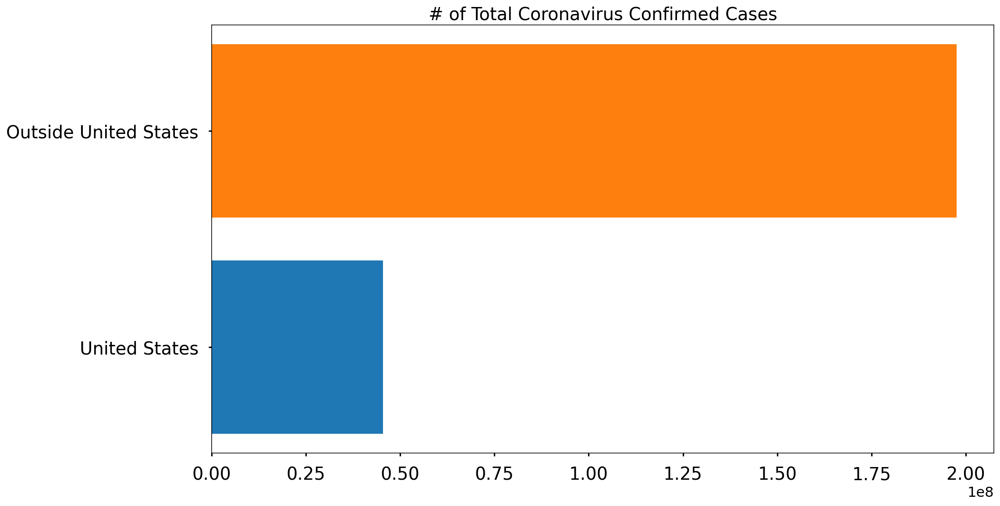

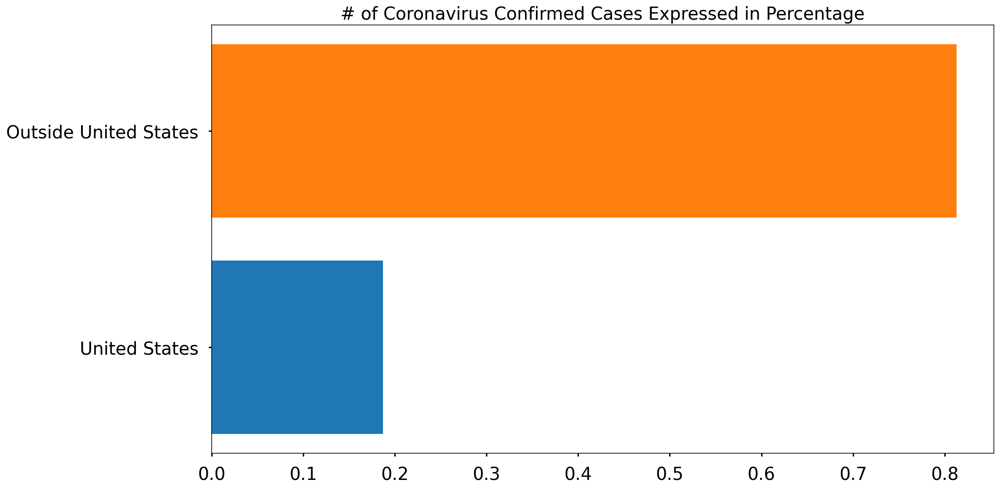

In [ ]:
total_world_cases = np.sum(country_confirmed_cases)
us_confirmed = latest_data[latest_data['Country_Region']=='US']['Confirmed'].sum()
outside_us_confirmed = total_world_cases - us_confirmed

plt.figure(figsize=(16, 9))
plt.barh('United States', us_confirmed)
plt.barh('Outside United States', outside_us_confirmed)
plt.title('# of Total Coronavirus Confirmed Cases', size=20)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()


plt.figure(figsize=(16, 9))
plt.barh('United States', us_confirmed/total_world_cases)
plt.barh('Outside United States', outside_us_confirmed/total_world_cases)
plt.title('# of Coronavirus Confirmed Cases Expressed in Percentage', size=20)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

In [ ]:
print('Outside United States {} cases ({}%):'.format(outside_us_confirmed, np.round((outside_us_confirmed/total_world_cases)*100, 1)))
print('United States {} cases ({}%)'.format(us_confirmed, np.round((us_confirmed/total_world_cases)*100, 1)))
print('Total: {} cases'.format(total_world_cases))

Outside United States 197587040 cases (81.3%):
United States 45421275 cases (18.7%)
Total: 243008315 cases


In [ ]:
# Only show 10 countries with the most confirmed cases, the rest are grouped into the other category
visual_unique_countries = [] 
visual_confirmed_cases = []
others = np.sum(country_confirmed_cases[10:])

for i in range(len(country_confirmed_cases[:10])):
    visual_unique_countries.append(unique_countries[i])
    visual_confirmed_cases.append(country_confirmed_cases[i])
    
visual_unique_countries.append('Others')
visual_confirmed_cases.append(others)

Pie Chart Visualizations for COVID-19

In [ ]:
def plot_bar_graphs(x, y, title):
    plt.figure(figsize=(16, 12))
    plt.barh(x, y)
    plt.title(title, size=20)
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()
    
# good for a lot x values 
def plot_bar_graphs_tall(x, y, title):
    plt.figure(figsize=(19, 18))
    plt.barh(x, y)
    plt.title(title, size=25)
    plt.xticks(size=25)
    plt.yticks(size=25)
    plt.show()

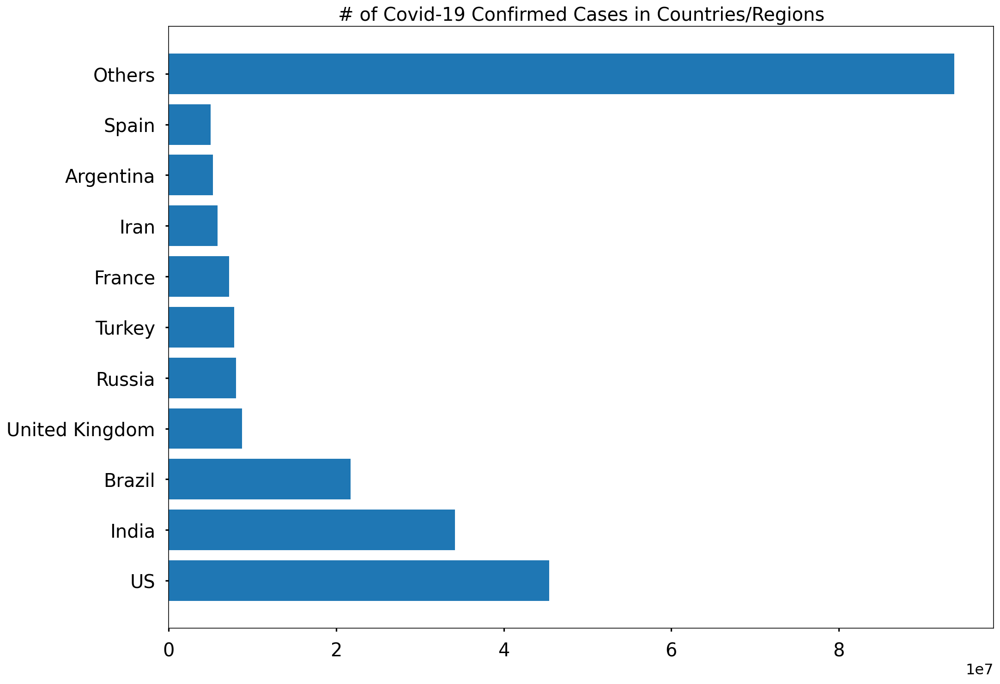

In [ ]:
plot_bar_graphs(visual_unique_countries, visual_confirmed_cases, '# of Covid-19 Confirmed Cases in Countries/Regions')

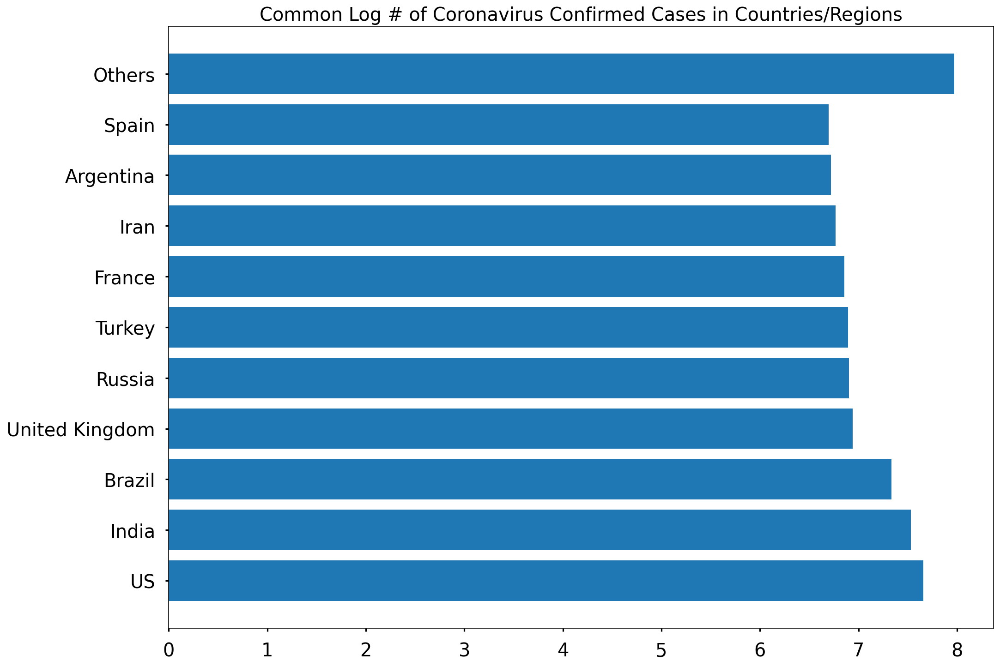

In [ ]:
log_country_confirmed_cases = [math.log10(i) for i in visual_confirmed_cases]
plot_bar_graphs(visual_unique_countries, log_country_confirmed_cases, 'Common Log # of Coronavirus Confirmed Cases in Countries/Regions')

In [ ]:
# Only show 10 provinces with the most confirmed cases, the rest are grouped into the other category
visual_unique_provinces = [] 
visual_confirmed_cases2 = []
others = np.sum(province_confirmed_cases[10:])
for i in range(len(province_confirmed_cases[:10])):
    visual_unique_provinces.append(unique_provinces[i])
    visual_confirmed_cases2.append(province_confirmed_cases[i])

visual_unique_provinces.append('Others')
visual_confirmed_cases2.append(others)

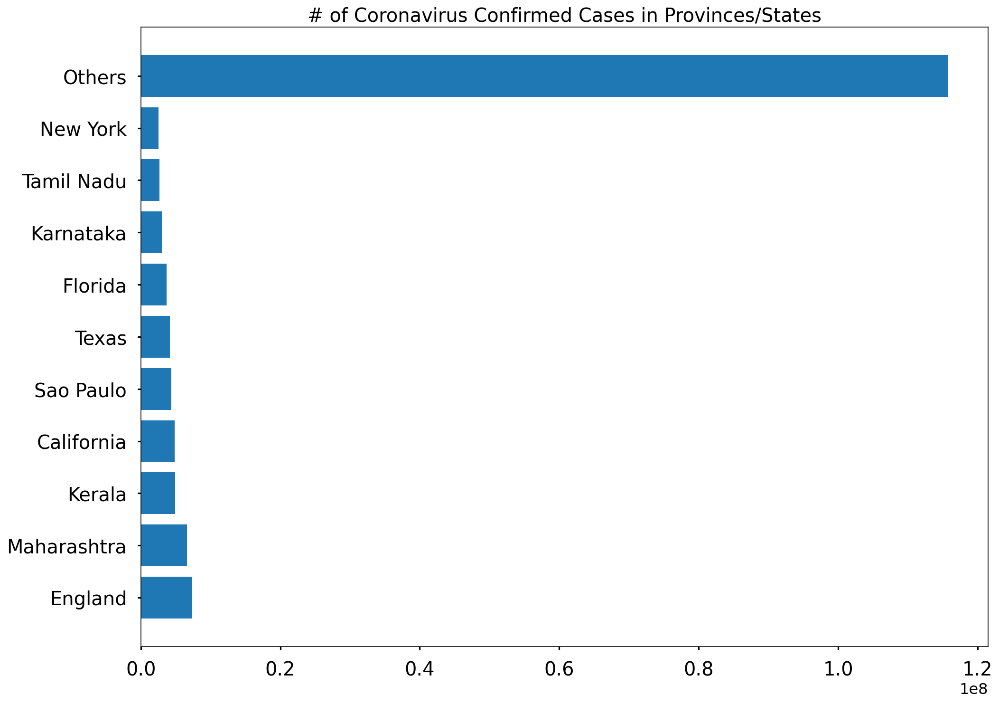

In [ ]:
plot_bar_graphs(visual_unique_provinces, visual_confirmed_cases2, '# of Coronavirus Confirmed Cases in Provinces/States')

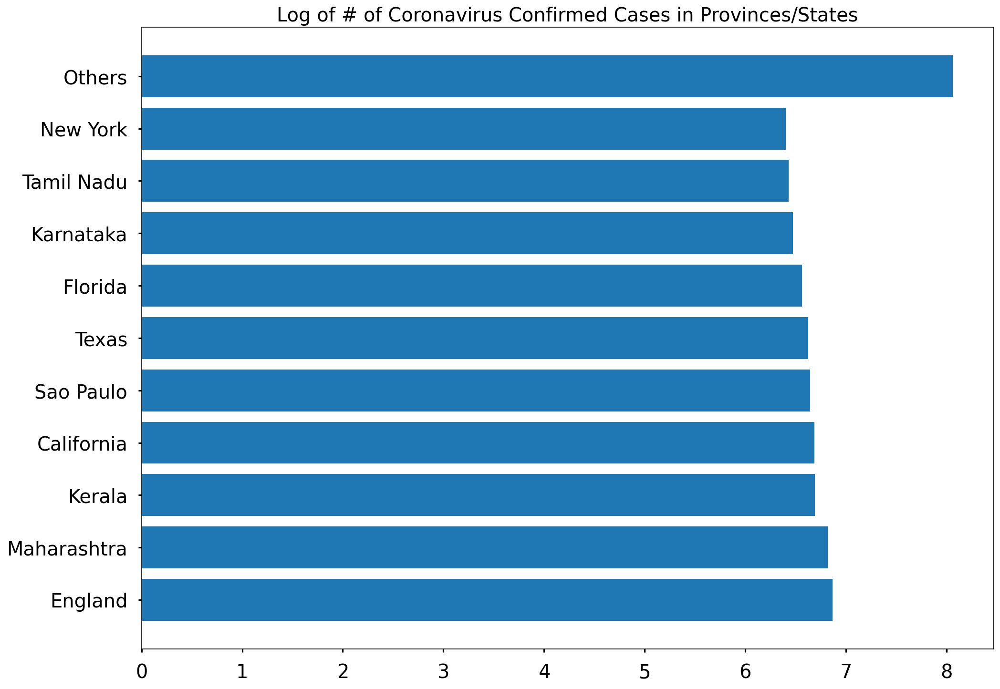

In [ ]:
log_province_confirmed_cases = [math.log10(i) for i in visual_confirmed_cases2]
plot_bar_graphs(visual_unique_provinces, log_province_confirmed_cases, 'Log of # of Coronavirus Confirmed Cases in Provinces/States')

In [ ]:
def plot_pie_charts(x, y, title):
    # more muted color 
    c = ['lightcoral', 'rosybrown', 'sandybrown', 'navajowhite', 'gold',
        'khaki', 'lightskyblue', 'turquoise', 'lightslategrey', 'thistle', 'pink']
    plt.figure(figsize=(20,15))
    plt.title(title, size=20)
    plt.pie(y, colors=c,shadow=True)
    plt.legend(x, loc='best', fontsize=12)
    plt.show()

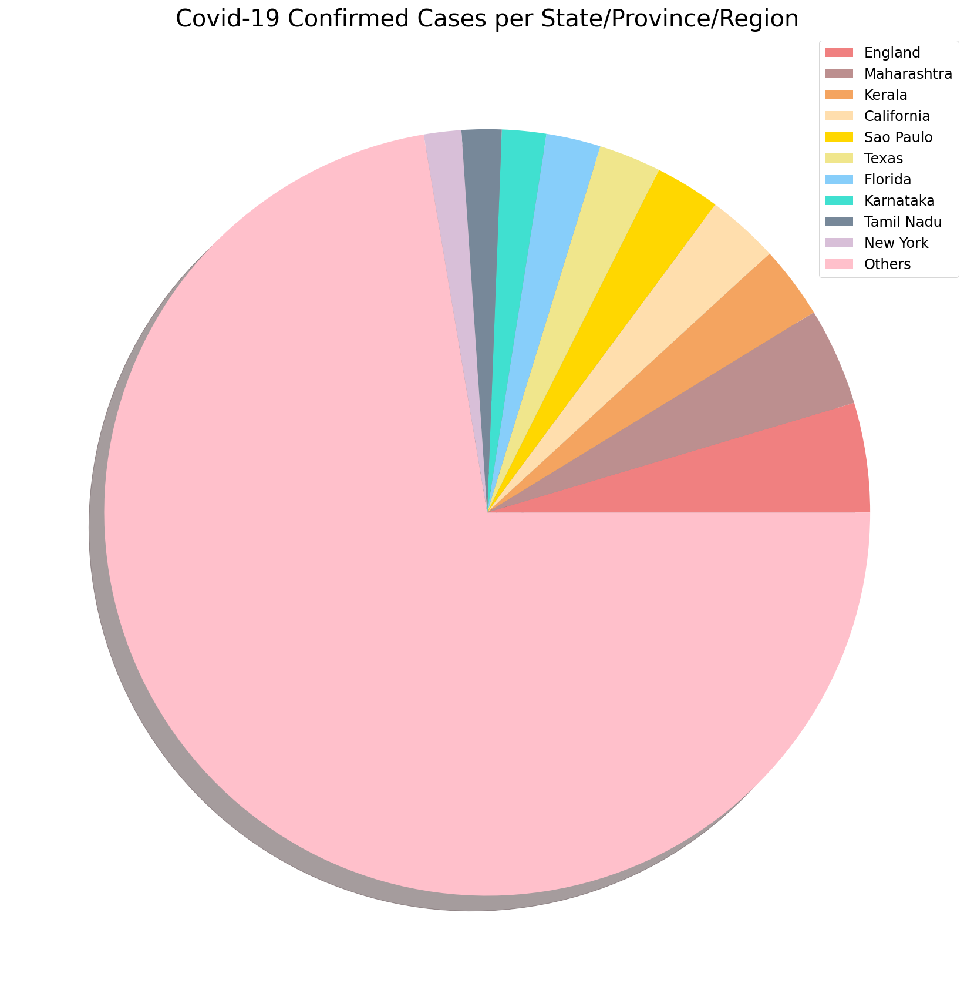

In [ ]:
plot_pie_charts(visual_unique_provinces, visual_confirmed_cases2, 'Covid-19 Confirmed Cases per State/Province/Region')

In [ ]:
# Plotting countries with regional data using a pie chart 

def plot_pie_country_with_regions(country_name, title):
    regions = list(latest_data[latest_data['Country_Region']==country_name]['Province_State'].unique())
    confirmed_cases = []
    no_cases = [] 
    for i in regions:
        cases = latest_data[latest_data['Province_State']==i]['Confirmed'].sum()
        if cases > 0:
            confirmed_cases.append(cases)
        else:
            no_cases.append(i)

    # remove areas with no confirmed cases
    for i in no_cases:
        regions.remove(i)

    # only show the top 5 states
    regions = [k for k, v in sorted(zip(regions, confirmed_cases), key=operator.itemgetter(1), reverse=True)]

    for i in range(len(regions)):
        confirmed_cases[i] = latest_data[latest_data['Province_State']==regions[i]]['Confirmed'].sum()  
    
    # additional province/state will be considered "others"
    
    if(len(regions)>5):
        regions_5 = regions[:5]
        regions_5.append('Others')
        confirmed_cases_5 = confirmed_cases[:5]
        confirmed_cases_5.append(np.sum(confirmed_cases[5:]))
        plot_pie_charts(regions_5,confirmed_cases_5, title)
    else:
        plot_pie_charts(regions,confirmed_cases, title)

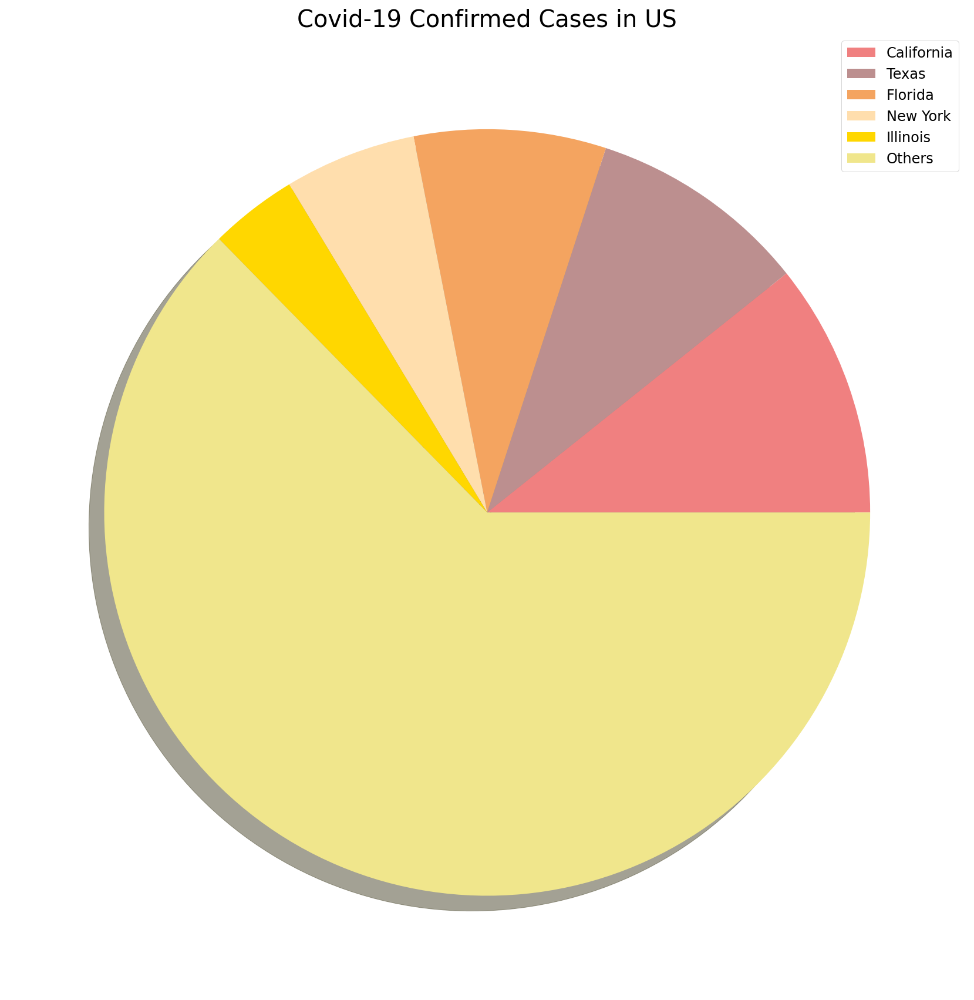

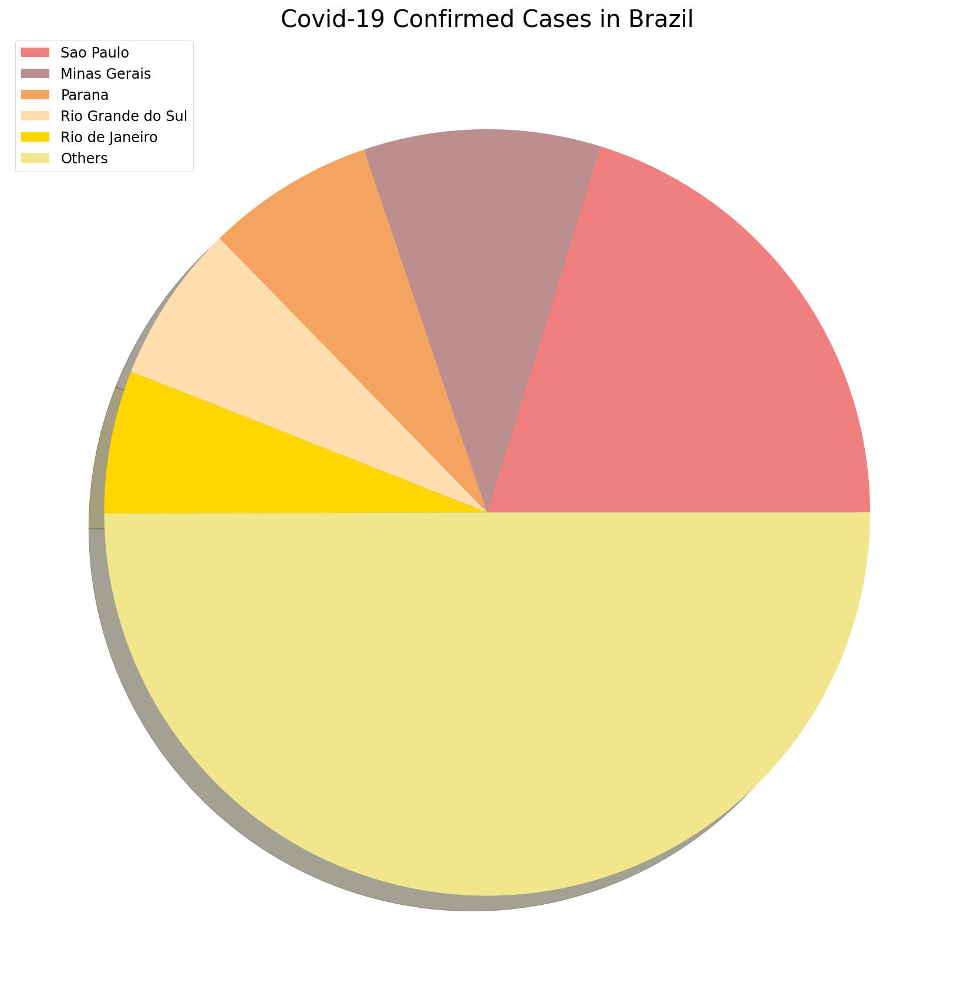

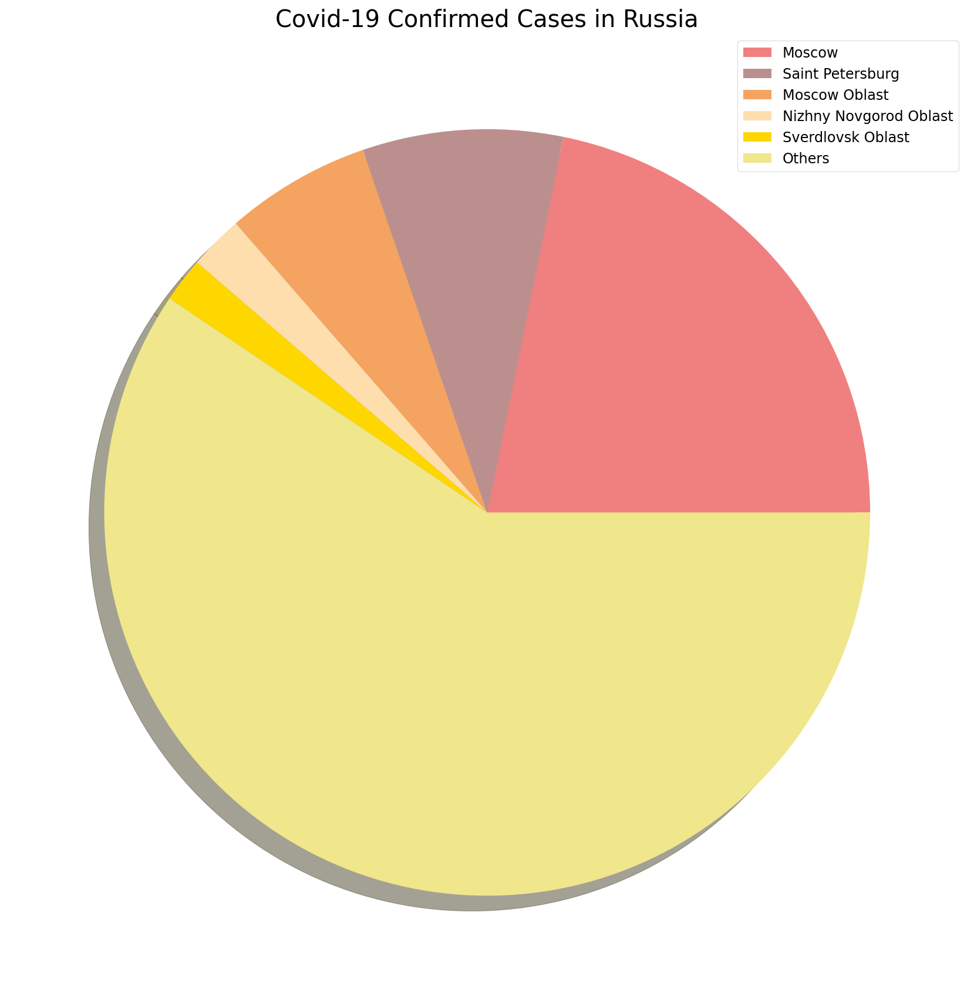

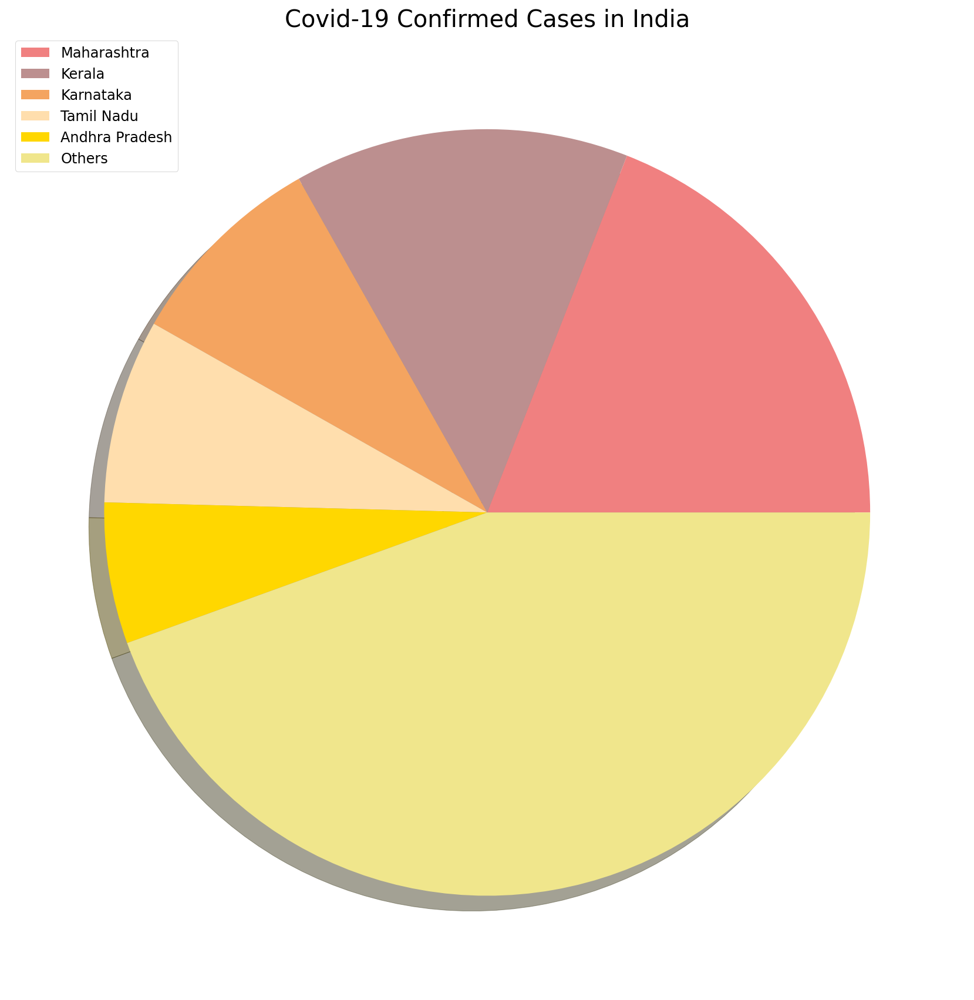

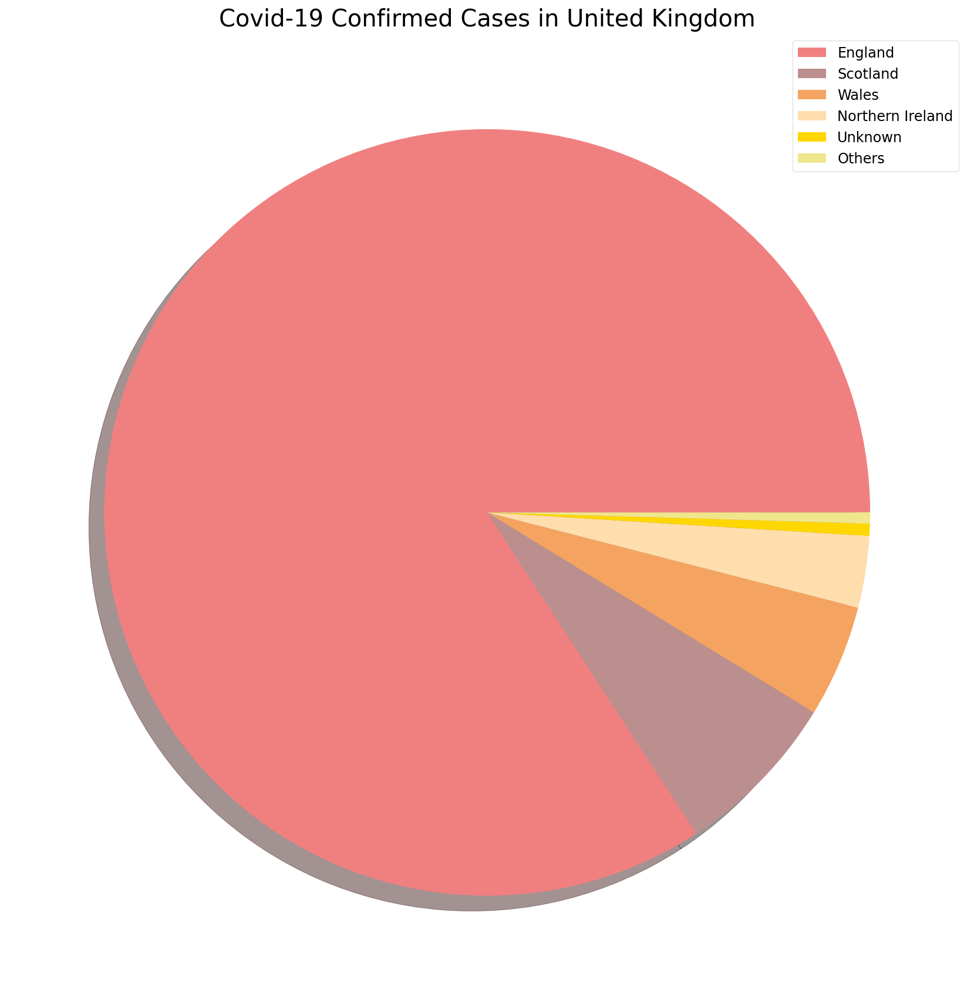

...

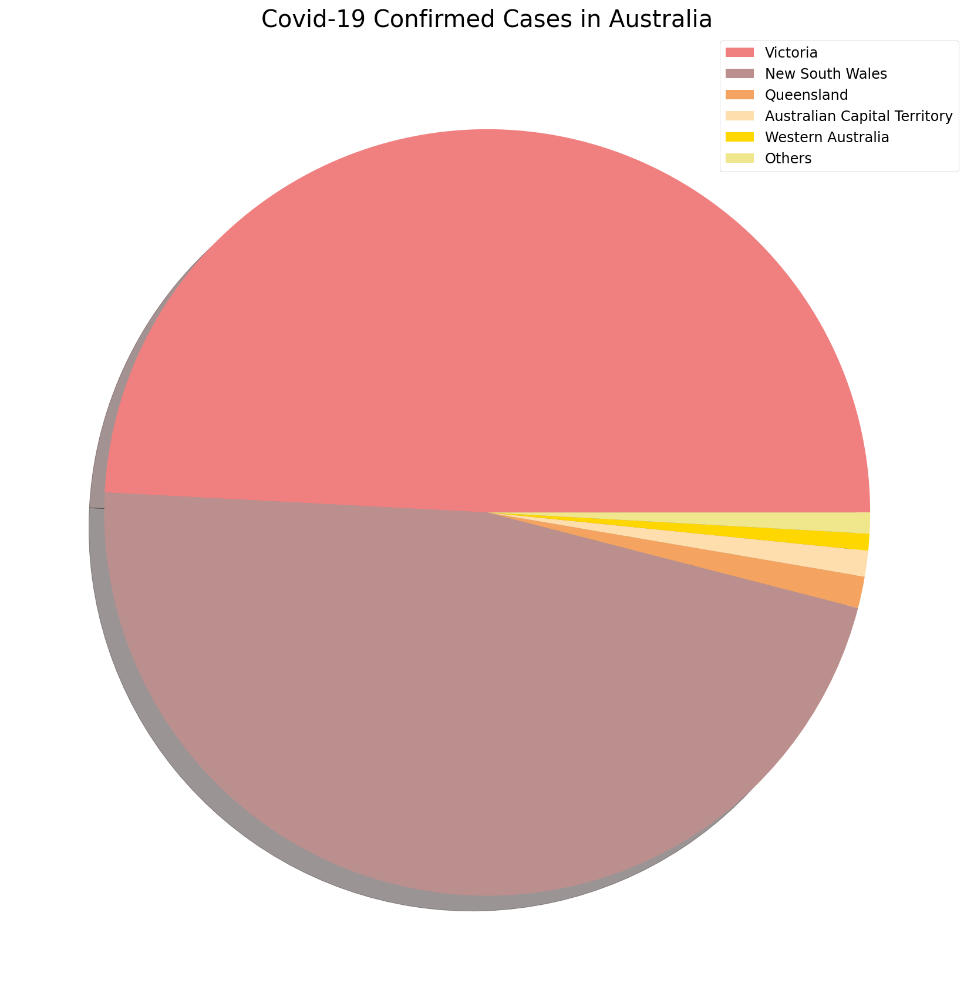

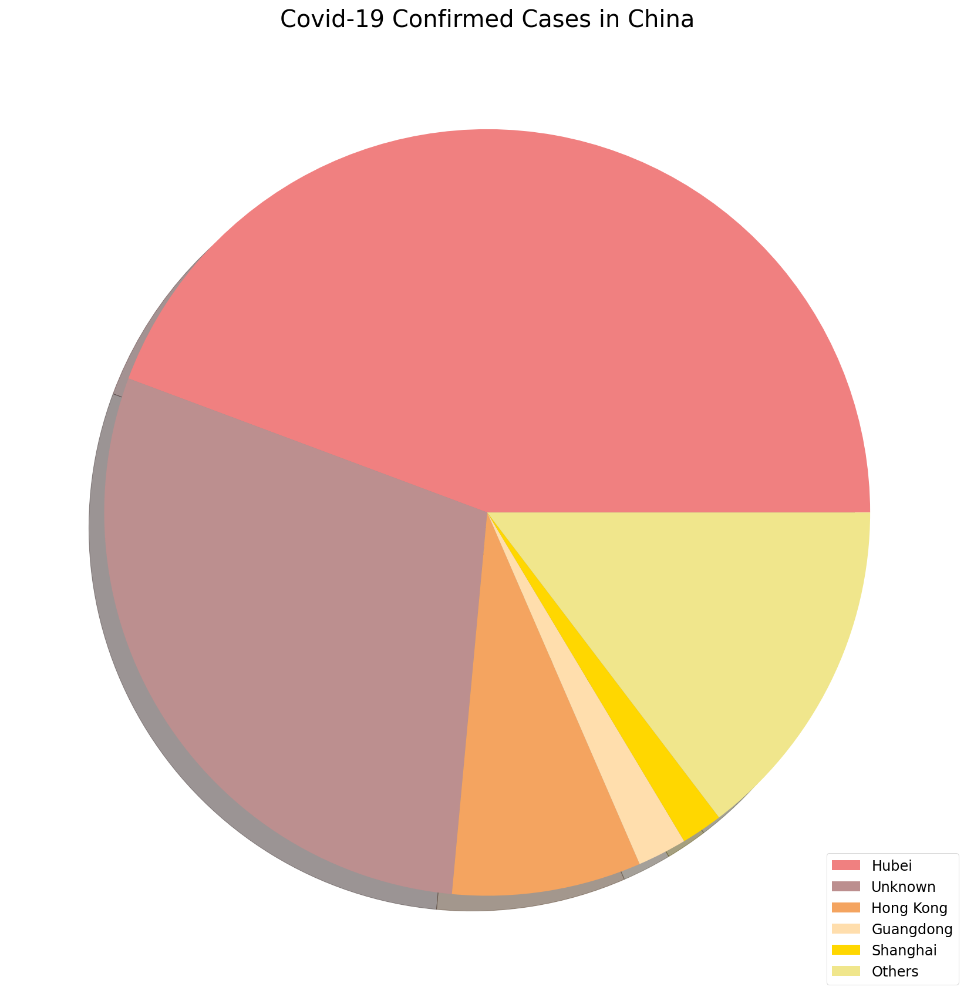

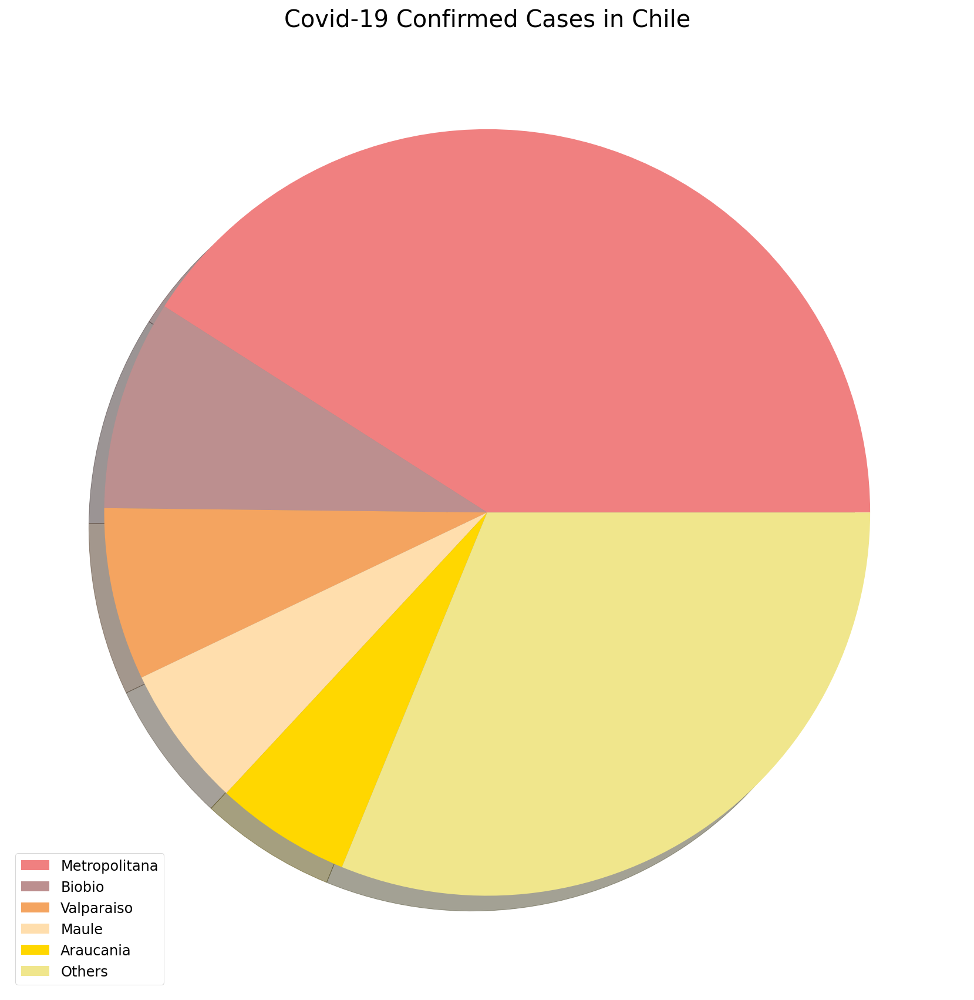

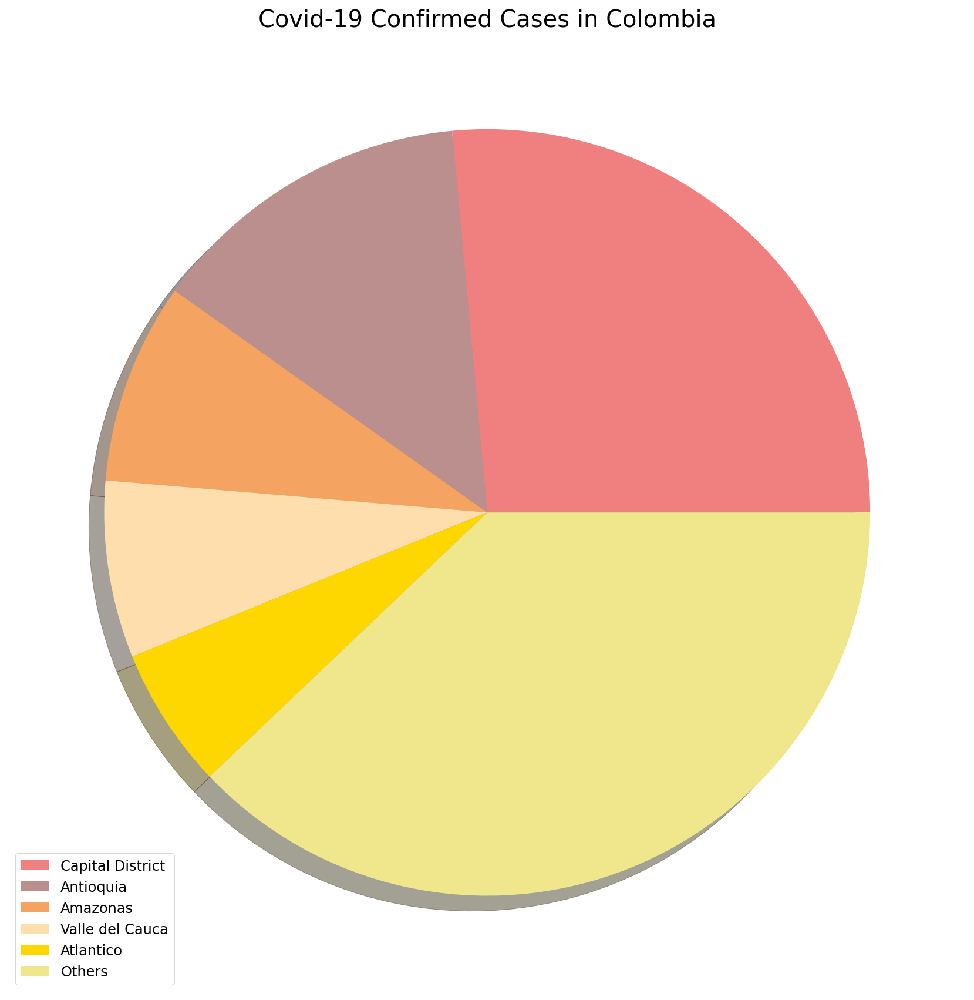

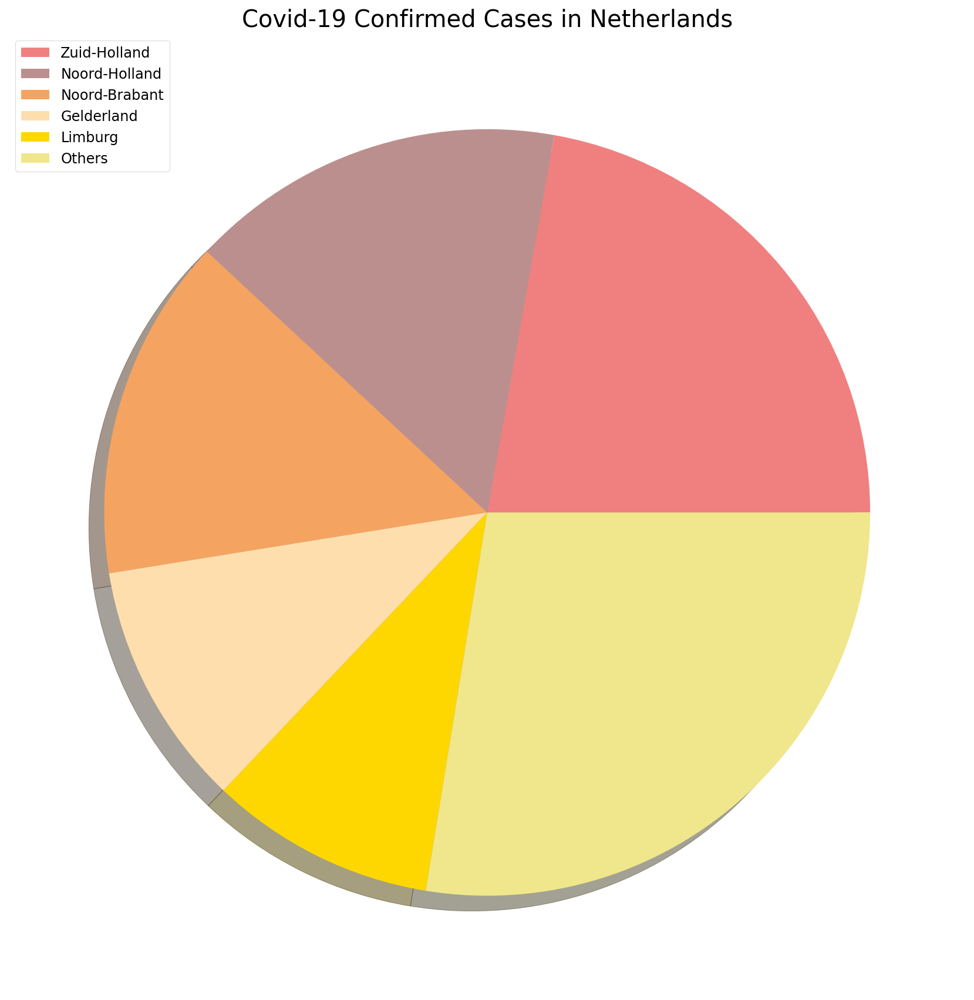

In [ ]:
pie_chart_countries = ['US', 'Brazil', 'Russia', 'India', 'United Kingdom', 'Italy', 'Germany', 'France', 'Spain', 'Peru', 'Mexico', 'Canada', 
                       'Australia', 'China', 'Chile', 'Colombia', 'Netherlands']

for i in pie_chart_countries:
    plot_pie_country_with_regions(i, 'Covid-19 Confirmed Cases in {}'.format(i))

US Medical Data on Testing

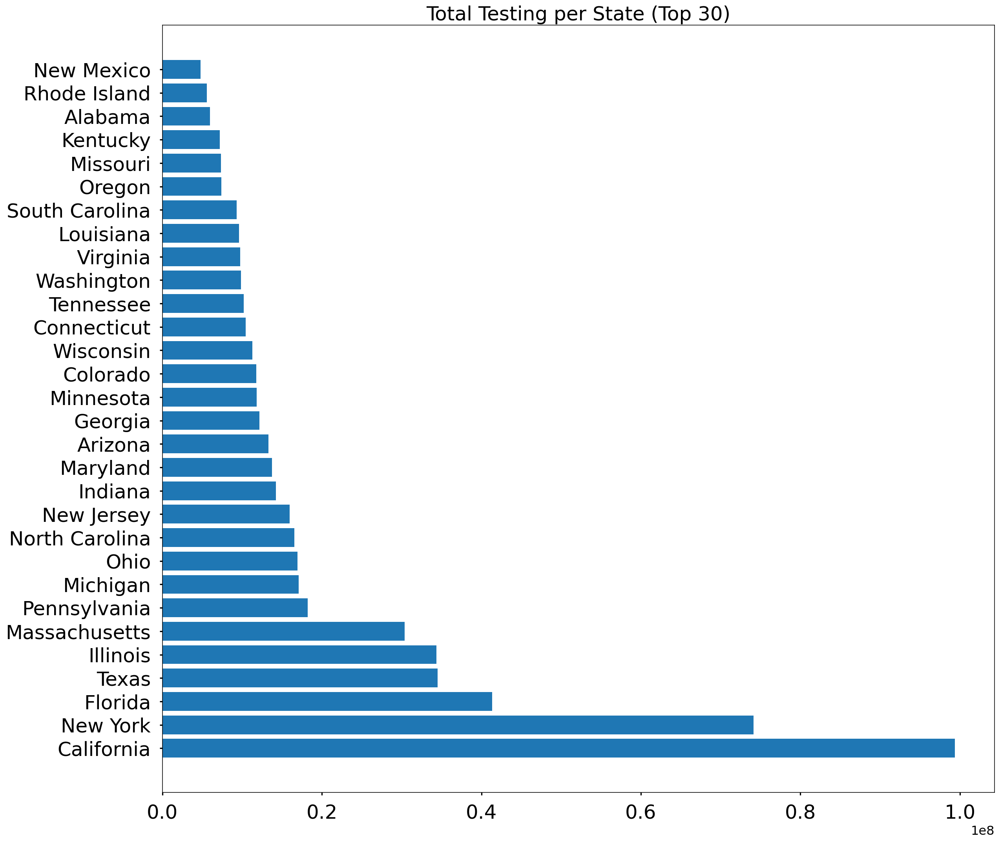

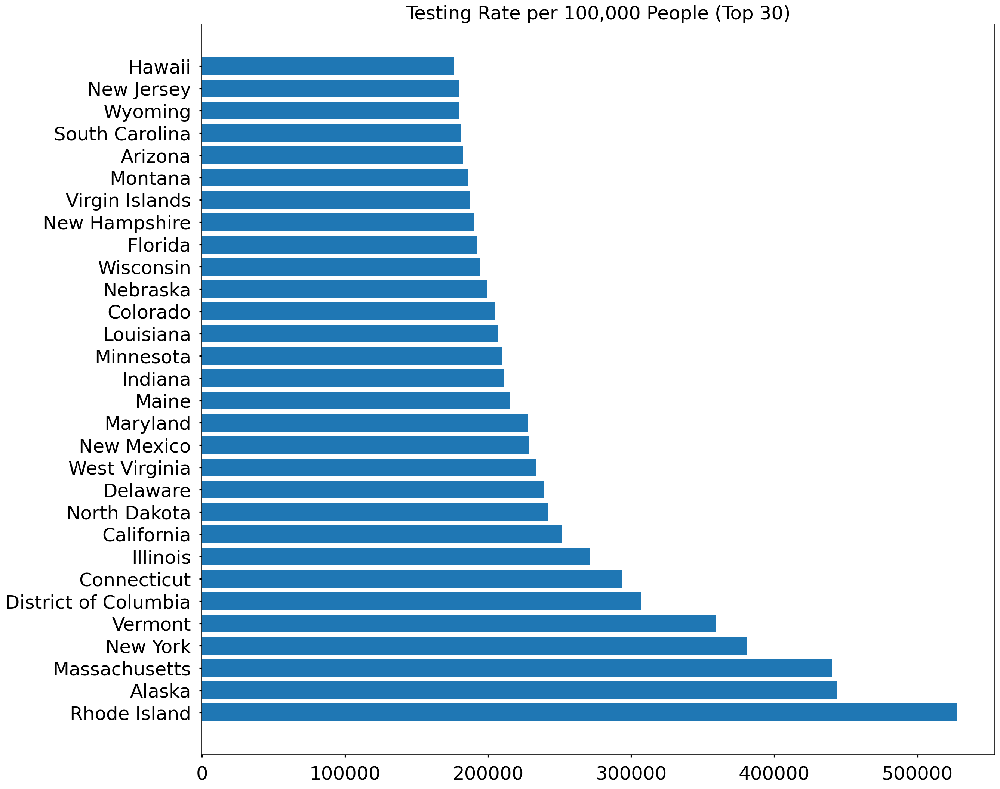

In [ ]:
# Replace nan with 0
us_medical_data.fillna(value=0, inplace=True)

def plot_us_medical_data():
    states = us_medical_data['Province_State'].unique()
    testing_number = []
    testing_rate = []
    
    for i in states:
        testing_number.append(us_medical_data[us_medical_data['Province_State']==i]['Total_Test_Results'].sum())
        testing_rate.append(us_medical_data[us_medical_data['Province_State']==i]['Testing_Rate'].max())
    
    # only show the top 15 states
    testing_states = [k for k, v in sorted(zip(states, testing_number), key=operator.itemgetter(1), reverse=True)]
    testing_rate_states = [k for k, v in sorted(zip(states, testing_rate), key=operator.itemgetter(1), reverse=True)]
  
    for i in range(len(states)):
        testing_number[i] = us_medical_data[us_medical_data['Province_State']==testing_states[i]]['Total_Test_Results'].sum()
        testing_rate[i] = us_medical_data[us_medical_data['Province_State']==testing_rate_states[i]]['Testing_Rate'].sum()
    
    top_limit = 30 
    
    plot_bar_graphs_tall(testing_states[:top_limit], testing_number[:top_limit], 'Total Testing per State (Top 30)')
    plot_bar_graphs_tall(testing_rate_states[:top_limit], testing_rate[:top_limit], 'Testing Rate per 100,000 People (Top 30)')
 

plot_us_medical_data()

Taking a look at Apple's mobility data.

It can help us understand the relationship between mobility and daily increases in coronavirus cases. The graphs below show the data for U.S. states and territories.

In [ ]:
def get_mobility_by_state(transport_type, state, day):
    return apple_mobility[apple_mobility['sub-region']==state][apple_mobility['transportation_type']==transport_type].sum()[day]

In [ ]:
apple_mobility.head()

,geo_type,region,transportation_type,alternative_name,sub-region,country,2020-01-13,2020-01-14,2020-01-15,2020-01-16,2020-01-17,2020-01-18,2020-01-19,2020-01-20,2020-01-21,2020-01-22,2020-01-23,2020-01-24,2020-01-25,2020-01-26,2020-01-27,2020-01-28,2020-01-29,2020-01-30,2020-01-31,2020-02-01,2020-02-02,2020-02-03,2020-02-04,2020-02-05,2020-02-06,2020-02-07,2020-02-08,2020-02-09,2020-02-10,2020-02-11,2020-02-12,2020-02-13,2020-02-14,2020-02-15,...,2021-09-13,2021-09-14,2021-09-15,2021-09-16,2021-09-17,2021-09-18,2021-09-19,2021-09-20,2021-09-21,2021-09-22,2021-09-23,2021-09-24,2021-09-25,2021-09-26,2021-09-27,2021-09-28,2021-09-29,2021-09-30,2021-10-01,2021-10-02,2021-10-03,2021-10-04,2021-10-05,2021-10-06,2021-10-07,2021-10-08,2021-10-09,2021-10-10,2021-10-11,2021-10-12,2021-10-13,2021-10-14,2021-10-15,2021-10-16,2021-10-17,2021-10-18,2021-10-19,2021-10-20,2021-10-21,2021-10-22
0,country/region,Albania,driving,NaN,NaN,NaN,100,95,101,97,104,113,105,94,94,94,93,102,102,101,95,89,90,90,98,102,109,93,91,94,97,102,103,108,88,94,95,100,139,124,...,199,186,182,184,185,189,188,185,181,176,171,183,202,197,165,169,165,166,174,198,197,150,155,157,156,162,171,171,162,167,155,155,178,204,236,205,187,183,176,172
1,country/region,Albania,walking,NaN,NaN,NaN,100,101,99,98,101,100,82,96,98,95,94,94,97,77,83,83,84,88,91,89,79,87,88,99,86,95,100,81,90,90,94,96,109,108,...,284,246,254,243,236,227,195,262,243,233,232,233,220,203,251,261,227,232,243,241,209,223,230,228,216,235,223,189,229,265,210,226,241,290,363,426,378,343,323,278
2,country/region,Argentina,driving,NaN,NaN,NaN,100,97,102,111,118,124,95,95,95,98,99,113,118,91,93,91,92,97,111,124,89,92,89,94,96,111,122,89,96,97,102,105,123,128,...,70,77,81,86,119,143,84,83,92,86,94,126,146,93,76,78,85,86,120,135,79,70,85,94,133,148,158,126,102,85,87,98,124,138,76,79,83,90,94,119
3,country/region,Argentina,walking,NaN,NaN,NaN,100,95,101,113,117,114,85,101,106,105,103,105,99,74,94,94,92,96,99,97,67,95,96,100,99,105,106,73,104,106,111,113,129,103,...,66,75,78,84,104,111,60,80,89,77,86,112,116,65,67,73,79,72,105,111,58,68,79,86,108,118,137,98,63,77,80,90,112,111,51,76,79,85,87,100
4,country/region,Australia,driving,AU,NaN,NaN,100,103,104,109,109,89,99,104,107,107,116,110,89,85,96,99,100,103,104,86,93,96,99,102,107,107,86,99,100,103,106,117,115,94,...,83,87,89,96,90,74,87,89,91,94,97,90,74,88,93,92,93,97,90,77,77,90,95,96,102,96,75,90,93,96,97,104,100,85,95,98,102,103,114,112


In [ ]:
# sample testing 
get_mobility_by_state('walking', 'Connecticut', '2020-07-30')

1104.74

In [ ]:
# revising date to fit with the mobility format 
revised_dates = []
for i in range(len(dates)):
    revised_dates.append(datetime.datetime.strptime(dates[i], '%m/%d/%y').strftime('%Y-%m-%d'))

In [ ]:
# returns true if it is a weekend, and false if it is a weekday 
def weekday_or_weekend(date):
    date_obj = datetime.datetime.strptime(date, '%Y-%m-%d')
    day_of_the_week =  date_obj.weekday()
    if (day_of_the_week+1) % 6 == 0 or (day_of_the_week+1) % 7 == 0:
        return True 
    else:
        return False 
        revised_day_since_1_22 = [i for i in range(len(revised_dates))]

In [ ]:
revised_day_since_1_22 = [i for i in range(len(revised_dates))]

In [ ]:
import matplotlib.dates as mdates
states = ['New York', 'Connecticut', 'Florida', 'California', 'Texas', 'Georgia', 'Arizona', 'Illinois', 'Louisiana', 'Ohio',
          'Tennessee', 'North Carolina', 'South Carolina', 'Alabama', 'Missouri', 'Kansas', 'Pennsylvania', 'Wisconsin', 'Virginia', 'Massachusetts', 'Utah', 'Minnesota',
         'Oklahoma', 'Iowa', 'Arkansas', 'Kentucky', 'Puerto Rico', 'Colorado', 'Idaho', 'New Jersey', 'Nevada', 'Maryland', 'Indiana', 'Washington', 'Montana', 'Rhode Island',
         'New Mexico', 'Oregon', 'Vermont', 'North Dakota', 'New Hampshire']
states.sort()

# making sure the dates are in sync 
mobility_latest_date = apple_mobility.columns[-1]
mobility_latest_index = revised_dates.index(mobility_latest_date)

for state in states:
    # weekend and weekday mobility are separated 
    weekday_mobility = []
    weekday_mobility_dates = [] 
    weekend_mobility = [] 
    weekend_mobility_dates = [] 
    
    for i in range(len(revised_dates)):
        if i <= mobility_latest_index:
            if weekday_or_weekend(revised_dates[i]):
                weekend_mobility.append(get_mobility_by_state('walking', state, revised_dates[i]))
                weekend_mobility_dates.append(i)
            else:
                weekday_mobility.append(get_mobility_by_state('walking', state, revised_dates[i]))
                weekday_mobility_dates.append(i)
        else:
            pass
        
    # remove null values (they are counted as 0)
    for i in range(len(weekend_mobility)):       
        if weekend_mobility[i] == 0 and i != 0:
            weekend_mobility[i] = weekend_mobility[i-1]
        elif weekend_mobility[i] == 0 and i == 0:
            weekend_mobility[i] = weekend_mobility[i+1]
        else:
            pass
        
    for i in range(len(weekday_mobility)):       
        if weekday_mobility[i] == 0 and i != 0:
            weekday_mobility[i] = weekday_mobility[i-1]
        elif weekday_mobility[i] == 0 and i == 0:
            weekday_mobility[i] = weekday_mobility[i+1]
        else:
            pass
    
    
    weekday_mobility_average = moving_average(weekday_mobility, 7)
    weekend_mobility_average = moving_average(weekend_mobility, 7)
    
    plt.figure(figsize=(16, 10))
    plt.bar(weekday_mobility_dates, weekday_mobility, color='cornflowerblue')
    plt.plot(weekday_mobility_dates, weekday_mobility_average, color='green')
    
    plt.bar(weekend_mobility_dates, weekend_mobility, color='salmon')
    plt.plot(weekend_mobility_dates, weekend_mobility_average, color='black')
    
    plt.legend(['Moving average (7 days) weekday mobility', 'Moving Average (7 days) weekend mobility', 'Weekday mobility', 'Weekend mobility'], prop={'size': 18})
    plt.title('{} Walking Mobility Data'.format(state), size=25)
    plt.xlabel('Days since 1/22', size=25)
    plt.ylabel('Mobility Value', size=25)
    plt.xticks(size=25)
    plt.yticks(size=25)
    plt.show()